# Standard Simulation #

In [3]:
folderPath="/home/andry/Andrea/repo/PlaSim-analysis/NSM2_100_70_30_ML_SI_T21"
file_analysis=folderPath+"/output/analisi/"
file_graph=folderPath+"/output/analisi/grafici/"

In [1]:
%run ./module_study_file.ipynb

from matplotlib.colors import ListedColormap
import matplotlib.patches as patches

In [2]:
var_dic={
    "as" :["Albedo", "Reflectivity [%]", "%",100],
    "clh" :["High Level Cloud", "Cover [%]", "%",100],
    "clm" :["Medium Level Cloud", "Cover [%]", "%",100],
    "cll" :["Low Level Cloud", "Cover [%]", "%",100],
    "clt" :["Total Cloud Cover", "Cover [%]", "%",100],
    "evap" :["Evaporation","Evaporation [mm day^-1]","mm day^-1",86400000],
    "glac" :["Glacier Cover","Cover [%]", "%",100],
    "hfls" :["Surface Latent Heat Flux","Flux [W m^-2]","W m^-2",1],
    "hfss" :["Surface Sensible Heat Flux", "Flux [W m^-2]","W m^-2",1],
    "hus"   : ["Specific Humidity", "[g Kg^-1]", "g Kg^-1",1000], #lev
    "icec": ["Sea Ice Cover","Cover [%]", "%",100],
    "mrro" :["Surface Runoff", "[mm day^-1]", "mm day^-1",86400000],
    "mrso"  :["Soil Wetness", "[m]", "m",1],
    "pl"    : ["Log Surface Pressure", "Pressure [Pa]", "Pa",1],
    "prsn"  : ["Snow Fall","Flux [W m^-2]","W m^-2", 1000*334000],
    "prt"  :["Total Precipitation", "Precipitation [mm day^-1]", "mm day^-1",86400000],
    "ps"    : ["Surface Pressure", "Pressure [Pa]", "hPa",0.01],
    "rls" :["Surface Thermal Radiation", "[W m^-2]","W m^-2",1],
    "rlut" :["Top Thermal Radiation", "[W m^-2]","W m^-2",1],
    "rss" :["Surface Solar Radiation", "[W m^-2]","W m^-2",1],
    "rst" :["Top Solar Radation", "[W m^-2]","W m^-2",1],
    "rsut":["Top Solar Radiation Upward","[W m^-2]","W m^-2",1],
    "sg"  : ["Surface Geopotential Orography", "Geopotential [m^2/s^2]", "m^2/s^2",1],
    "sit":["Sea Ice Thickness", "[m]","m",1],
    "snd" : ["Snow Depth", "Depth [m]", "m",1],
    "snm" : ["Snow Melt", "[mm day^-1]", "mm day^-1",86400000],
    "ssru":["Surface Solar Radiation Upward","[W m^-2]","W m^-2",1],
    "sst"  : ["Sea Surface Temperature","T [°C]", "°C",1],
    "stru":["Surface Thermal Radiation Upward","[W m^-2]","W m^-2",1],
    "ta"    : ["Temperature", "T [°C]", "°C",1], #lev
    "tas" : ["2m Surface Temperature", "T [°C]", "°C",1],
    "ts"  : ["Surface Temperature","T [°C]", "°C",1],
    "tso":["Soil Temperature","T [°C]", "°C",1],
    "tsod":["Deep Soil Temperature","T [°C]", "°C",1],
    "RTOA" : ["TOA Energy Balance", "[W m^-2]","W m^-2",1], #2
    "RSUP" :["SUP Energy Balance", "[W m^-2]","W m^-2",1], #2
    "P-E" : ["precipitation-Evaporaration","[mm day^-1]","mm day^-1",86400000],
    "u" : ["Wind Speed","[m s^-1]","m s^-1", 1]
    }

In [4]:
press=[1000,850,700,500,400,300,250,200,150,100,70,50,30]
str_press=["1000","850","700","500","400","300","250","200","150","100","70","50","30"]
mesi=["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct","Nov","Dec"]
r_eq=6371000

name_simulation=folderPath.split("/")[-1].split("_")[0]
tm=int(folderPath.split("/")[-1].split("_")[1])
strt=int(folderPath.split("/")[-1].split("_")[2])
stp=int(folderPath.split("/")[-1].split("_")[3])

#lev=press.index(int(cmblevel.get()))
#prendo le variabili lat e long da un qualsiasi file netcdf
file_nc=Dataset(folderPath+"/output/"+name_simulation+"_PLA.0001.nc")
lats=file_nc.variables["lat"]
lons=file_nc.variables["lon"]

lats_inv=lats
lats_inv=np.insert(lats_inv,0,90)
lats_inv=np.append(lats_inv,-90)
delta_lat=np.zeros(len(lats_inv)-1)
for i in range(1,len(lats_inv)):

    delta_lat[i-1]=lats_inv[i]-lats_inv[i-1]

In [5]:
simulation=[name_simulation,tm,strt,stp,lats,mesi,lons,delta_lat,lats_inv,folderPath]

In [6]:
step=15

# File Input #

In [7]:
if "T21" in folderPath:
    a="32"
    b="64"
else:
    a="64"
    b="128"
_,data210=read_file(folderPath,"/N0"+a+"_surf_0210.sra")
data210_reshape=np.reshape(data210[:int(int(a)*int(b)/8)],[int(a),int(b)])
_,data172=read_file(folderPath,"/N0"+a+"_surf_0172.sra")
data172_reshape=np.reshape(data172[:int(int(a)*int(b)/8)],[int(a),int(b)])
_,data174=read_file(folderPath,"/N0"+a+"_surf_0174.sra")
data174_reshape=np.reshape(data174[:int(int(a)*int(b)/4)],[int(a),int(b)])
_,data232=read_file(folderPath,"/N0"+a+"_surf_0232.sra")
data232_reshape=np.reshape(data232[:int(int(a)*int(b)/4)],[int(a),int(b)])
_,data129=read_file(folderPath,"/N0"+a+"_surf_0129.sra")
data129_reshape=np.reshape(data129[:int(int(a)*int(b)/4)],[int(a),int(b)])
_,data229=read_file(folderPath,"/N0"+a+"_surf_0229.sra")
data229_reshape=np.reshape(tuple(data229[:int(int(a)*int(b)/4)]),[int(a),int(b)])

In [8]:
help(graph_globe)

Help on function graph_globe in module __main__:

graph_globe(data, lons, lats, save, title, cbar_title, vmn, vmx, step_bar, name_run, path, contourf, fm, cmp=<matplotlib.colors.LinearSegmentedColormap object at 0x7fed20b0c950>, cost=1)



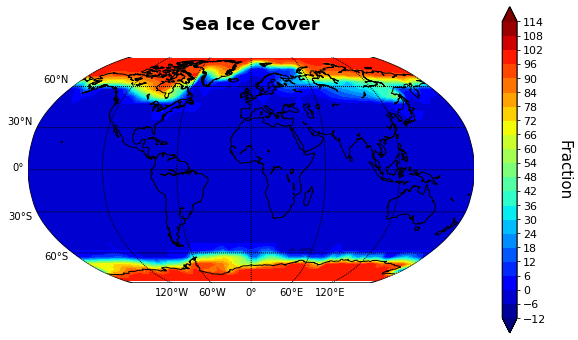

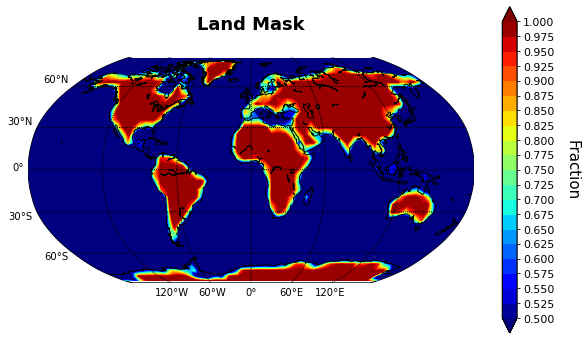

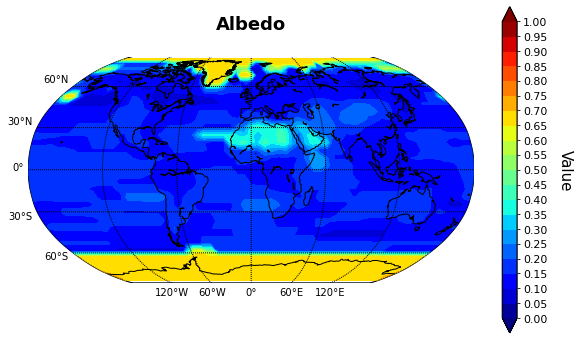

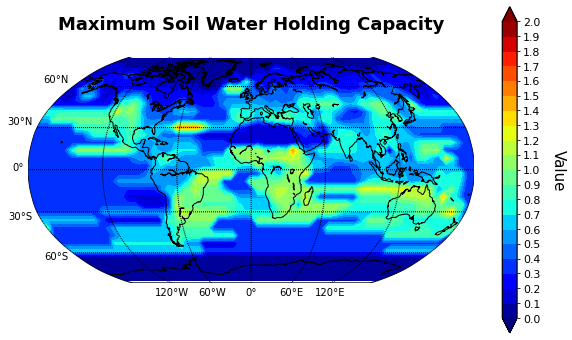

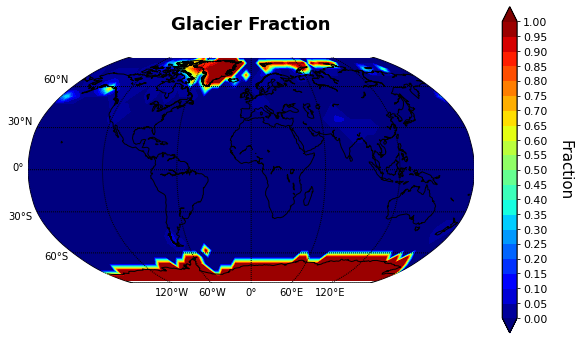

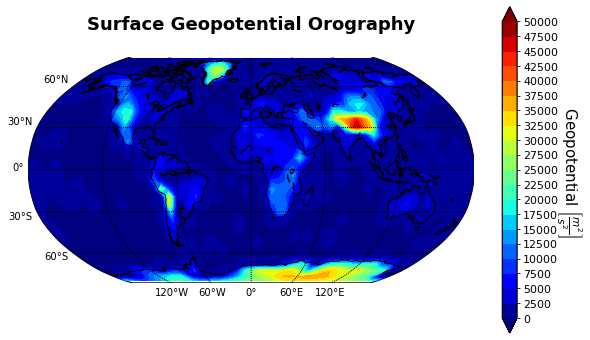

In [9]:
graph_globe(data210_reshape,lons,lats,False,"Sea Ice Cover","Fraction",-10,110,21,simulation[0],folderPath+"/output/analisi/grafici/",True,"%1.1f")
graph_globe(data172_reshape,lons,lats,False,"Land Mask","Fraction",0.50001,1,21,simulation[0],folderPath+"/output/analisi/grafici/",True,"%1.1f")
graph_globe(data174_reshape,lons,lats,False,"Albedo","Value",0,1,21,simulation[0],folderPath+"/output/analisi/grafici/",True,"%1.1f")
graph_globe(data229_reshape,lons,lats,False,"Maximum Soil Water Holding Capacity","Value",0,2,21,simulation[0],folderPath+"/output/analisi/grafici/",True,"%1.1f")
graph_globe(data232_reshape,lons,lats,False,"Glacier Fraction","Fraction",0,1,21,simulation[0],folderPath+"/output/analisi/grafici/",True,"%1.1f")
graph_globe(data129_reshape,lons,lats,False,"Surface Geopotential Orography",r" Geopotential $\left[\frac{m^2}{s^2}\right]$",0,50000,21,simulation[0],folderPath+"/output/analisi/grafici/",True,"%1.1f")

# AS #

Mean 70-100: 15.25577 dev.std: 0.0118 %
Global Mean: 15.257 %
Mean over Land with 0.5 as threshold: 27.692 % 
Mean over Ocean with 0.5 as threshold: 10.216 %
Mean over Antarctica with 0.5 as threshold: 79.146 %
Land part 382.13311, Ocean Part 942.63316


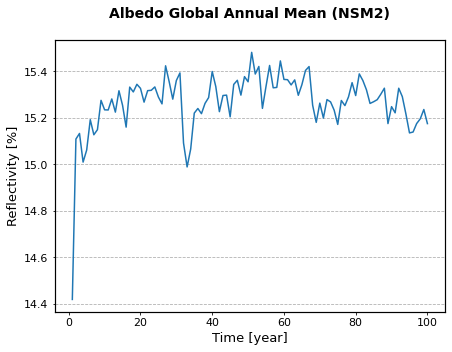

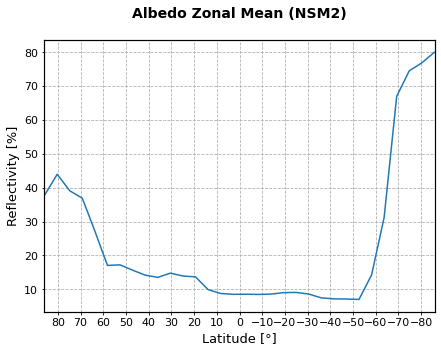

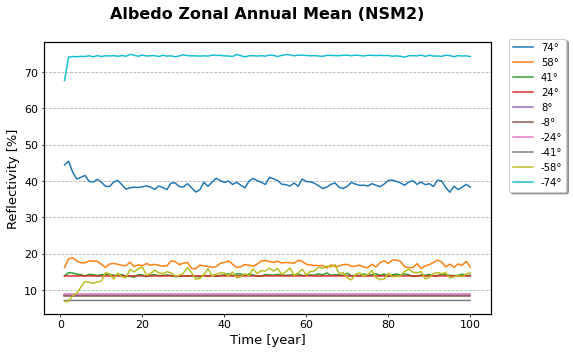

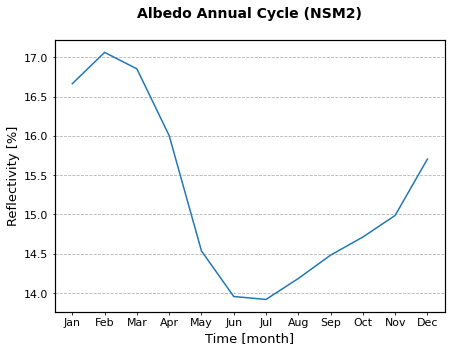

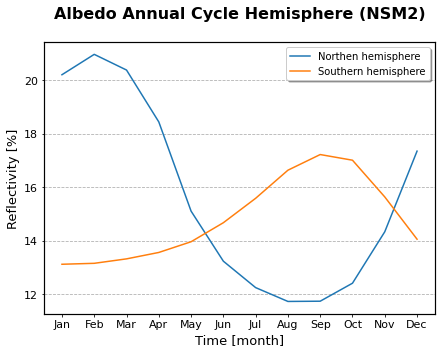

...

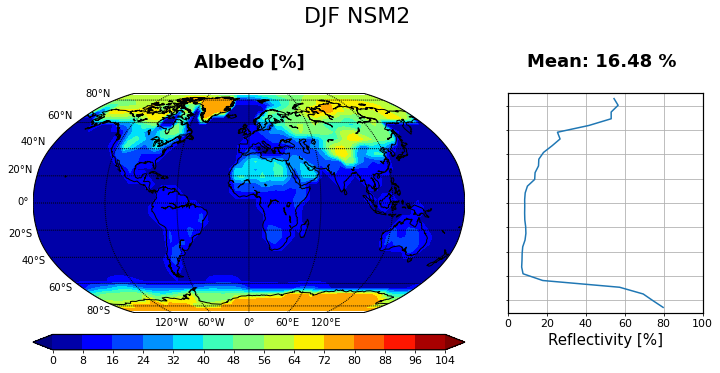

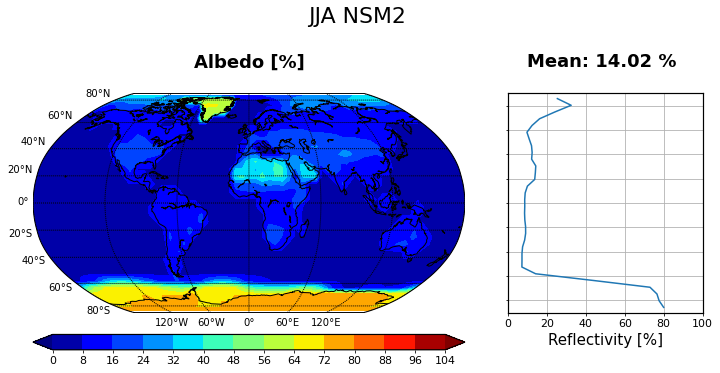

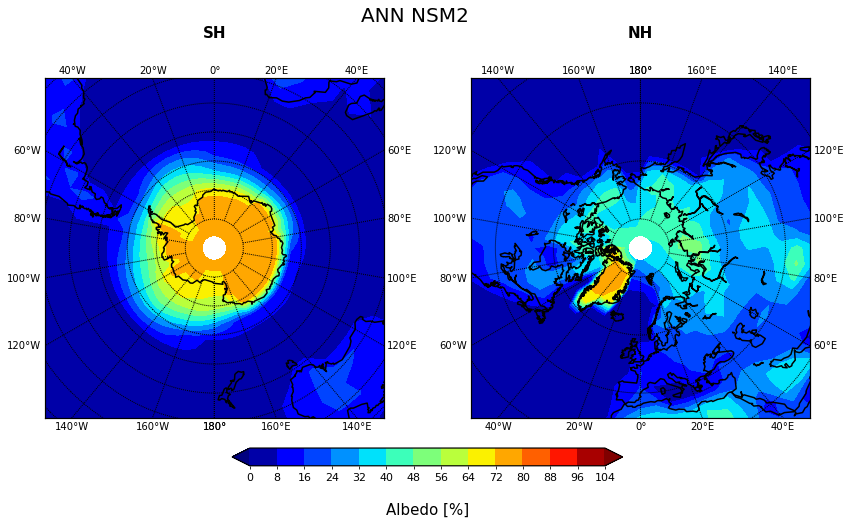

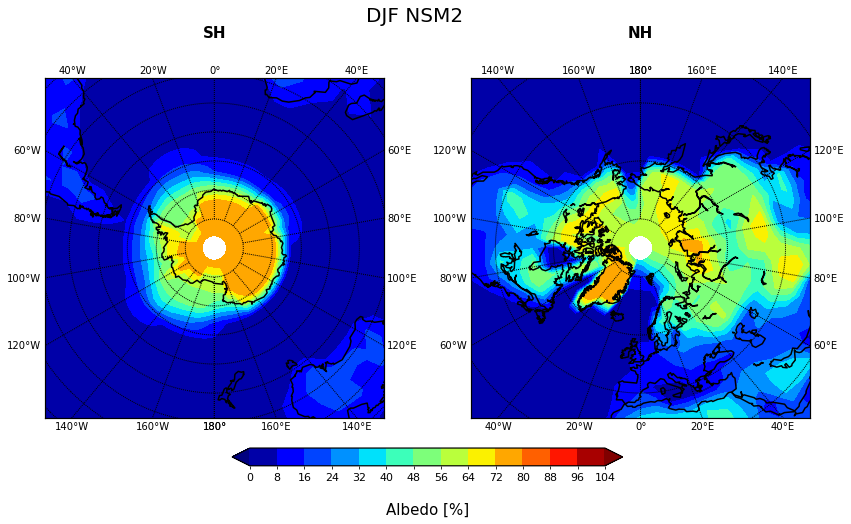

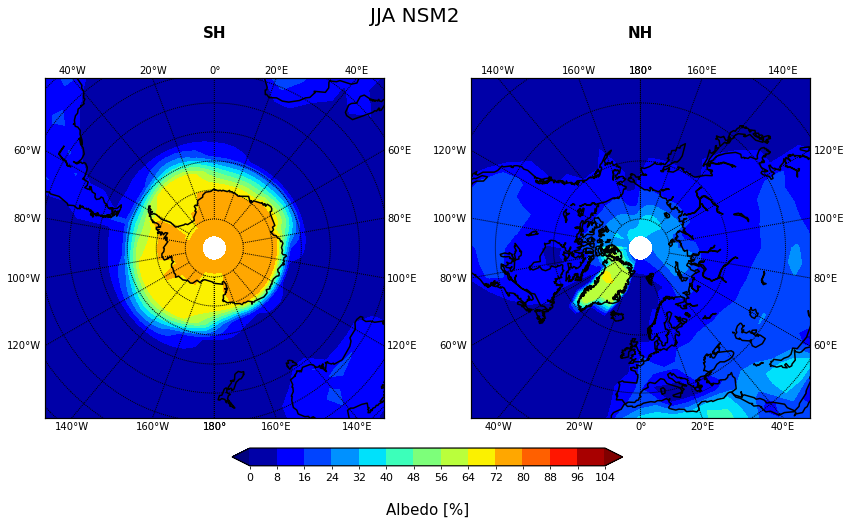

In [10]:
var="as"
alb=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=0,vmx=100,save=True)

alb_annual=alb.global_annual_mean()

alb_zonal=alb.zonal_mean()

alb_zonal_annual=alb.zonal_annual_mean()

alb_annual_cycle=alb.annual_cycle()

alb.annual_cycle_hemisphere()

alb_global=alb.global_vision()

alb.global_and_zonal()

alb.polar()

# CLH #

Mean 70-100: 7.29492 dev.std: 0.00887 %
Global Mean: 7.297 %
Mean over Land with 0.5 as threshold: 7.109 % 
Mean over Ocean with 0.5 as threshold: 7.373 %
Mean over Antarctica with 0.5 as threshold: 2.421 %
Land part 382.13311, Ocean Part 942.63316


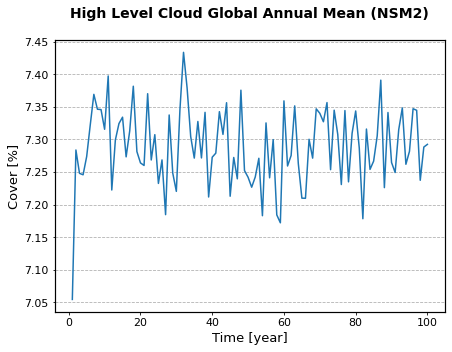

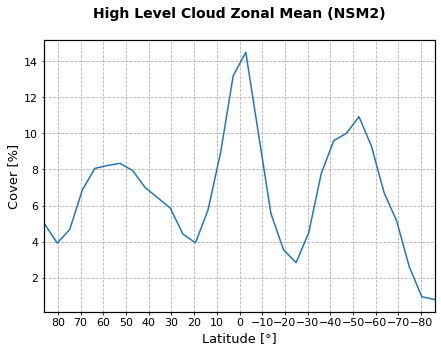

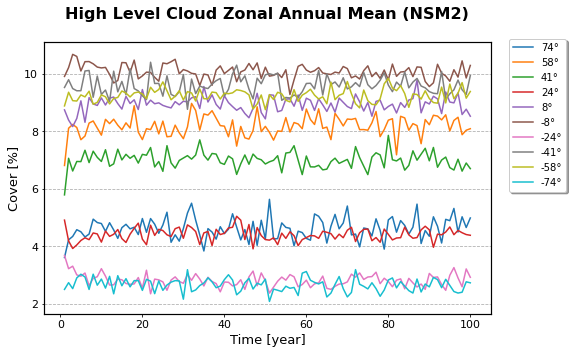

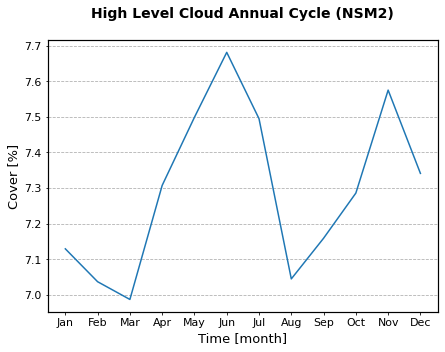

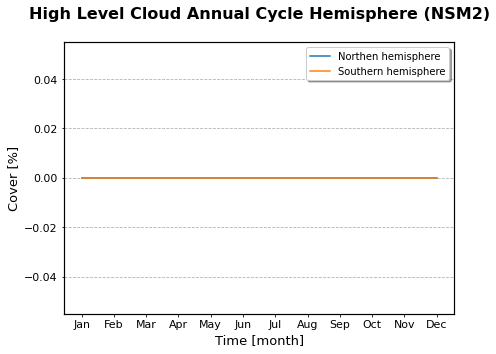

...

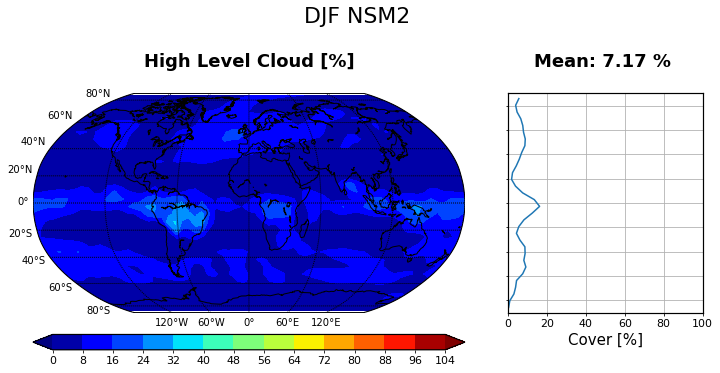

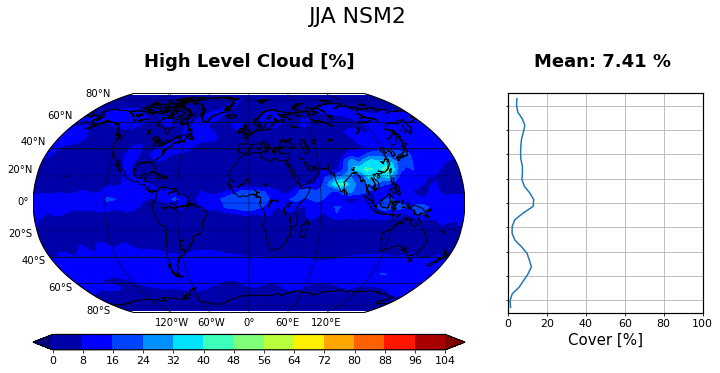

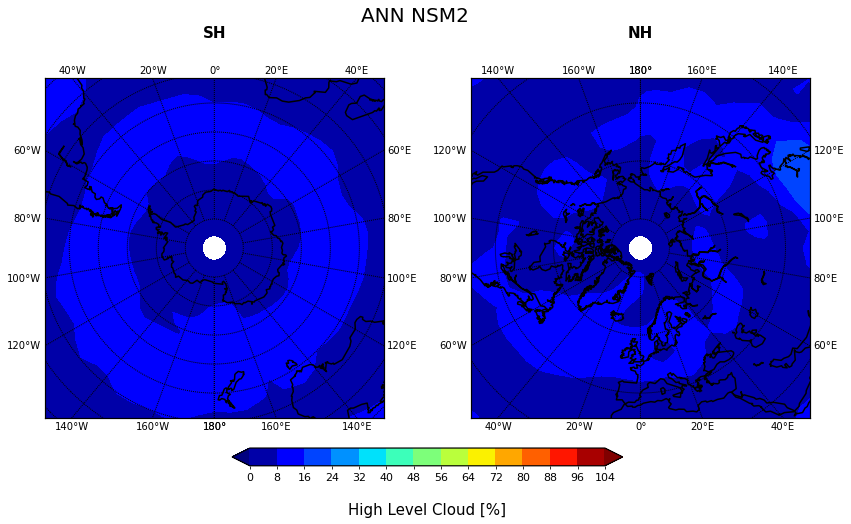

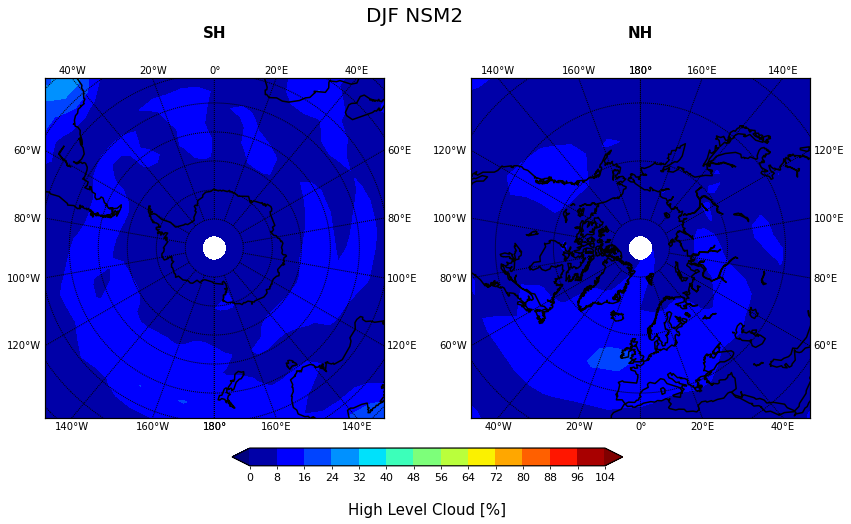

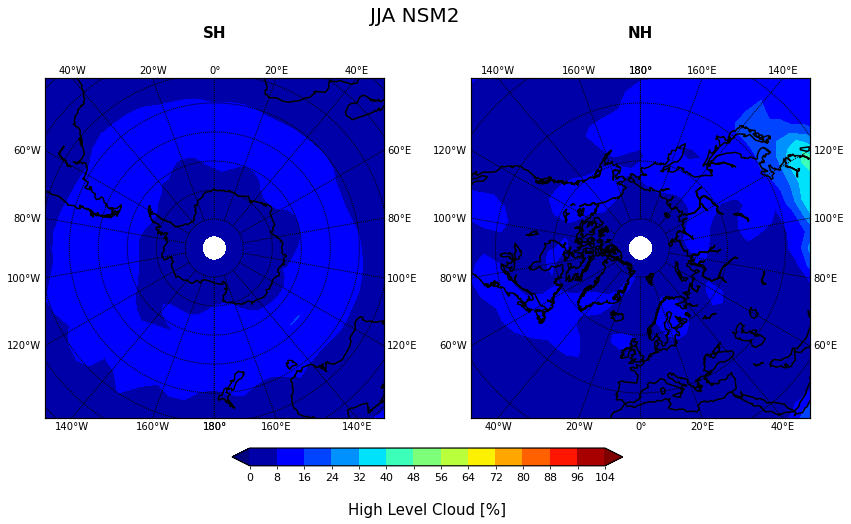

In [11]:
var="clh"
clh=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=0,vmx=100,save=True)

clh_annual=clh.global_annual_mean()

clh_zonal=clh.zonal_mean()

clh_zonal_annual=clh.zonal_annual_mean()

clh_annual_cycle=clh.annual_cycle()

clh.annual_cycle_hemisphere()

clh_global=clh.global_vision()

clh.global_and_zonal()

clh.polar()

# CLM #

Mean 70-100: 9.98768 dev.std: 0.01164 %
Global Mean: 9.995 %
Mean over Land with 0.5 as threshold: 10.119 % 
Mean over Ocean with 0.5 as threshold: 9.945 %
Mean over Antarctica with 0.5 as threshold: 15.676 %
Land part 382.13311, Ocean Part 942.63316


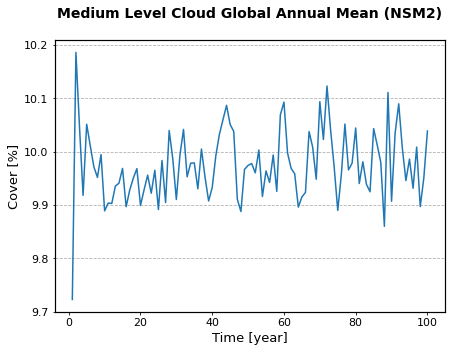

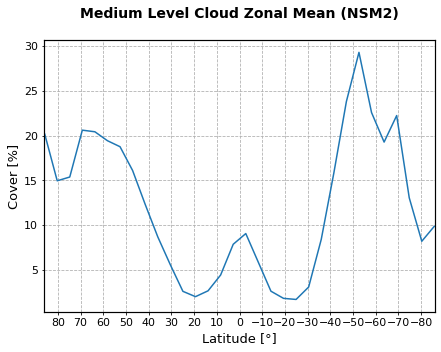

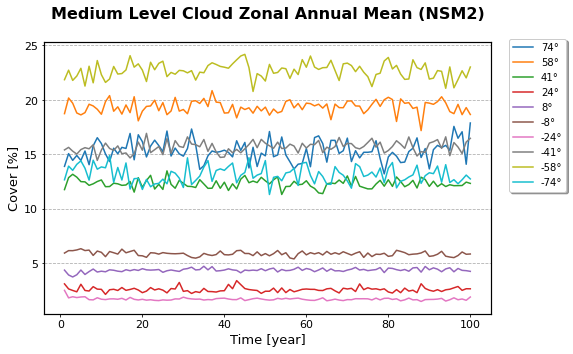

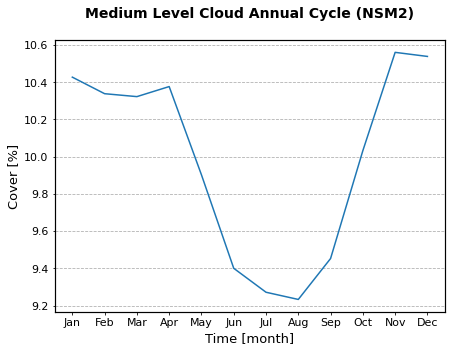

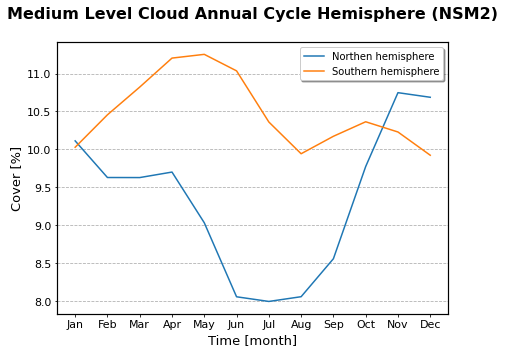

...

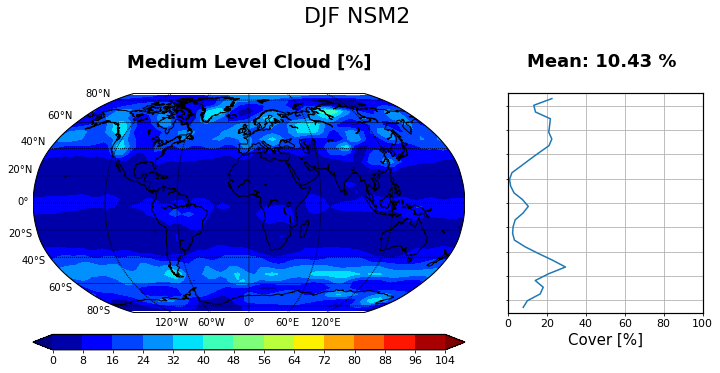

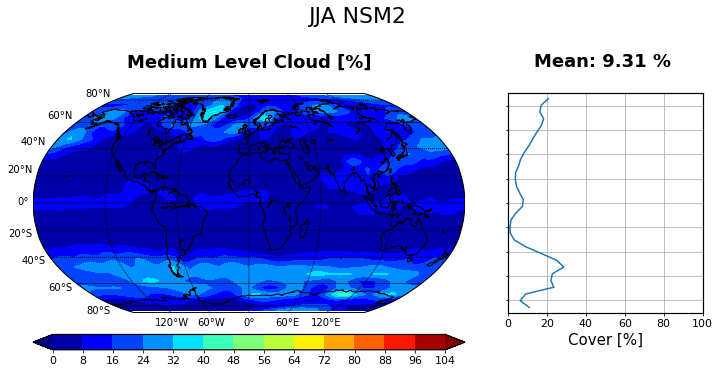

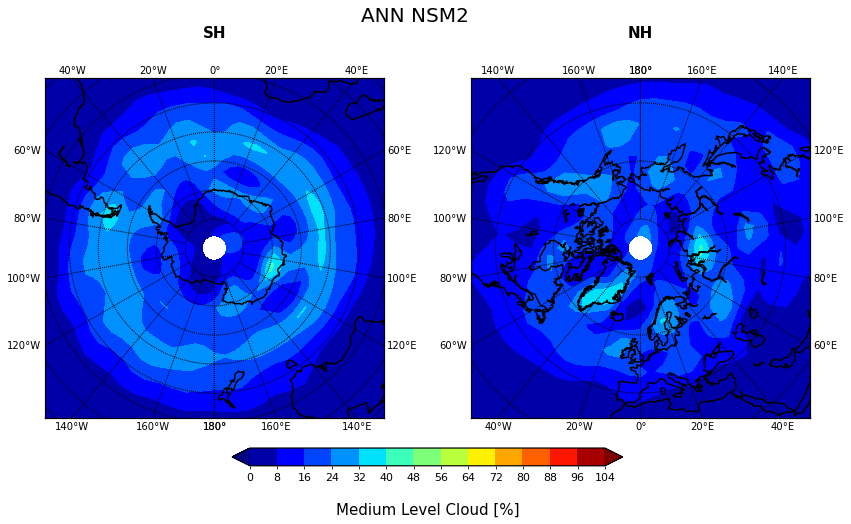

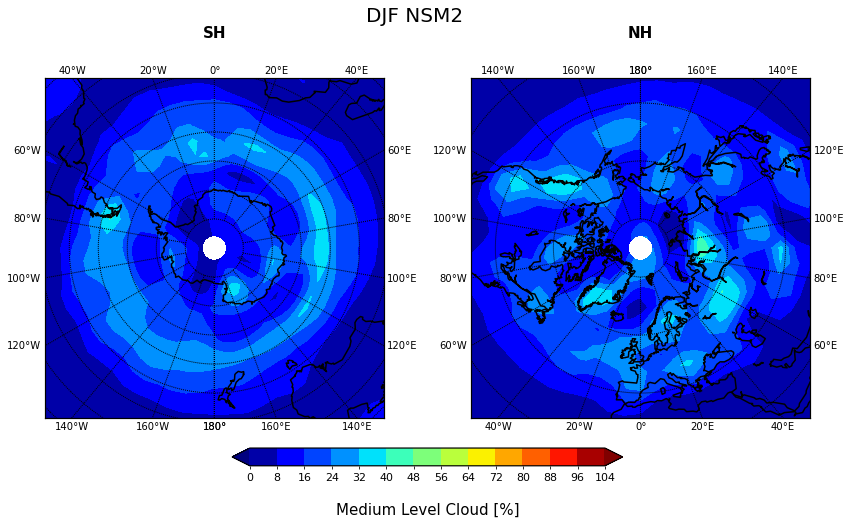

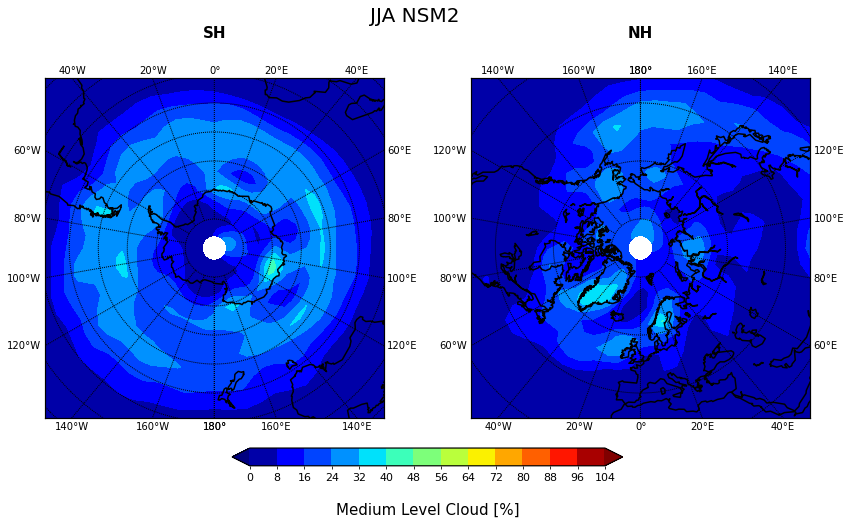

In [12]:
var="clm"
clm=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=0,vmx=100,save=True)

clm_annual=clm.global_annual_mean()

clm_zonal=clm.zonal_mean()

clm_zonal_annual=clm.zonal_annual_mean()

clm_annual_cycle=clm.annual_cycle()

clm.annual_cycle_hemisphere()

clm_global=clm.global_vision()

clm.global_and_zonal()

clm.polar()

# CLL #

Mean 70-100: 11.87663 dev.std: 0.00845 %
Global Mean: 11.882 %
Mean over Land with 0.5 as threshold: 11.330 % 
Mean over Ocean with 0.5 as threshold: 12.105 %
Mean over Antarctica with 0.5 as threshold: 17.790 %
Land part 382.13311, Ocean Part 942.63316


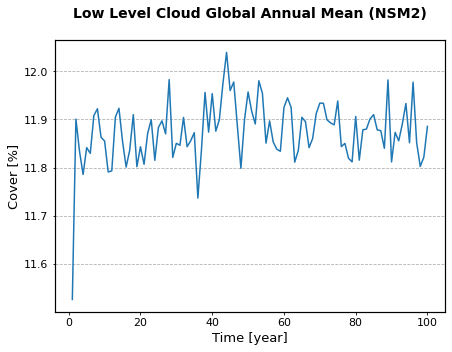

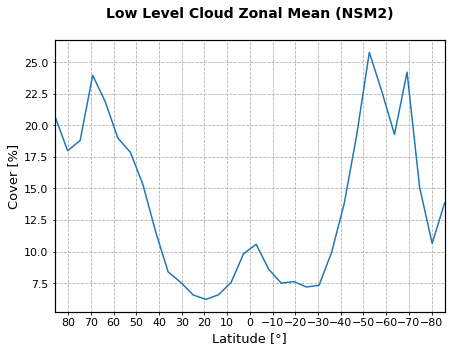

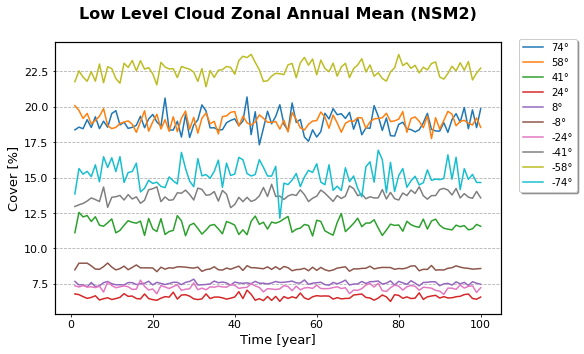

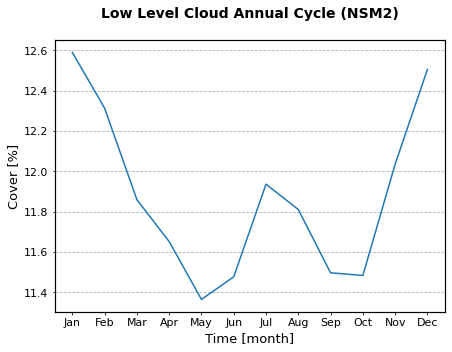

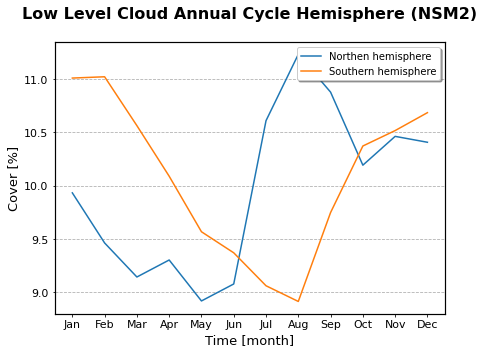

...

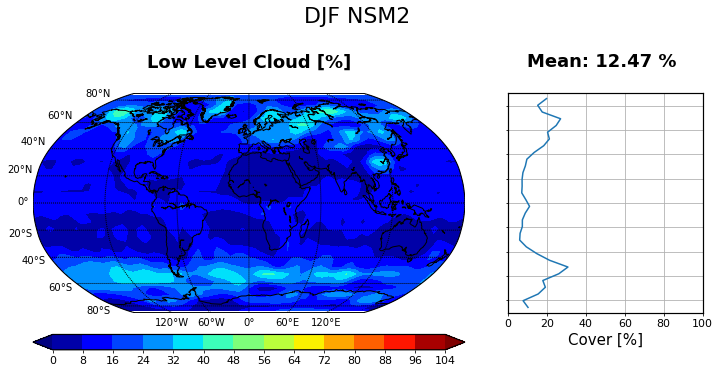

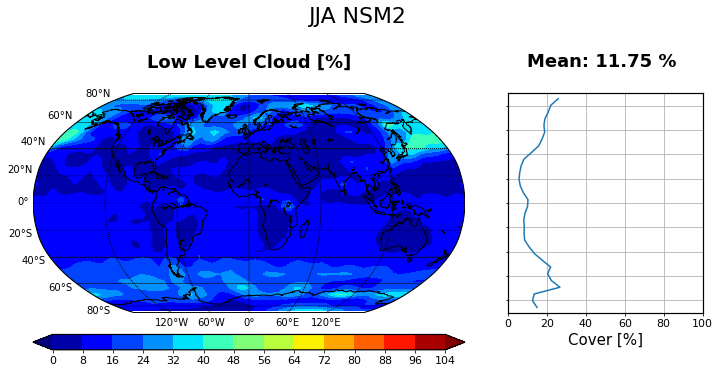

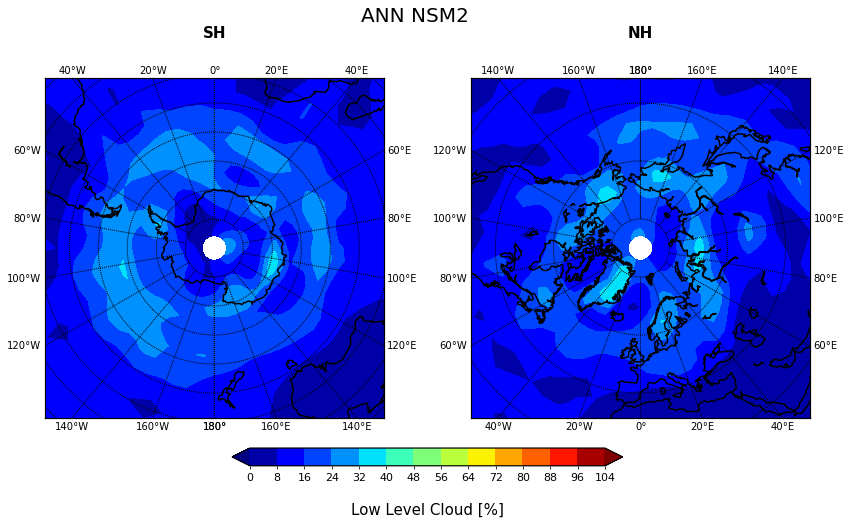

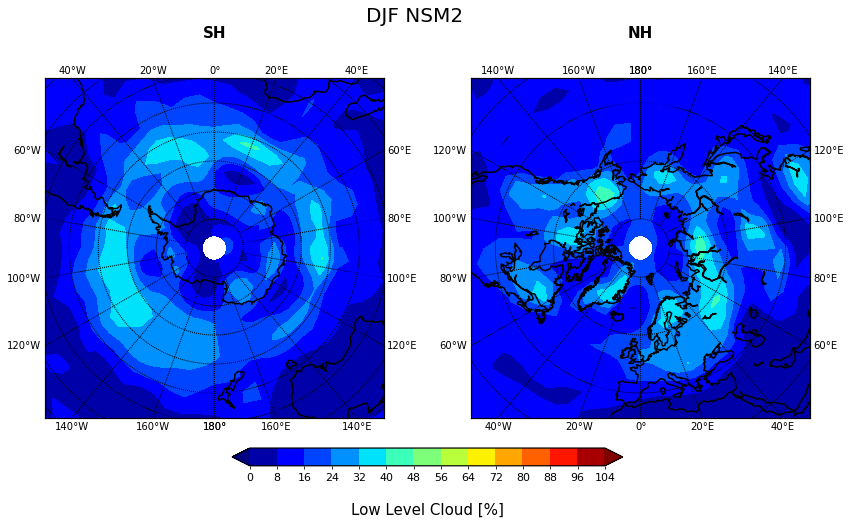

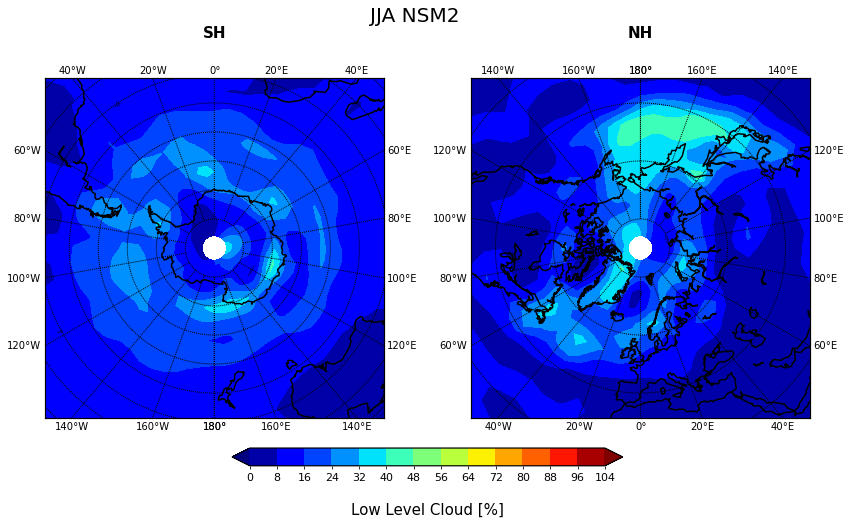

In [13]:
var="cll"
cll=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=0,vmx=100,save=True)

cll_annual=cll.global_annual_mean()

cll_zonal=cll.zonal_mean()

cll_zonal_annual=cll.zonal_annual_mean()

cll_annual_cycle=cll.annual_cycle()

cll.annual_cycle_hemisphere()

cll_global=cll.global_vision()

cll.global_and_zonal()

cll.polar()

# CLT #

Mean 70-100: 52.4245 dev.std: 0.02646 %
Global Mean: 52.428 %
Mean over Land with 0.5 as threshold: 47.645 % 
Mean over Ocean with 0.5 as threshold: 54.368 %
Mean over Antarctica with 0.5 as threshold: 46.872 %
Land part 382.13311, Ocean Part 942.63316


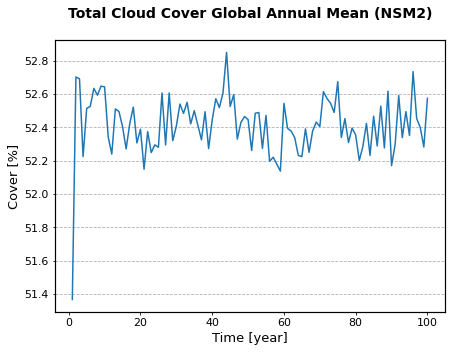

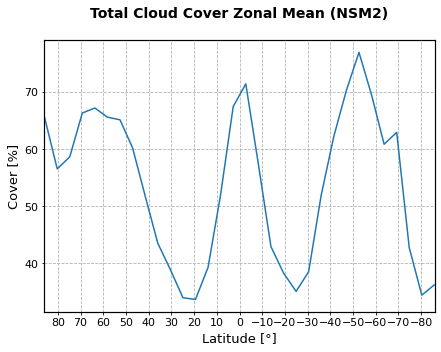

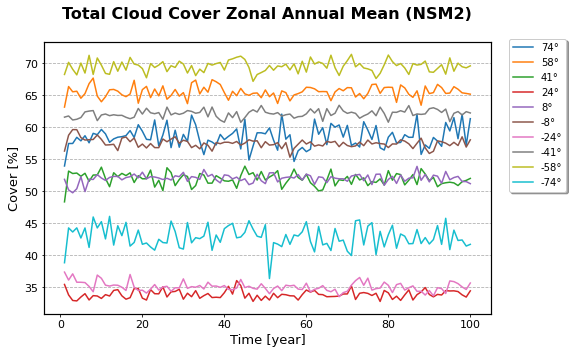

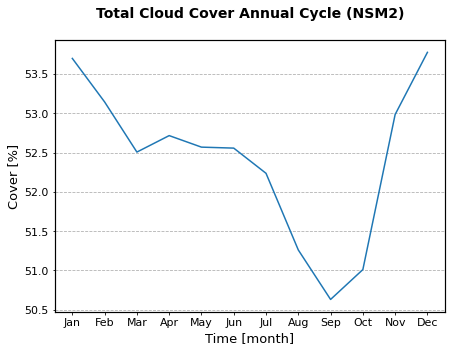

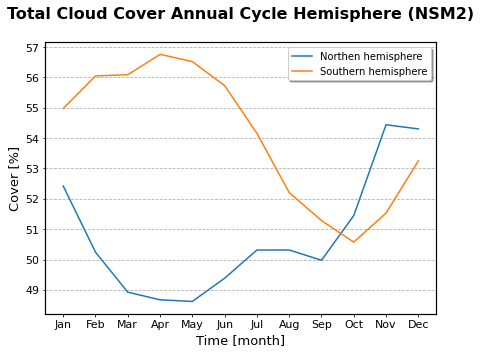

...

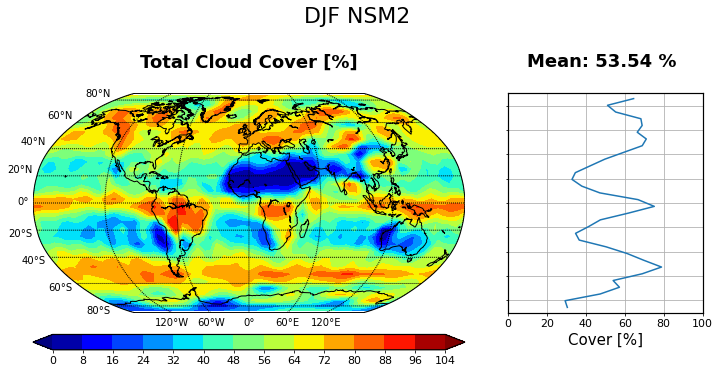

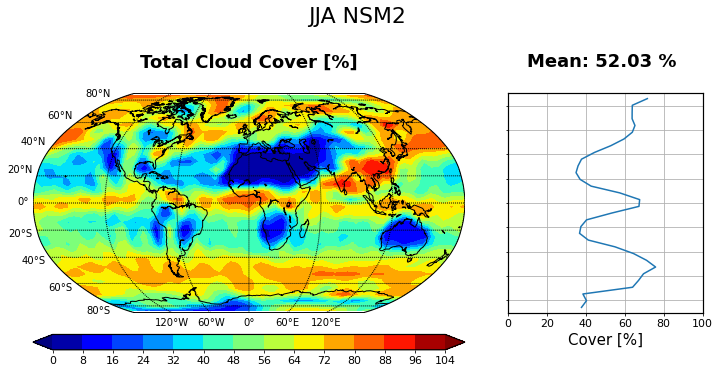

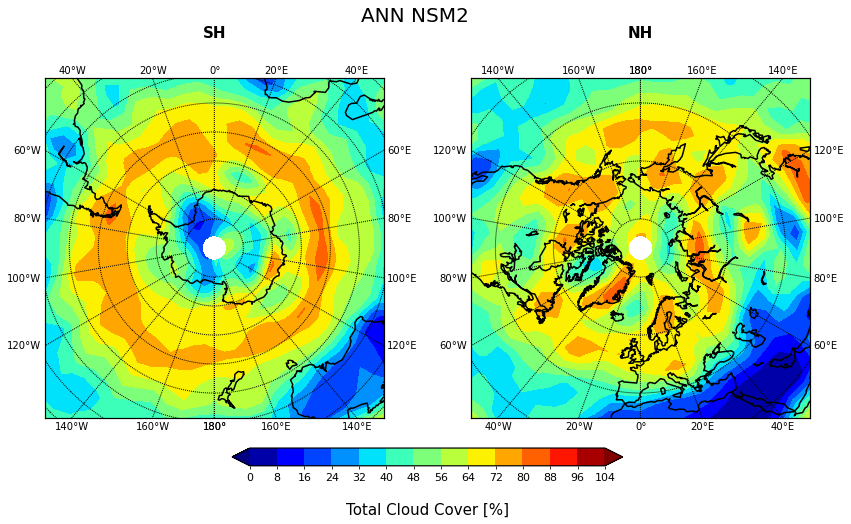

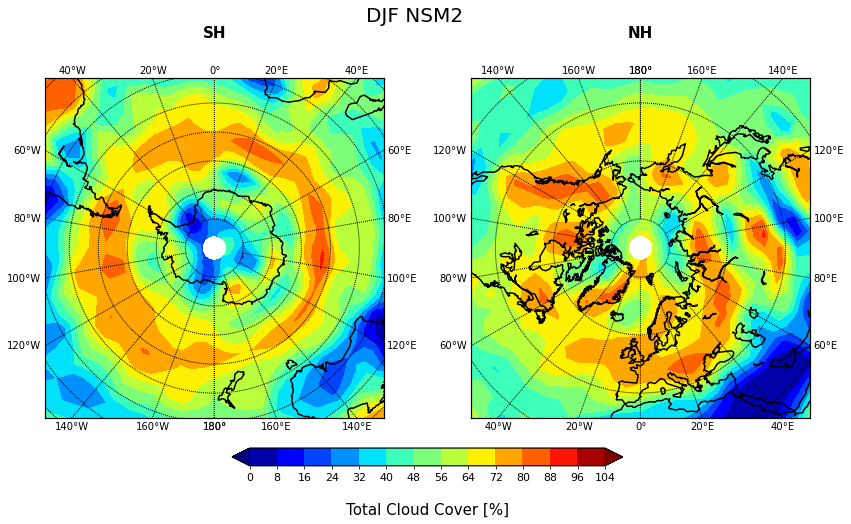

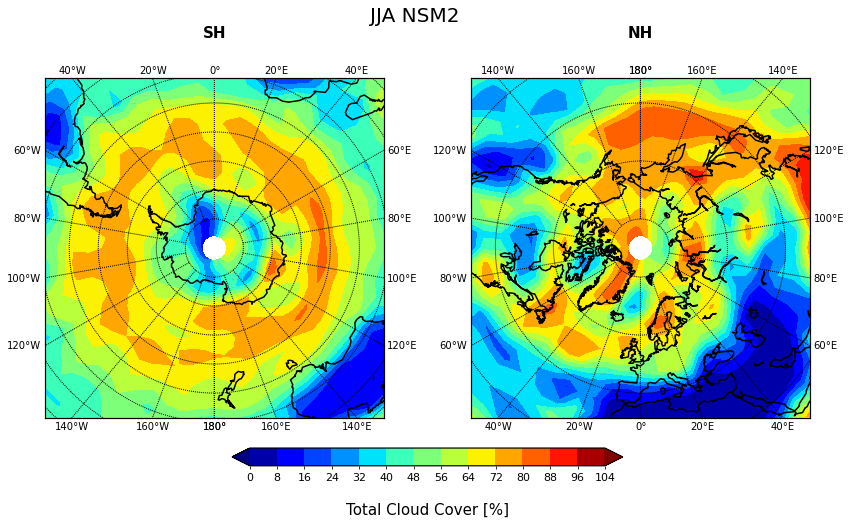

In [14]:
var="clt"
clt=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=0,vmx=100,save=True)

clt_annual=clt.global_annual_mean()

clt_zonal=clt.zonal_mean()

clt_zonal_annual=clt.zonal_annual_mean()

clt_annual_cycle=clt.annual_cycle()

clt.annual_cycle_hemisphere()

clt_global=clt.global_vision()

clt.global_and_zonal()

clt.polar()

# PS #

Mean 70-100: 1011.9558 dev.std: 0.00168 hPa
Global Mean: 1011.955 hPa
Mean over Land with 0.5 as threshold: 1012.291 hPa 
Mean over Ocean with 0.5 as threshold: 1011.819 hPa
Mean over Antarctica with 0.5 as threshold: 1004.777 hPa
Land part 382.13311, Ocean Part 942.63316


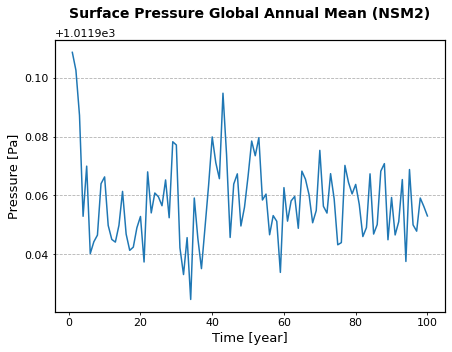

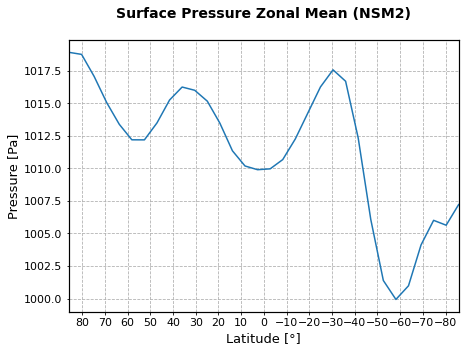

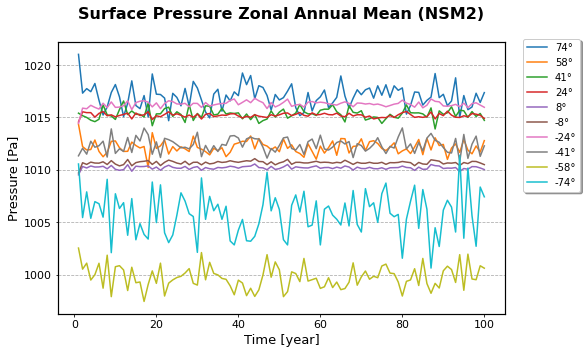

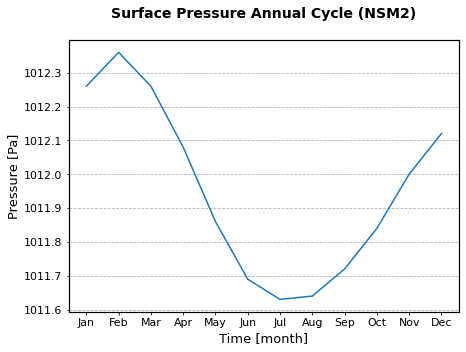

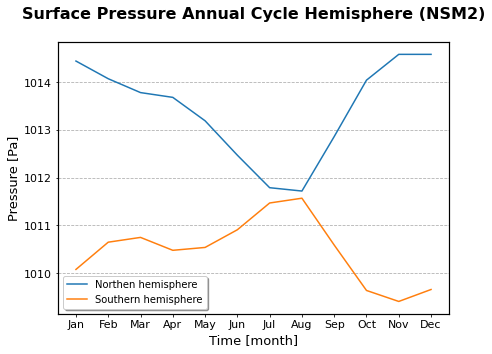

...

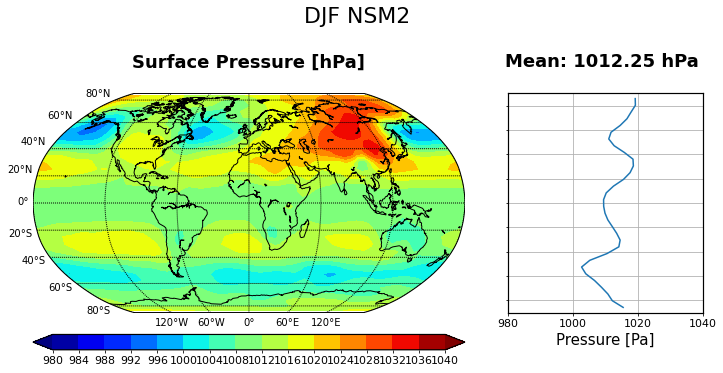

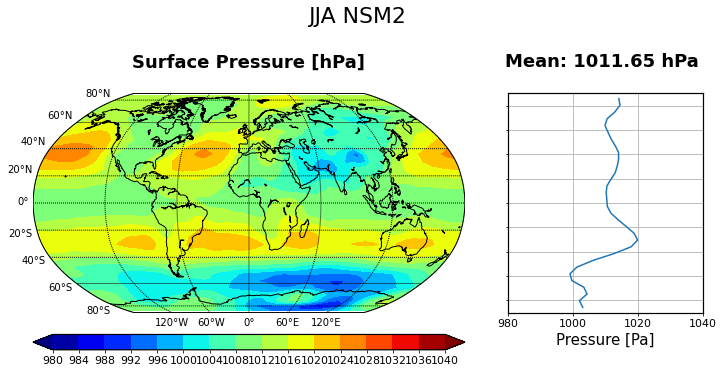

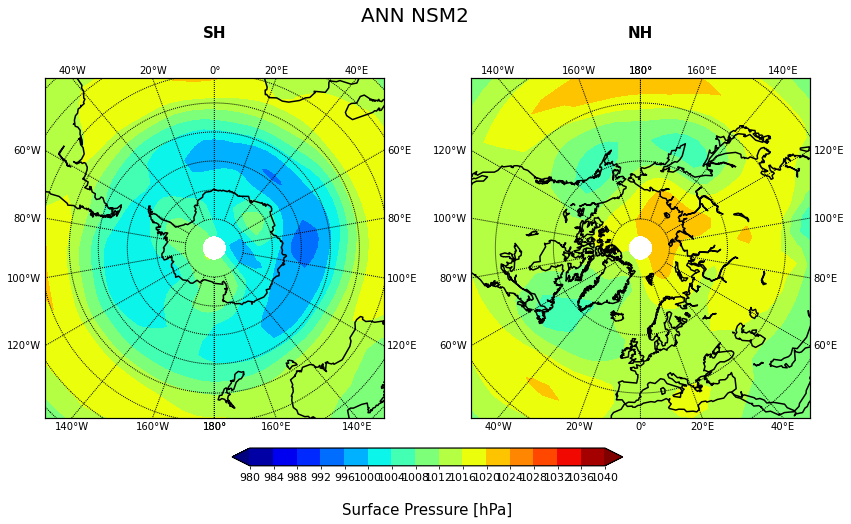

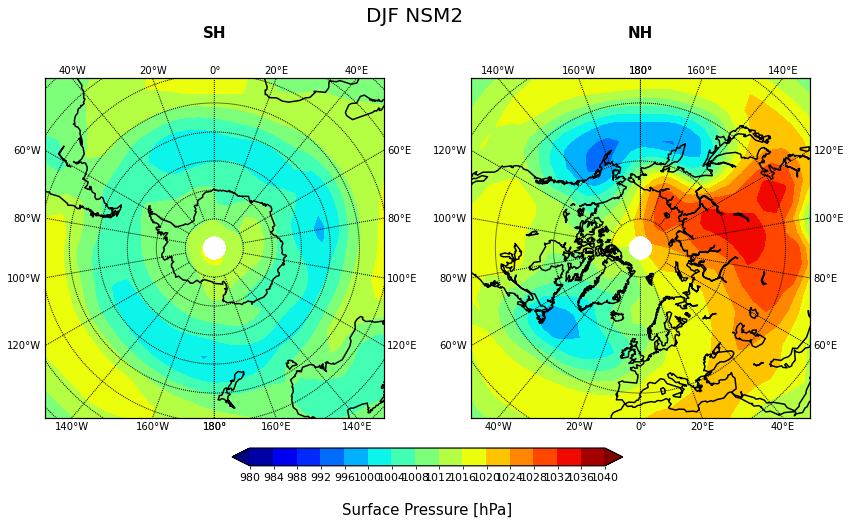

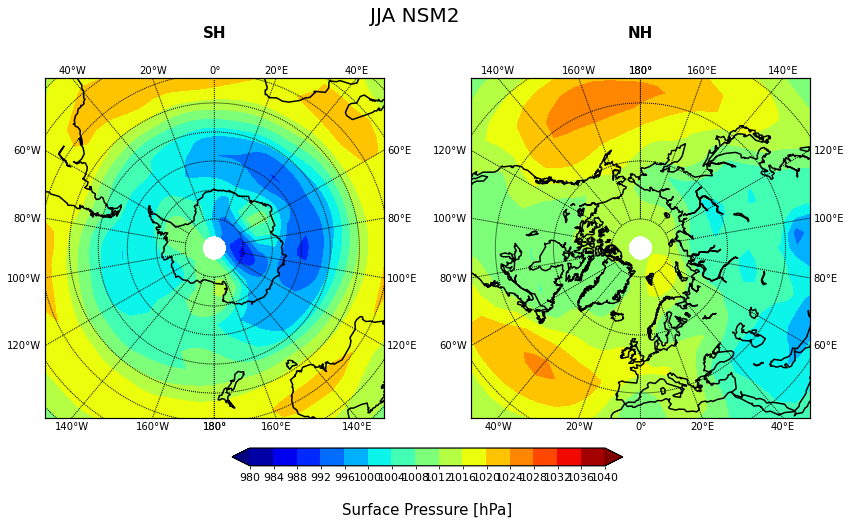

In [15]:
var="ps"
alb=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=980,vmx=1040,save=True)

alb_annual=alb.global_annual_mean()

alb_zonal=alb.zonal_mean()

alb_zonal_annual=alb.zonal_annual_mean()

alb_annual_cycle=alb.annual_cycle()

alb.annual_cycle_hemisphere()

alb_global=alb.global_vision()

alb.global_and_zonal()

alb.polar()

# GEOPOTENTIAL 850 hPa#

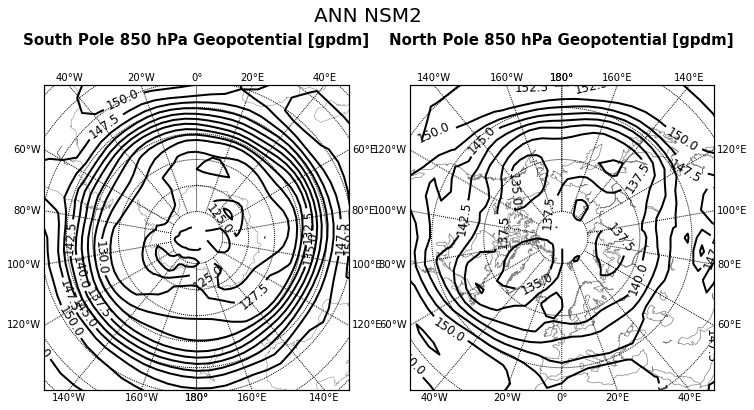

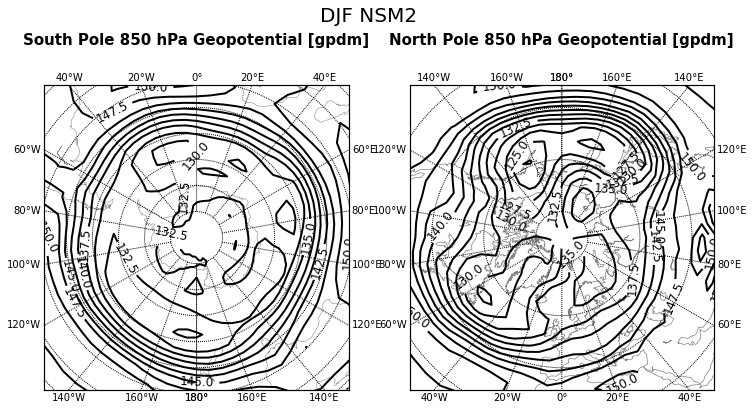

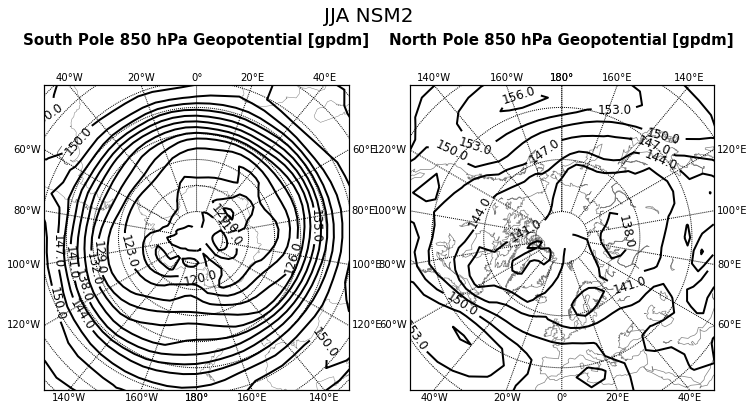

In [16]:
var="zh"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][0]*9.81/100
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][0]*9.81/100
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][0]*9.81/100 
# 2 è la stagione, il secondo è il livello
mn=mx=0
pole_graph("ANN "+name_simulation,data_ann,"850 hPa Geopotential [gpdm]",15,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,"850 hPa Geopotential [gpdm]",15,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,"850 hPa Geopotential [gpdm]",15,"k",lats,lons)

# Geopotential 500 hPa #

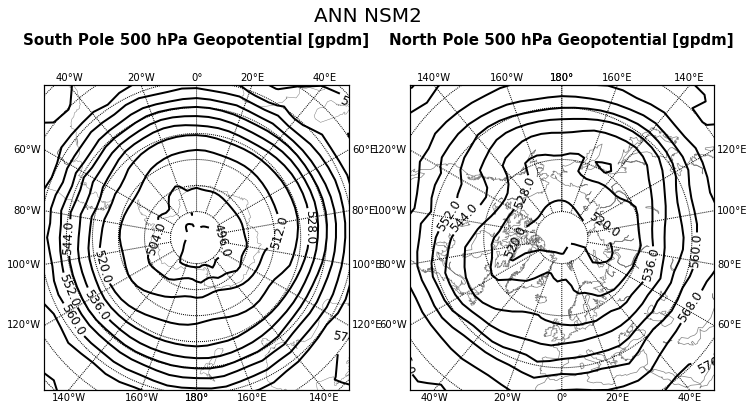

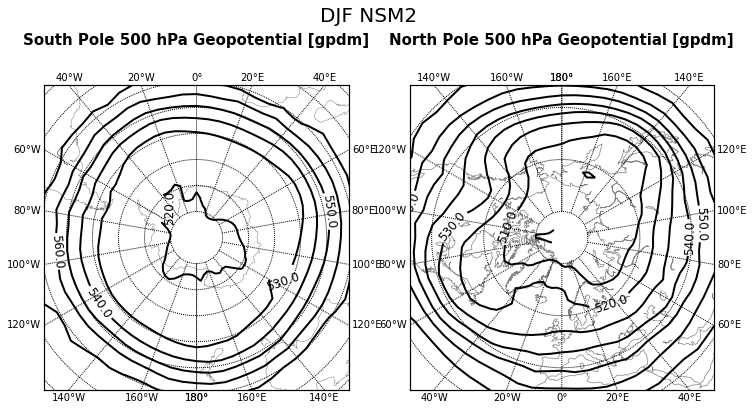

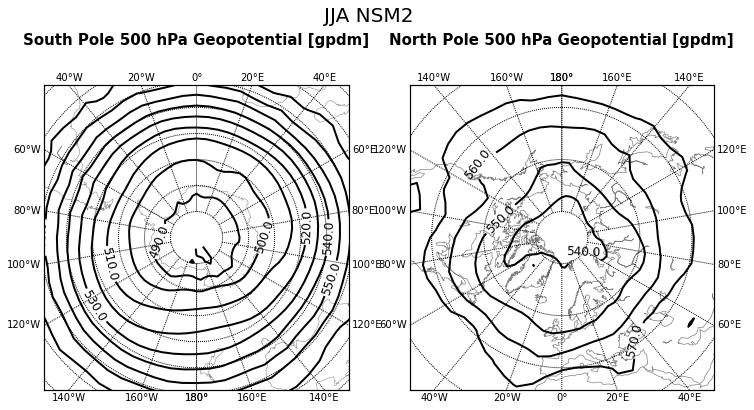

In [17]:
var="zh"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][1]*9.81/100
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][1]*9.81/100
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][1]*9.81/100
mn=mx=0
pole_graph("ANN "+name_simulation,data_ann,"500 hPa Geopotential [gpdm]",15,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,"500 hPa Geopotential [gpdm]",10,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,"500 hPa Geopotential [gpdm]",12,"k",lats,lons)

# Geopotential 250 hPa #

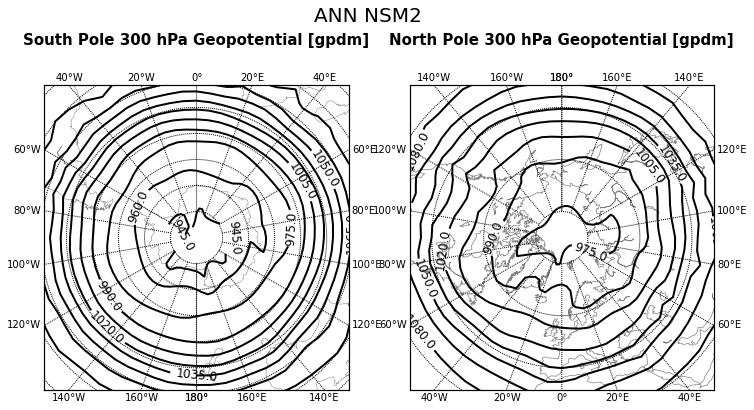

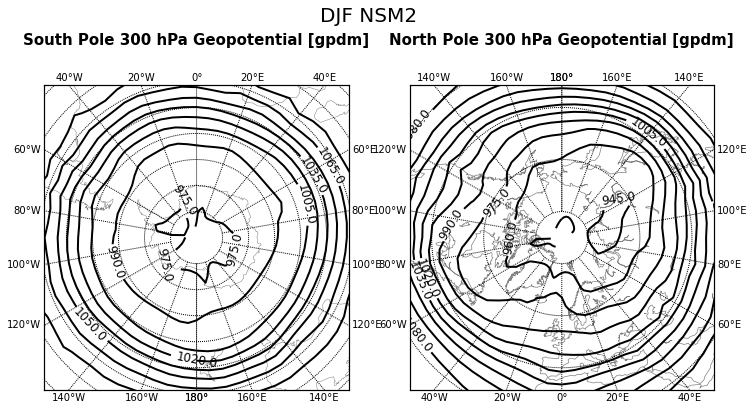

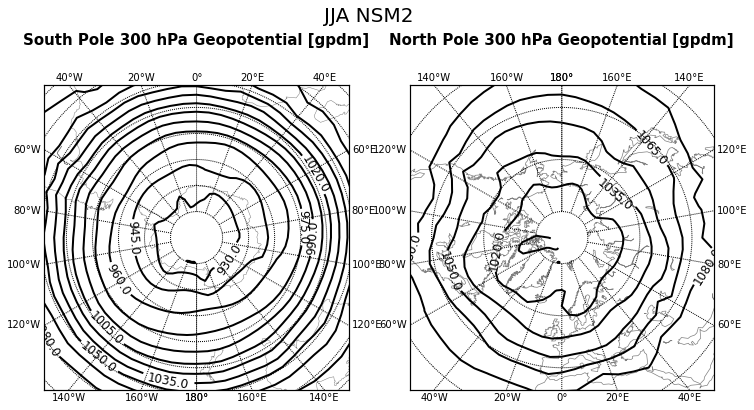

In [18]:
var="zh"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]*9.81/100
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]*9.81/100
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][3]*9.81/100
mn=mx=0
pole_graph("ANN "+name_simulation,data_ann,"300 hPa Geopotential [gpdm]",15,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,"300 hPa Geopotential [gpdm]",15,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,"300 hPa Geopotential [gpdm]",15,"k",lats,lons)

# HUS #

Mean level 1000 hPa: 9.147 g Kg^-1
Mean level 850 hPa: 5.710 g Kg^-1
Mean level 700 hPa: 3.421 g Kg^-1
Mean level 500 hPa: 1.656 g Kg^-1
Mean level 400 hPa: 0.985 g Kg^-1
Mean level 300 hPa: 0.450 g Kg^-1
Mean level 250 hPa: 0.259 g Kg^-1
Mean level 200 hPa: 0.102 g Kg^-1
Mean level 150 hPa: 0.050 g Kg^-1
Mean level 100 hPa: 0.016 g Kg^-1
Mean level 70 hPa: 0.009 g Kg^-1
Mean level 50 hPa: 0.005 g Kg^-1
Mean level 30 hPa: 0.001 g Kg^-1


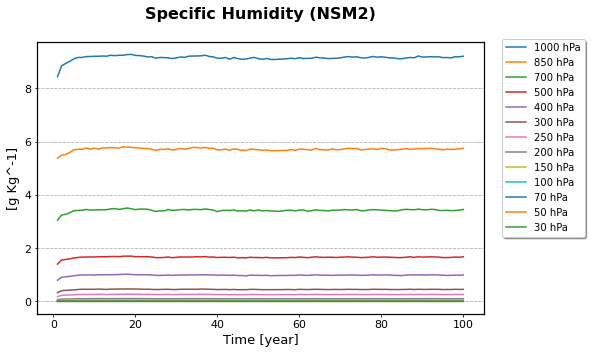

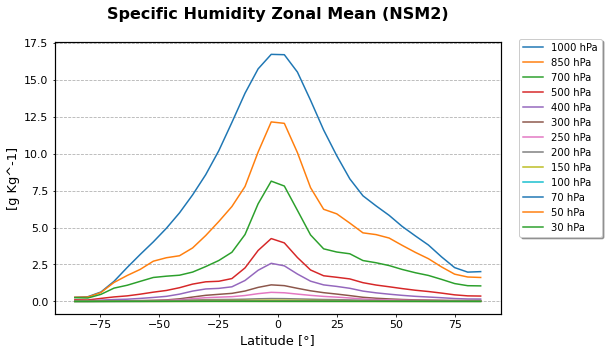

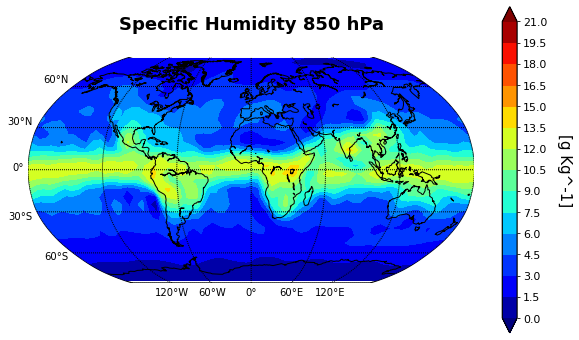

True


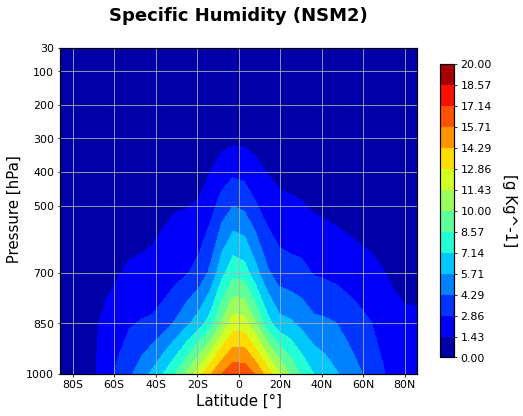

In [19]:
var="hus"
hus=lev_variable(var,1,press,var_dic[var][0],simulation,
        var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],contourf=True,vmn=0,vmx=20)

hus_global=hus.global_annual_mean_level()

hus_zonal=hus.zonal_mean_level()

#hus_annual_cycle=hus.annual_cycle_level() /////It takes too long

hus.global_vision_level()

hus.graph_level()

# ICEC #

Mean 70-100: 5.83234 dev.std: 0.02119 %
Global Mean:   nan %
Mean over Land with 0.5 as threshold:   nan % 
Mean over Ocean with 0.5 as threshold: 5.835 %
Mean over Antarctica with 0.5 as threshold:   nan %
Land part 382.13311, Ocean Part 942.63316


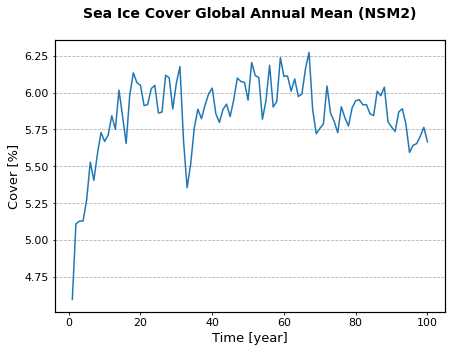

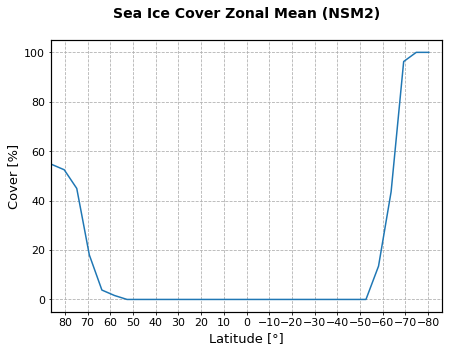

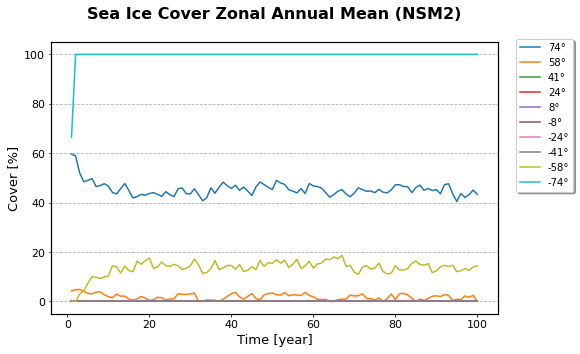

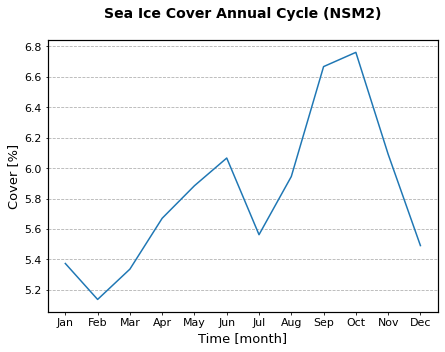

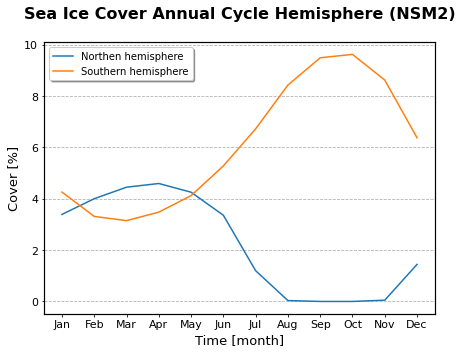

...

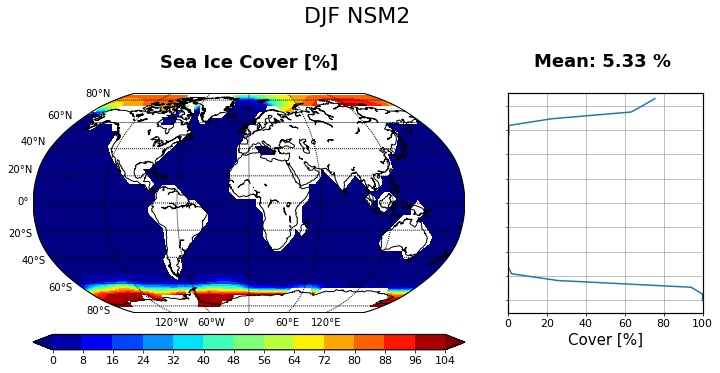

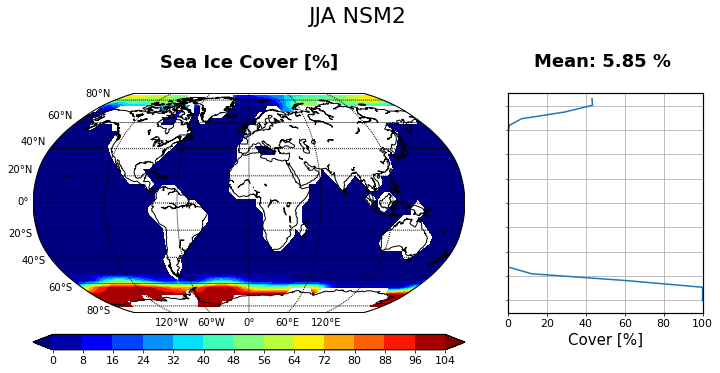

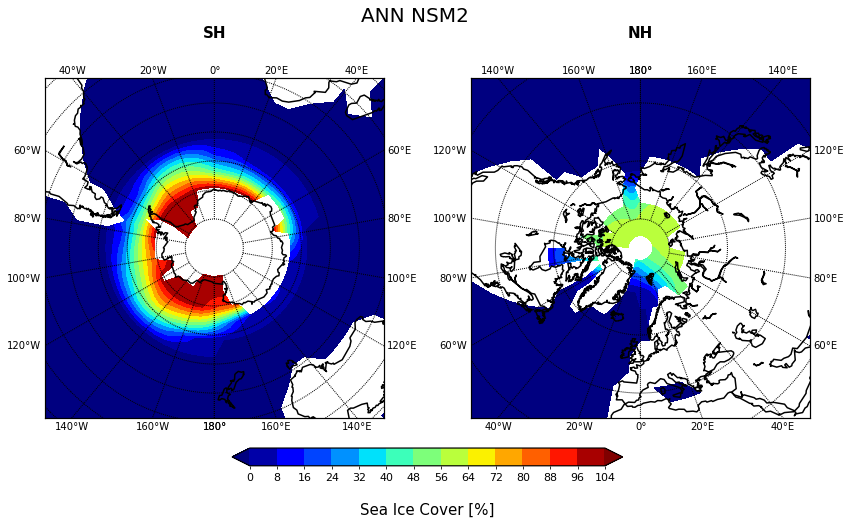

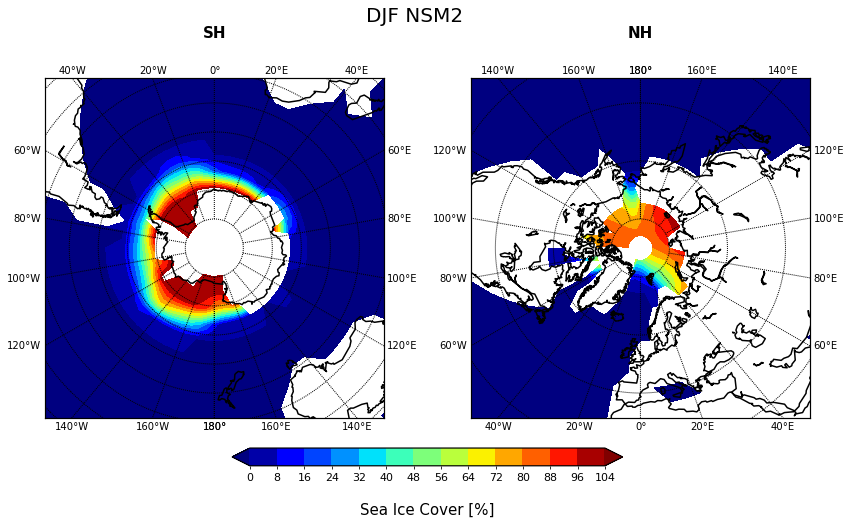

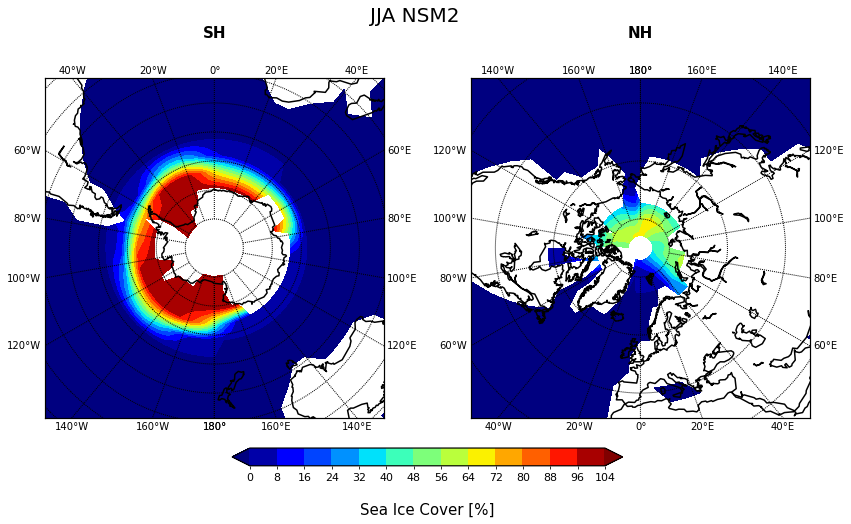

In [20]:
var="icec"
sic=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=0,vmx=100,save=True)

sic_annual=sic.global_annual_mean()

sic_zonal=sic.zonal_mean()

sic_zonal_annual=sic.zonal_annual_mean()

sic_annual_cycle=sic.annual_cycle()

sic.annual_cycle_hemisphere()

sic_global=sic.global_vision()

sic.global_and_zonal()

sic.polar()

# Mass Stream Function #

In [21]:
help(zonal)

Help on function zonal in module __main__:

zonal(colorc, cost, name_run, save, step, title, ydata, path, fm='%2.f', contourf=False, vmn=None, vmx=None, location='upper right')



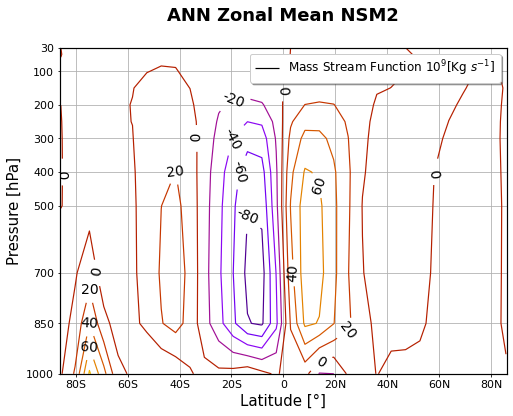

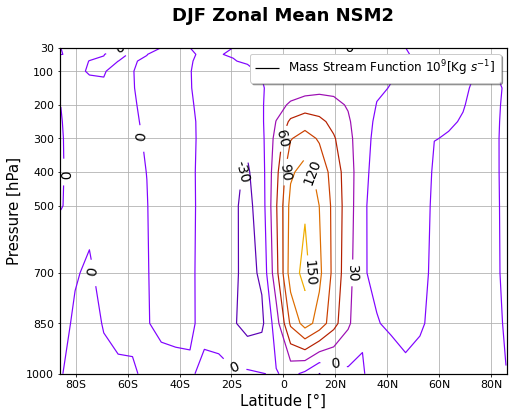

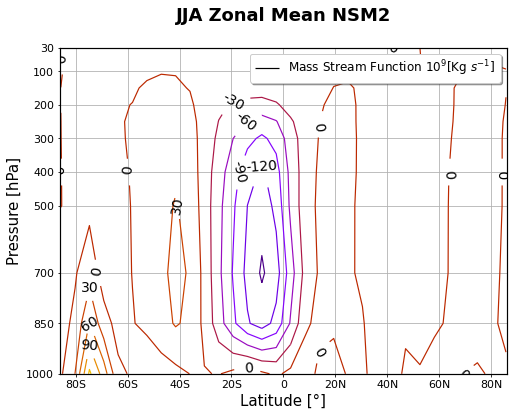

In [22]:
zonal_mastrfu_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_ZM_"+str(simulation[1])+"Y_"+"mastrfu"+".nc","r").\
                                variables["mastrfu"][:]

zonal_mastrfu_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_ZM_"+str(simulation[1])+"Y_"+\
                         "mastrfu"+".nc","r").variables["mastrfu"][0]

zonal_mastrfu_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_ZM_"+str(simulation[1])+"Y_"+\
                         "mastrfu"+".nc","r").variables["mastrfu"][2]
zonal("gnuplot",pow(10,-9),"ANN Zonal Mean "+name_simulation,\
      True,10,r"Mass Stream Function $10^{9}$[Kg $s^{-1}$]",zonal_mastrfu_ann,file_graph)
zonal("gnuplot",pow(10,-9),"DJF Zonal Mean "+name_simulation,\
      True,7,r"Mass Stream Function $10^{9}$[Kg $s^{-1}$]",zonal_mastrfu_djf,file_graph)
zonal("gnuplot",pow(10,-9),"JJA Zonal Mean "+name_simulation,\
      True,10,r"Mass Stream Function $10^{9}$[Kg $s^{-1}$]",zonal_mastrfu_jja,file_graph)

# SIT #

Mean 70-100: 0.08873 dev.std: 0.00041 m
Global Mean: 0.089 m
Mean over Land with 0.5 as threshold: 0.000 m 
Mean over Ocean with 0.5 as threshold: 0.125 m
Mean over Antarctica with 0.5 as threshold: 0.000 m
Land part 382.13311, Ocean Part 942.63316


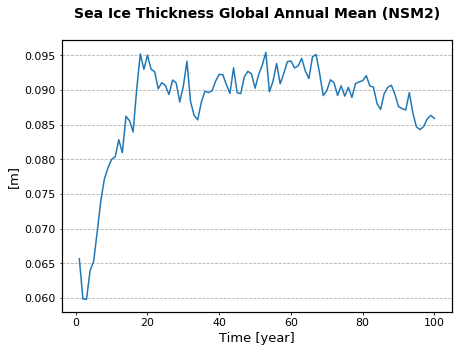

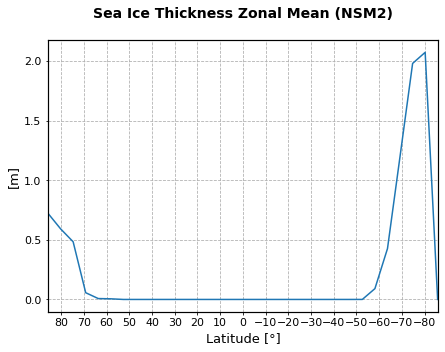

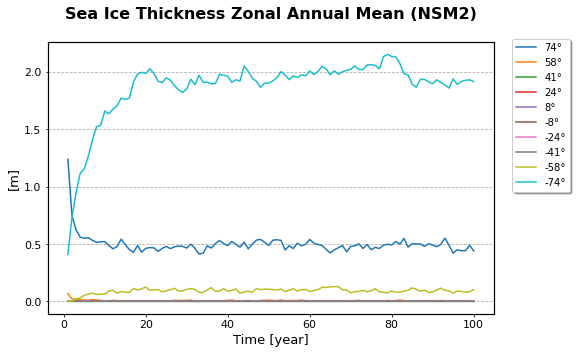

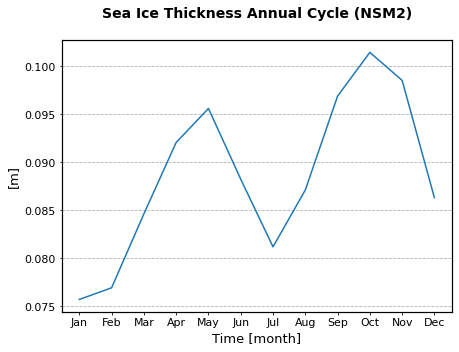

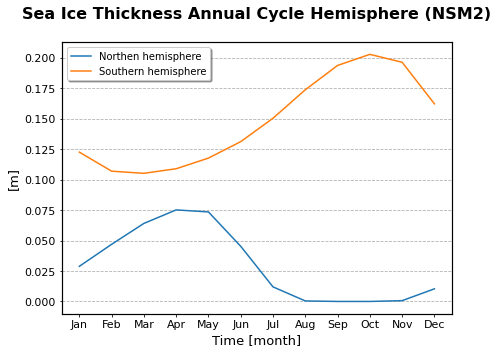

...

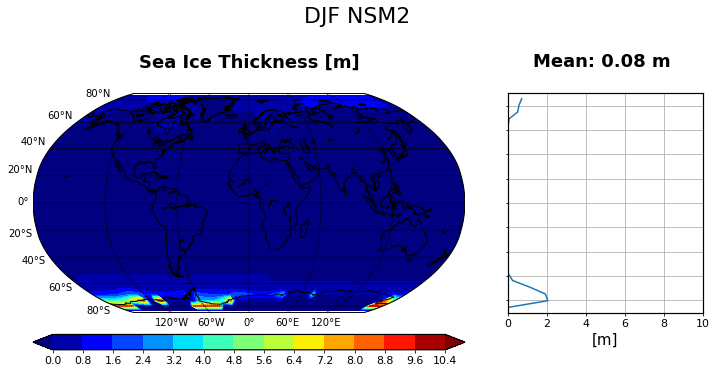

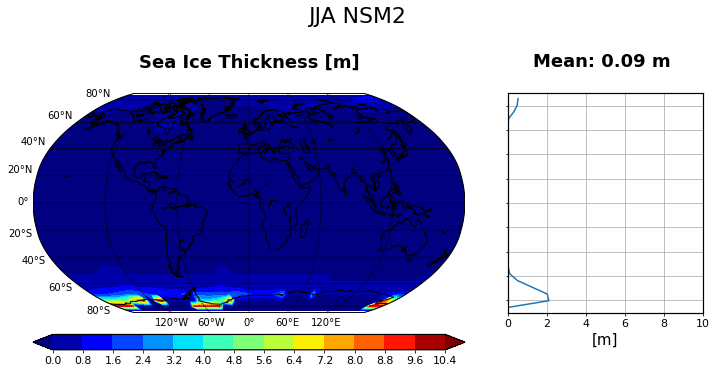

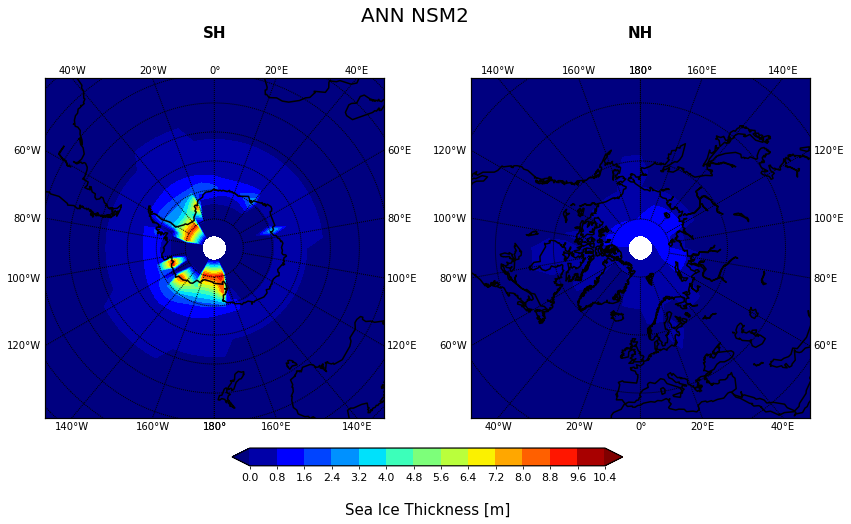

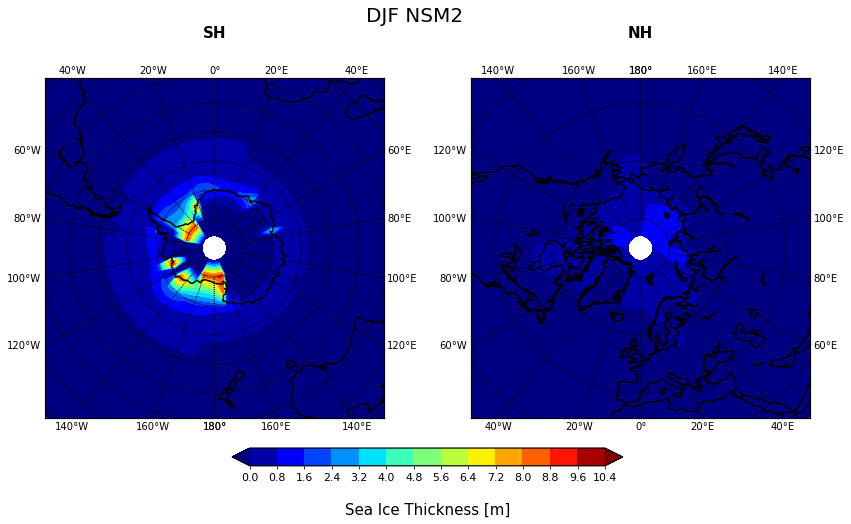

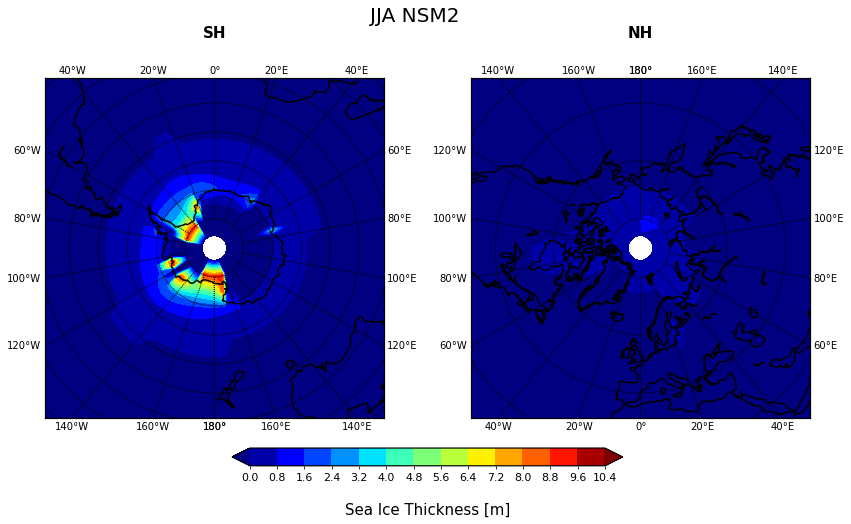

In [23]:
var="sit"
sit=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=0,vmx=10,save=True)

sit_annual=sit.global_annual_mean()

sit_zonal=sit.zonal_mean()

sit_zonal_annual=sit.zonal_annual_mean()

sit_annual_cycle=sit.annual_cycle()

sit.annual_cycle_hemisphere()

sit_global=sit.global_vision()

sit.global_and_zonal()

sit.polar()

# SST #

Mean 70-100: 17.90407 dev.std: 0.00587 °C
Global Mean:   nan °C
Mean over Land with 0.5 as threshold:   nan °C 
Mean over Ocean with 0.5 as threshold: 17.898 °C
Mean over Antarctica with 0.5 as threshold:   nan °C
Land part 382.13311, Ocean Part 942.63316


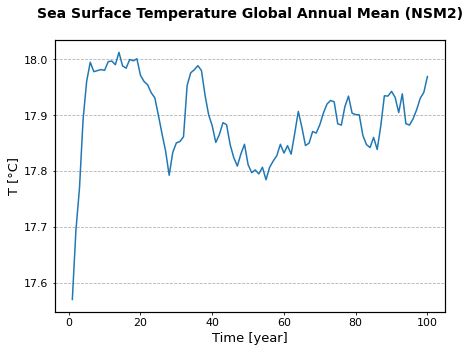

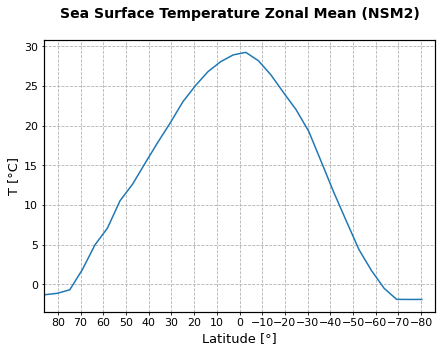

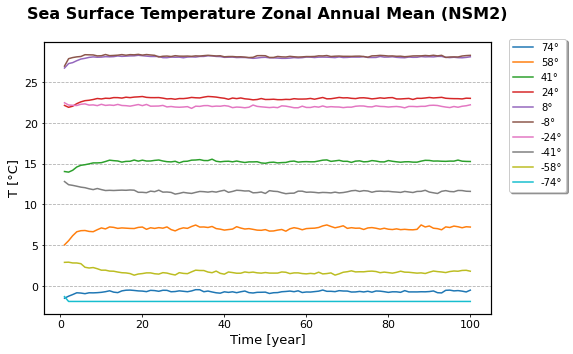

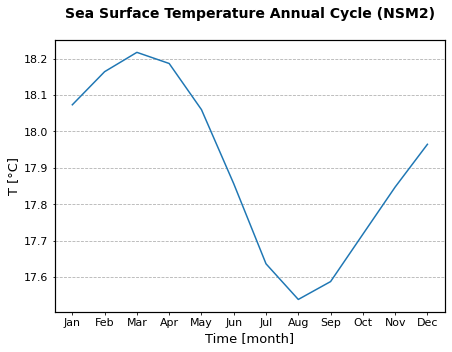

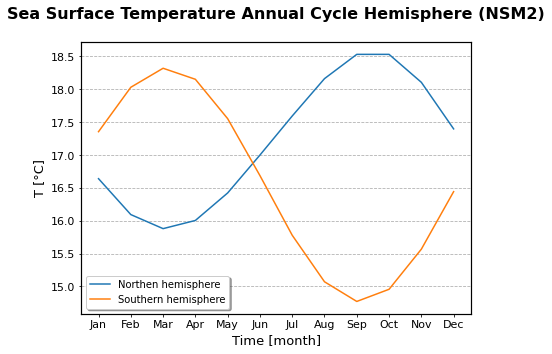

...

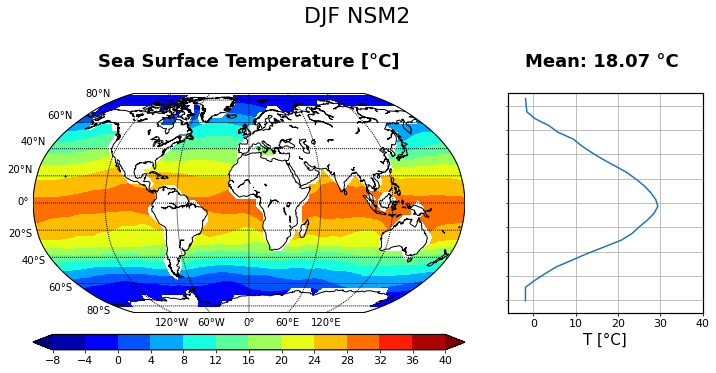

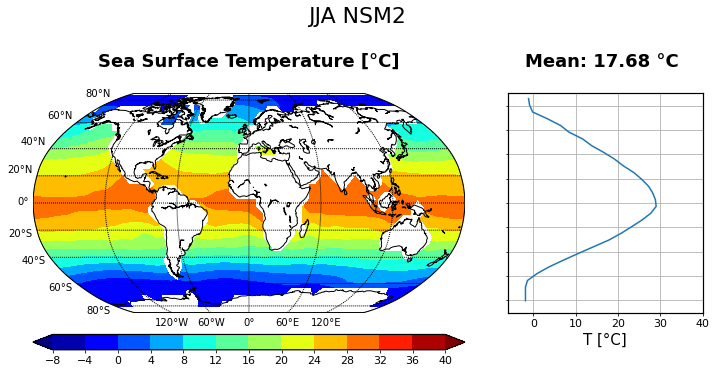

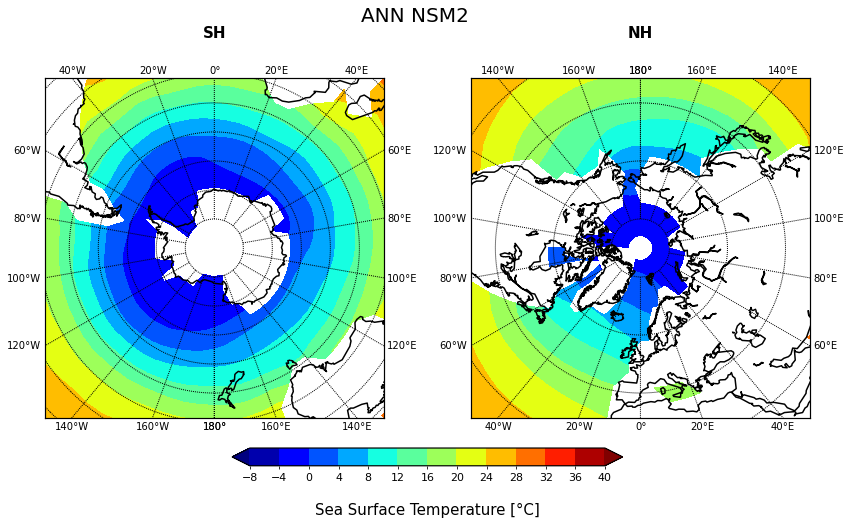

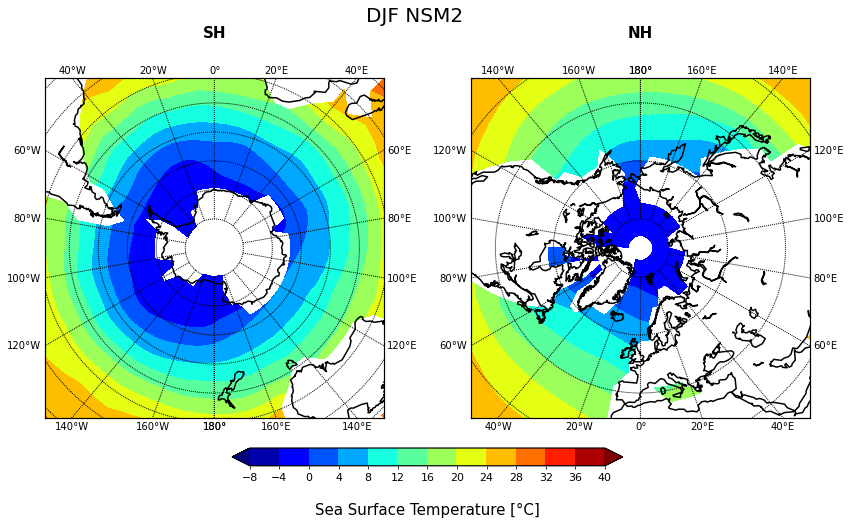

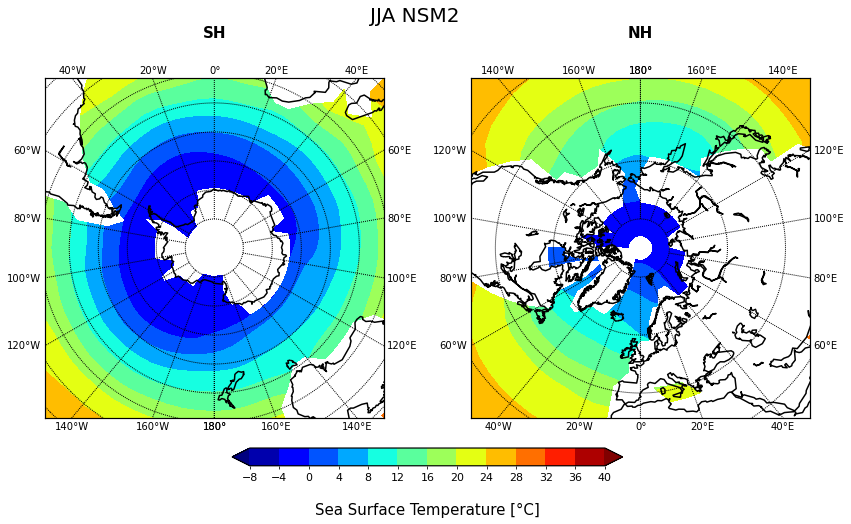

In [24]:
var="sst"
sst=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-6,vmx=40,save=True)

sst_annual=sst.global_annual_mean()

sst_zonal=sst.zonal_mean()

sst_zonal_annual=sst.zonal_annual_mean()

sst_annual_cycle=sst.annual_cycle()

sst.annual_cycle_hemisphere()

sst_global=sst.global_vision()

sst.global_and_zonal()

sst.polar()

# SND #

Mean 70-100: 0.12719 dev.std: 5e-05 m
Global Mean: 0.127 m
Mean over Land with 0.5 as threshold: 0.431 m 
Mean over Ocean with 0.5 as threshold: 0.004 m
Mean over Antarctica with 0.5 as threshold: 4.828 m
Land part 382.13311, Ocean Part 942.63316


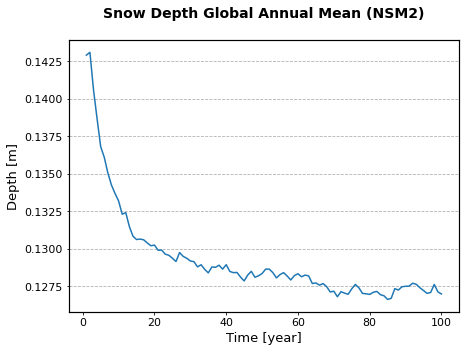

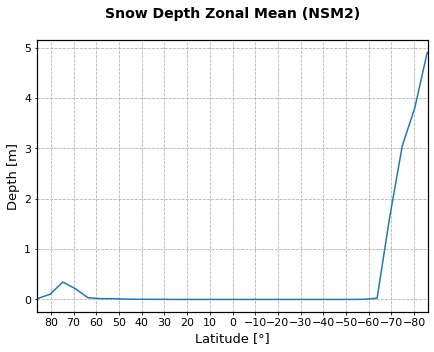

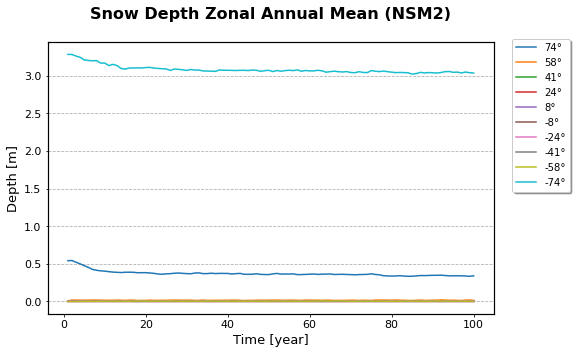

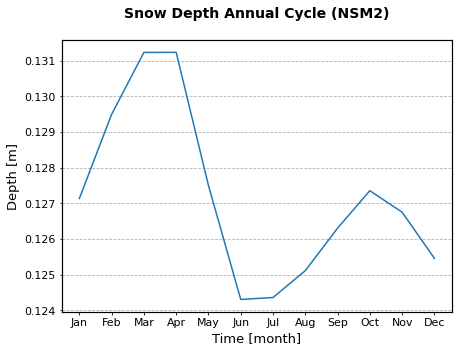

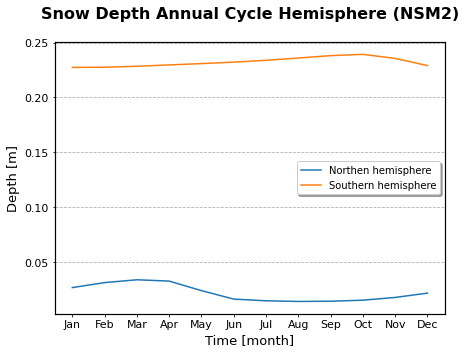

...

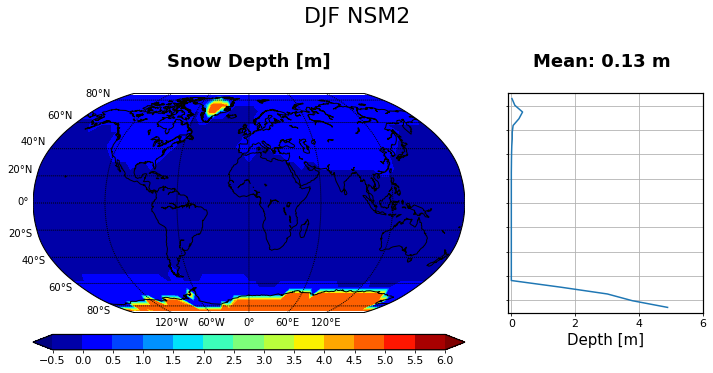

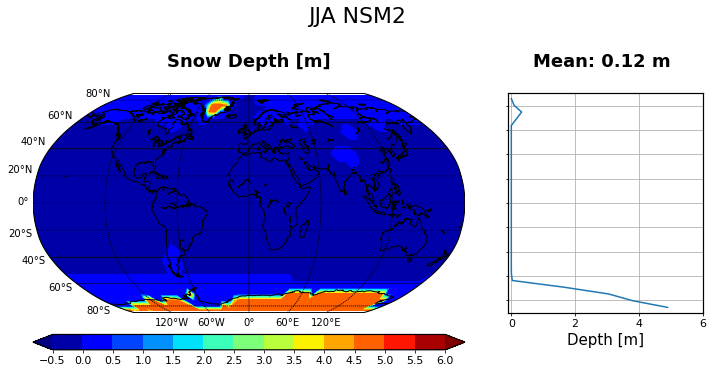

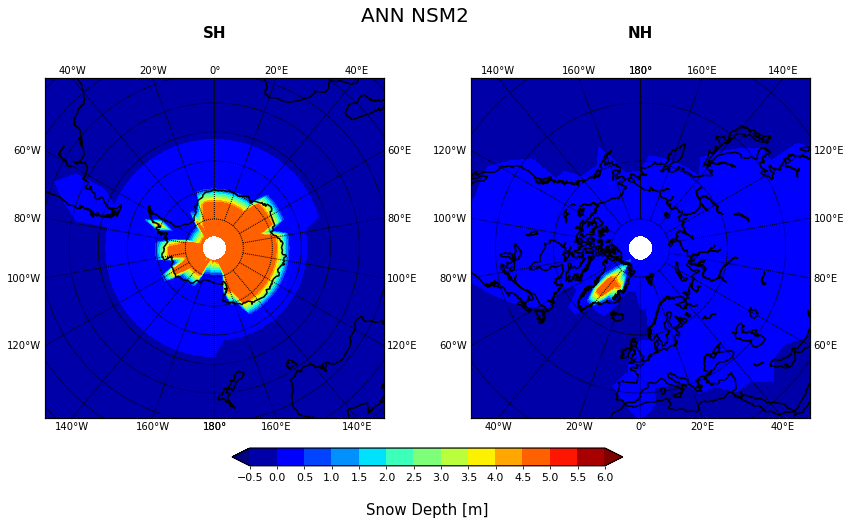

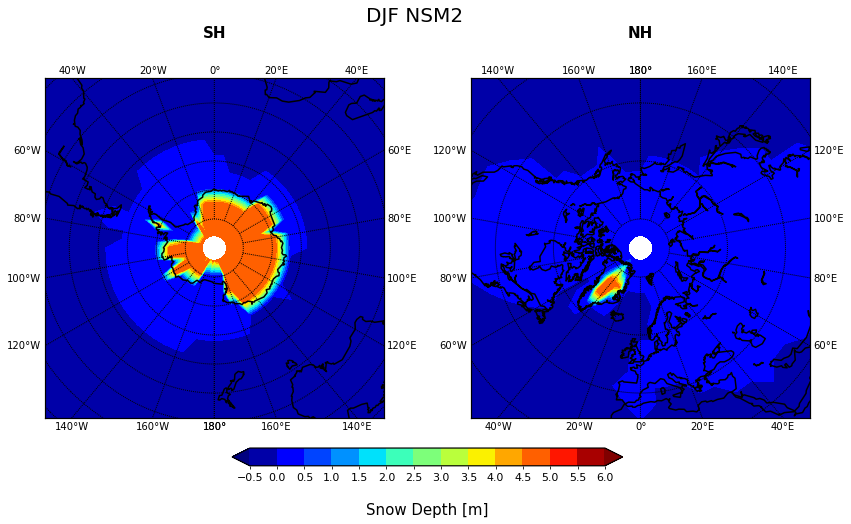

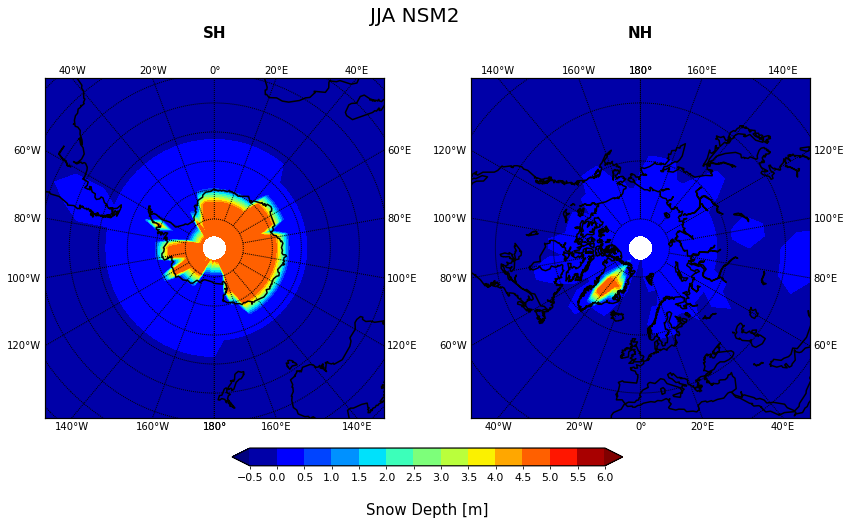

In [25]:
var="snd"
snd=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-0.1,vmx=6,save=True)

snd_annual=snd.global_annual_mean()

snd_zonal=snd.zonal_mean()

snd_zonal_annual=snd.zonal_annual_mean()

snd_annual_cycle=snd.annual_cycle()

snd.annual_cycle_hemisphere()

snd_global=snd.global_vision()

snd.global_and_zonal()

snd.polar()

# Vorticity  850 hPa#

-20.48165879386943 27.507687264005654


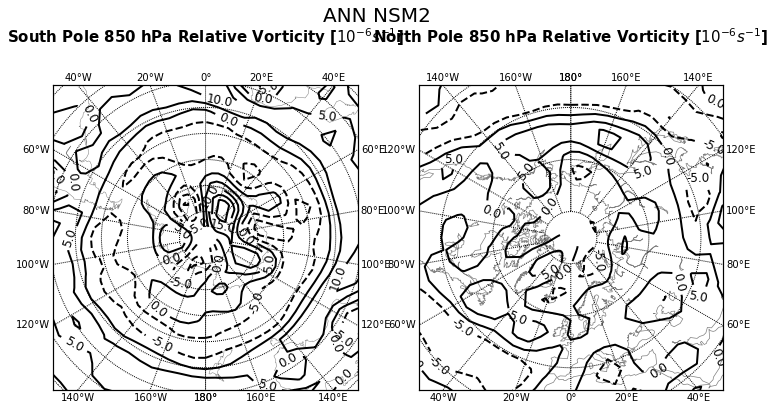

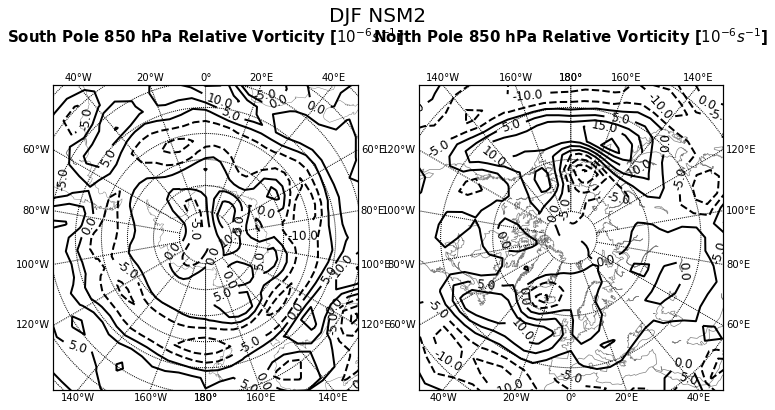

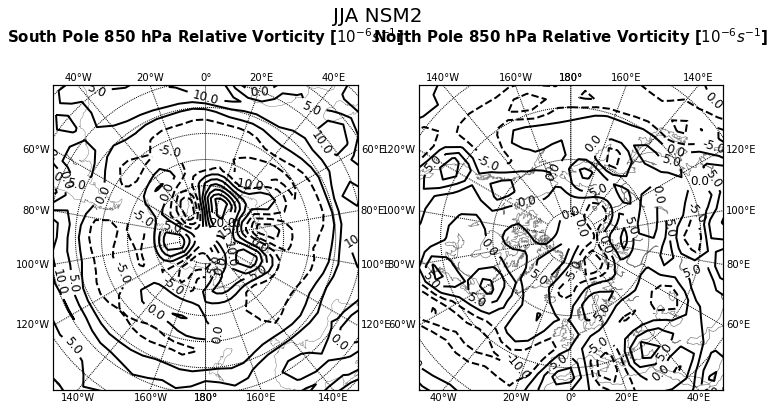

In [26]:
var="zeta"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][0]*pow(10,6)
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][0]*pow(10,6)
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][0]*pow(10,6)
print(np.min([data_ann,data_djf,data_jja]),np.max([data_ann,data_djf,data_jja]))
mn=-30
mx=30
pole_graph("ANN "+name_simulation,data_ann,r"850 hPa Relative Vorticity [$10^{-6} s^{-1}$]",8,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,r"850 hPa Relative Vorticity [$10^{-6} s^{-1}$]",10,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,r"850 hPa Relative Vorticity [$10^{-6} s^{-1}$]",10,"k",lats,lons)

# Vorticity 250 hPa#

-28.451147954910994 30.222610803321004


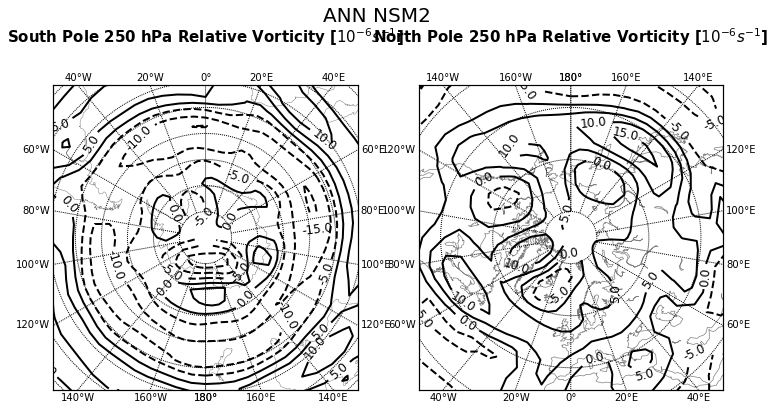

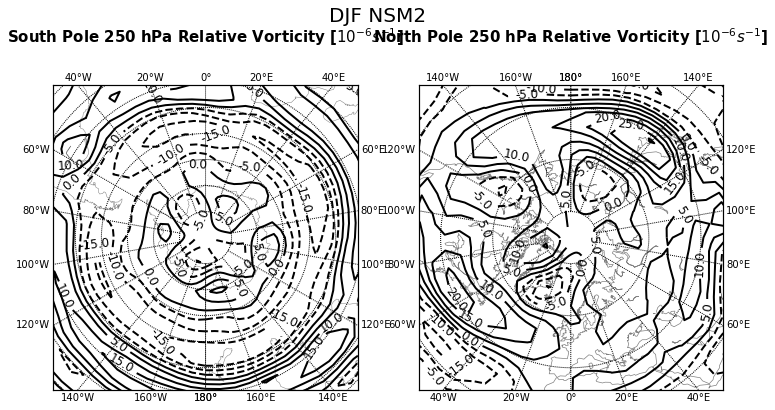

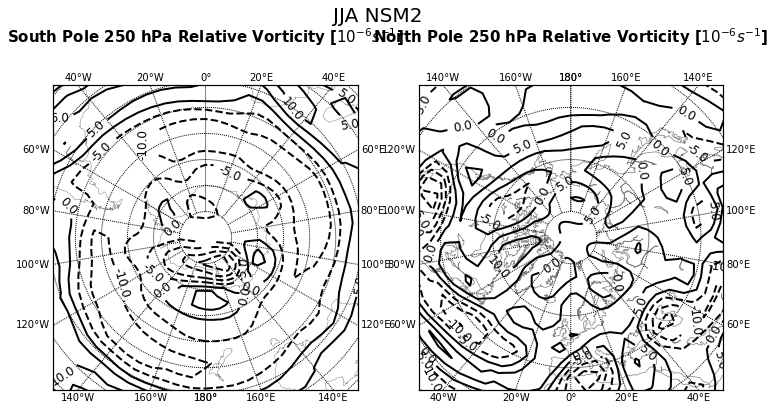

In [27]:
var="zeta"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]*pow(10,6)
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]*pow(10,6)
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][3]*pow(10,6)
print(np.min([data_ann,data_djf,data_jja]),np.max([data_ann,data_djf,data_jja]))
mn=-30
mx=30
pole_graph("ANN "+name_simulation,data_ann,"250 hPa Relative Vorticity [$10^{-6} s^{-1}$]",8,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,"250 hPa Relative Vorticity [$10^{-6} s^{-1}$]",12,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,"250 hPa Relative Vorticity [$10^{-6} s^{-1}$]",8,"k",lats,lons)

# TA #

Mean level 1000 hPa: 13.894 °C
Mean level 850 hPa: 6.416 °C
Mean level 700 hPa: -1.209 °C
Mean level 500 hPa: -14.887 °C
Mean level 400 hPa: -24.529 °C
Mean level 300 hPa: -36.867 °C
Mean level 250 hPa: -43.987 °C
Mean level 200 hPa: -51.182 °C
Mean level 150 hPa: -58.649 °C
Mean level 100 hPa: -61.781 °C
Mean level 70 hPa: -58.953 °C
Mean level 50 hPa: -56.970 °C
Mean level 30 hPa: -54.988 °C


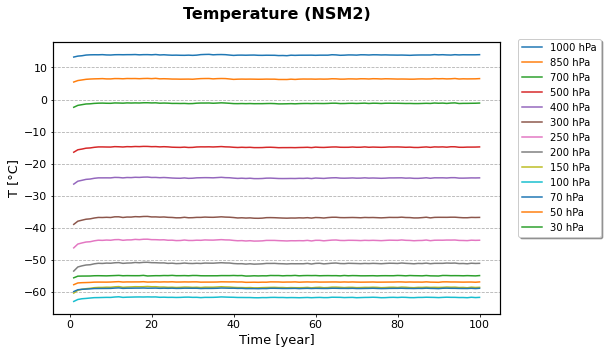

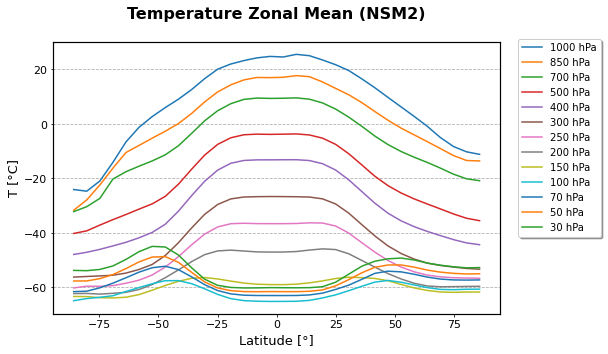

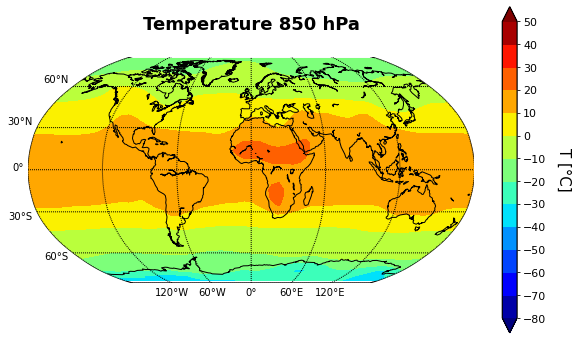

True


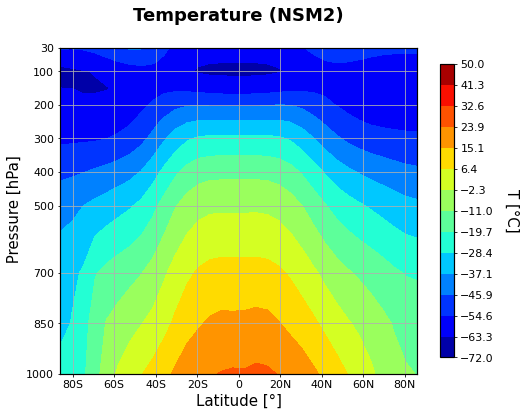

In [28]:
var="ta"
ta=lev_variable(var,1,press,var_dic[var][0],simulation,
        var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],contourf=True,vmn=-72,vmx=50)

ta_global=ta.global_annual_mean_level()

ta_zonal=ta.zonal_mean_level()

#ta_annual_cycle=ta.annual_cycle_level() /////It takes too long

ta.global_vision_level()

ta.graph_level()

# Temperature 850 hPa #

In [29]:
help(pole_graph)

Help on function pole_graph in module __main__:

pole_graph(name_simulation, data, ylabel, step, color, lats, lons, path=None, contourf=False, mn=None, mx=None, fm='%1.1f', cost=1, save=False)



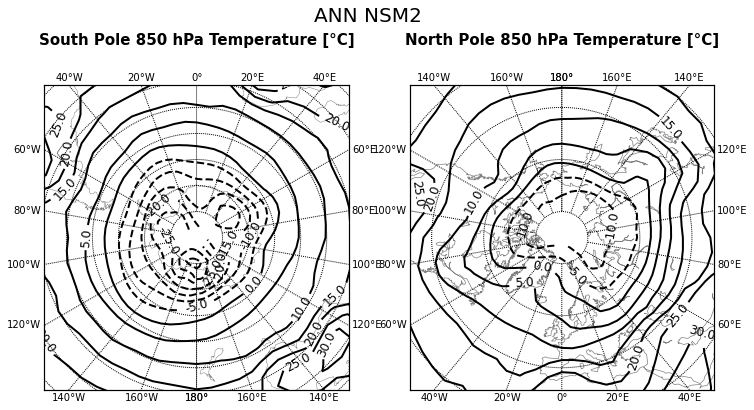

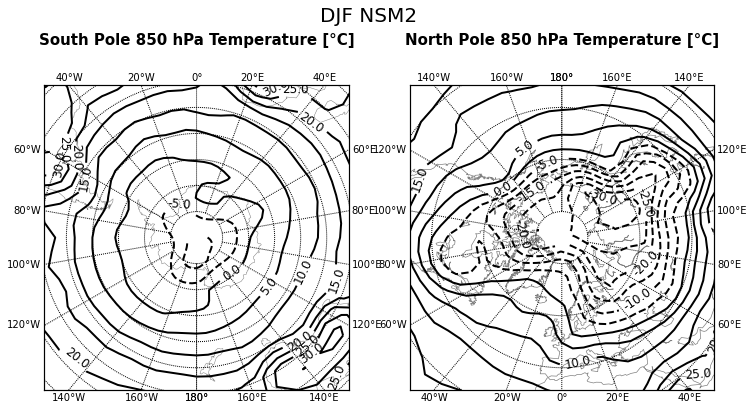

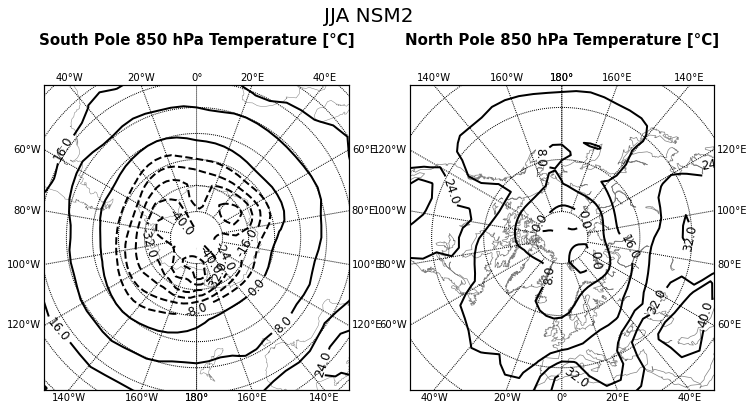

In [30]:
var="ta"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][0]
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][0]
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][0]

pole_graph("ANN "+name_simulation,data_ann,"850 hPa Temperature [°C]",15,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,"850 hPa Temperature [°C]",15,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,"850 hPa Temperature [°C]",15,"k",lats,lons)

# Temperature 250 hPa #

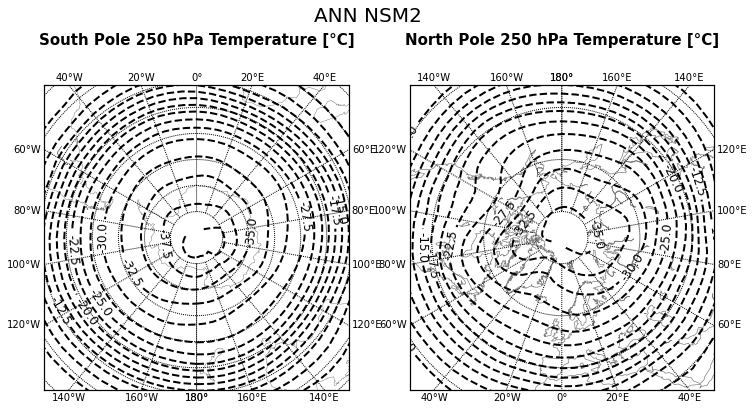

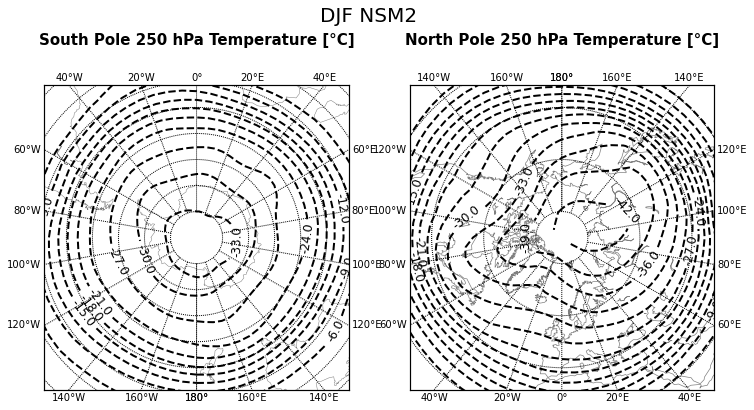

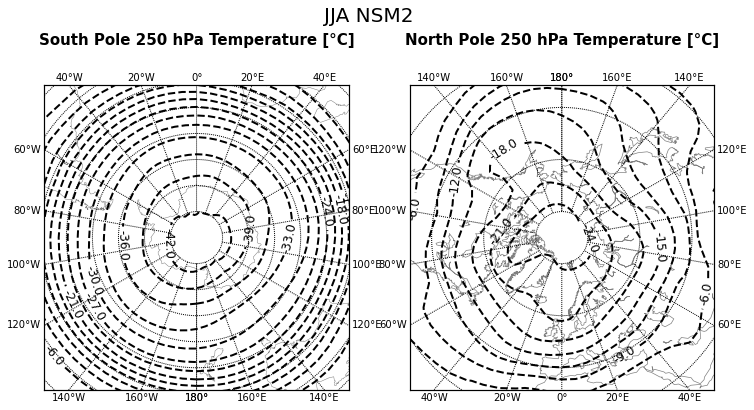

In [31]:
var="ta"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][3]
mn=mx=0
pole_graph("ANN "+name_simulation,data_ann,"250 hPa Temperature [°C]",15,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,"250 hPa Temperature [°C]",15,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,"250 hPa Temperature [°C]",15,"k",lats,lons)

# TAS #

Mean 70-100: 14.18836 dev.std: 0.00929 °C
Global Mean: 14.182 °C
Mean over Land with 0.5 as threshold: 11.377 °C 
Mean over Ocean with 0.5 as threshold: 15.319 °C
Mean over Antarctica with 0.5 as threshold: -31.537 °C
Land part 382.13311, Ocean Part 942.63316


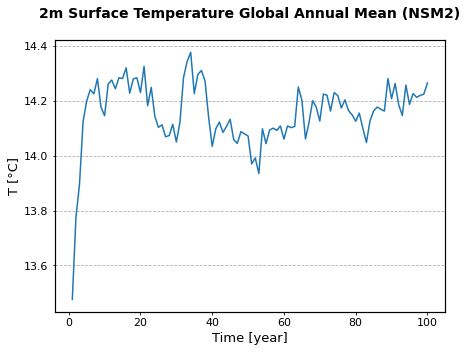

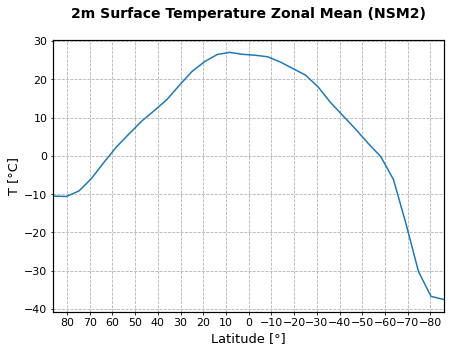

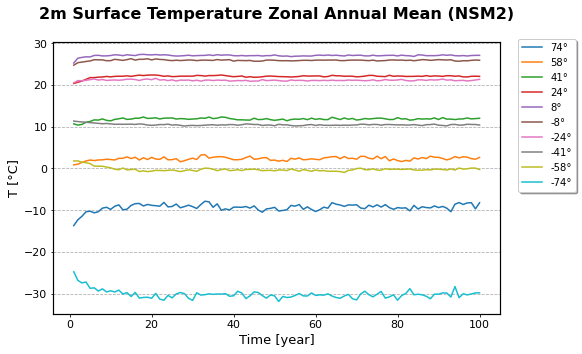

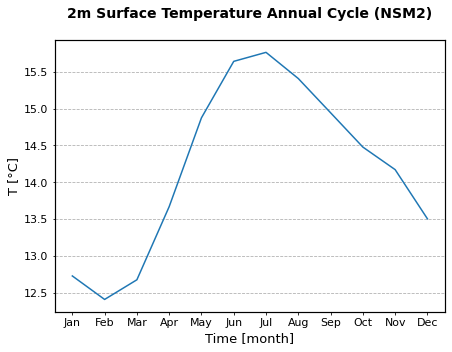

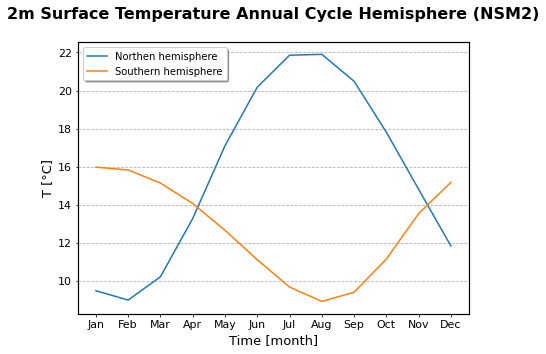

...

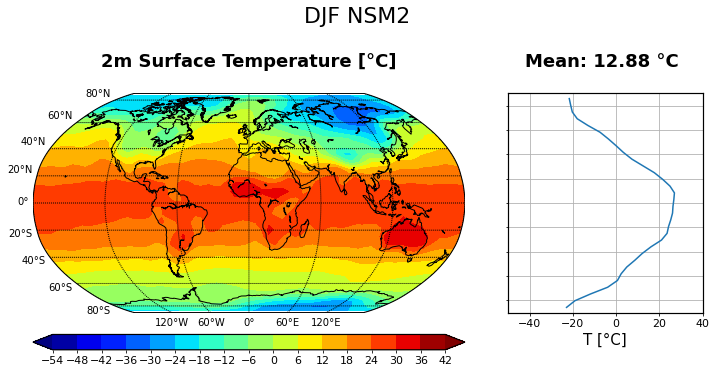

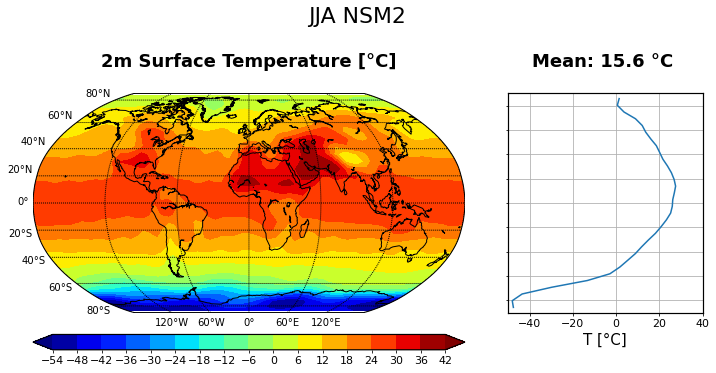

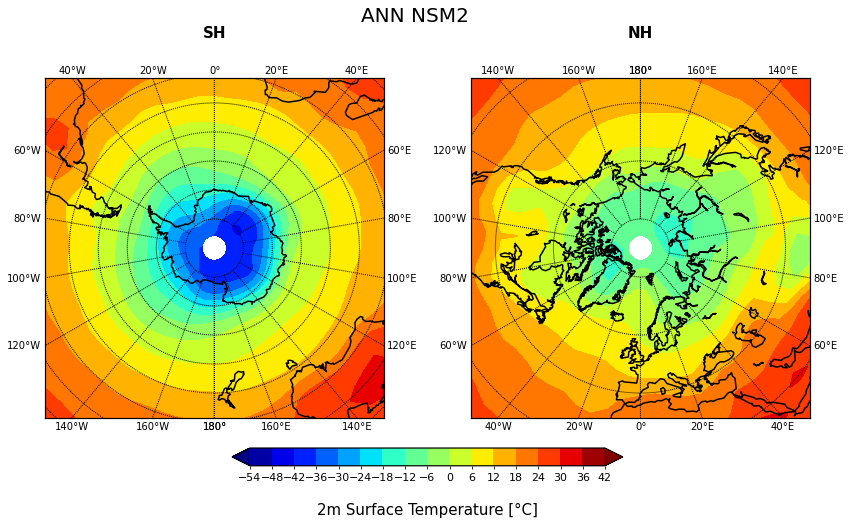

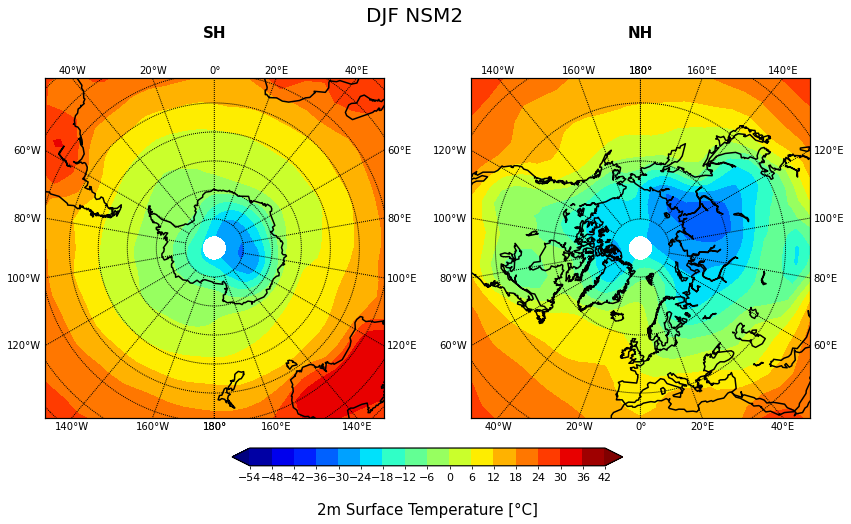

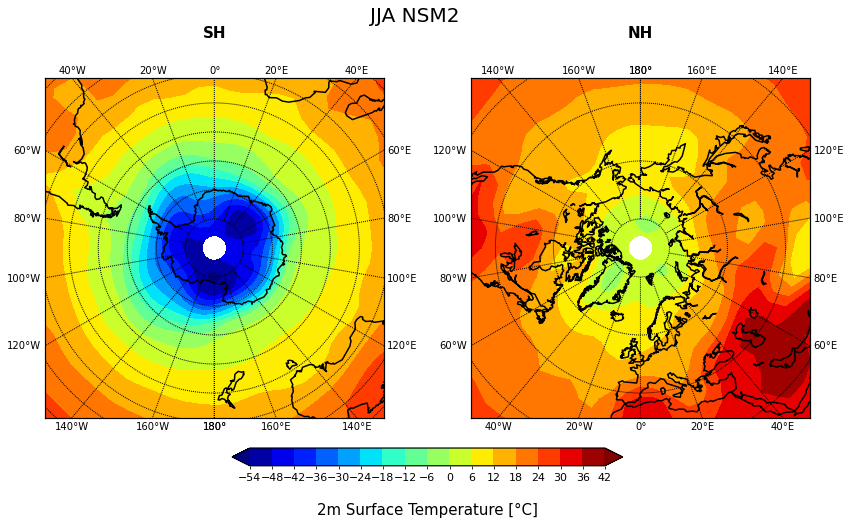

In [32]:
var="tas"
tas=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-50,vmx=40,save=True)

tas_annual=tas.global_annual_mean()

tas_zonal=tas.zonal_mean()

tas_zonal_annual=tas.zonal_annual_mean()

tas_annual_cycle=tas.annual_cycle()

tas.annual_cycle_hemisphere()

tas_global=tas.global_vision()

tas.global_and_zonal()

tas.polar()

# TS #

Mean 70-100: 15.05996 dev.std: 0.01021 °C
Global Mean: 15.053 °C
Mean over Land with 0.5 as threshold: 10.484 °C 
Mean over Ocean with 0.5 as threshold: 16.905 °C
Mean over Antarctica with 0.5 as threshold: -41.417 °C
Land part 382.13311, Ocean Part 942.63316


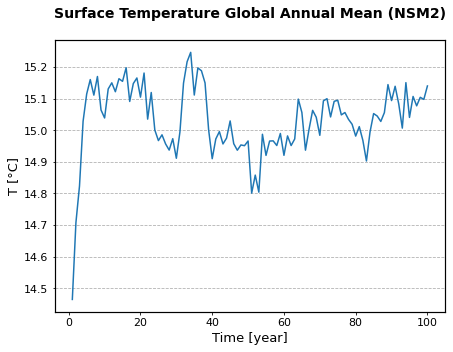

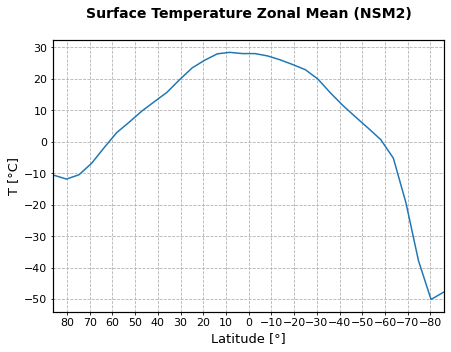

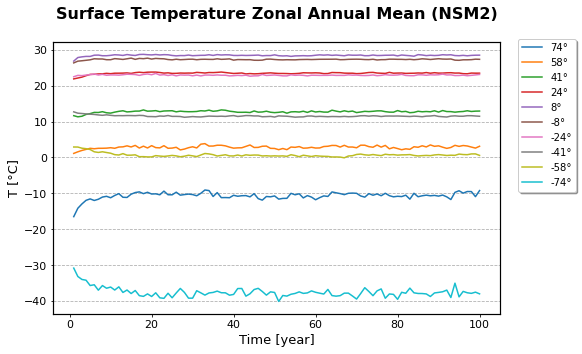

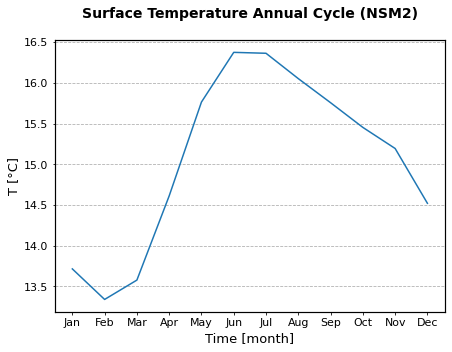

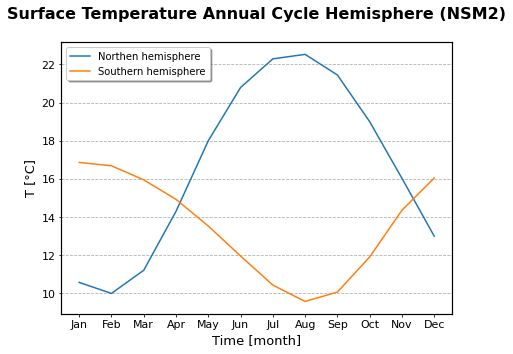

...

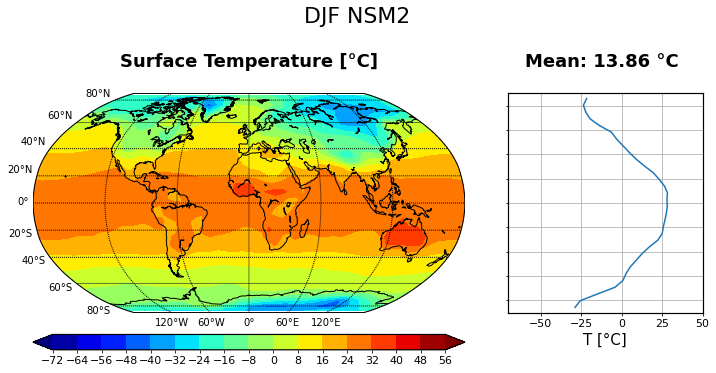

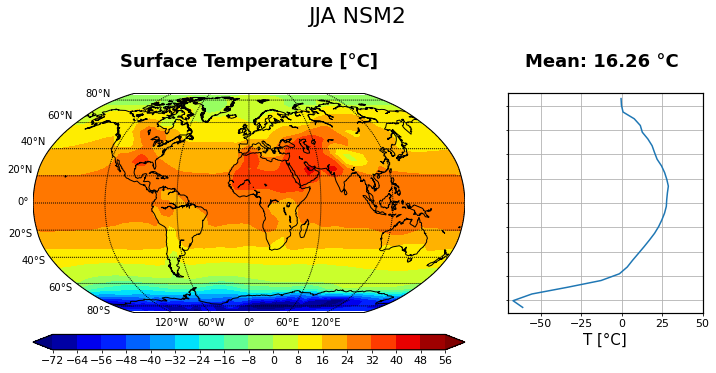

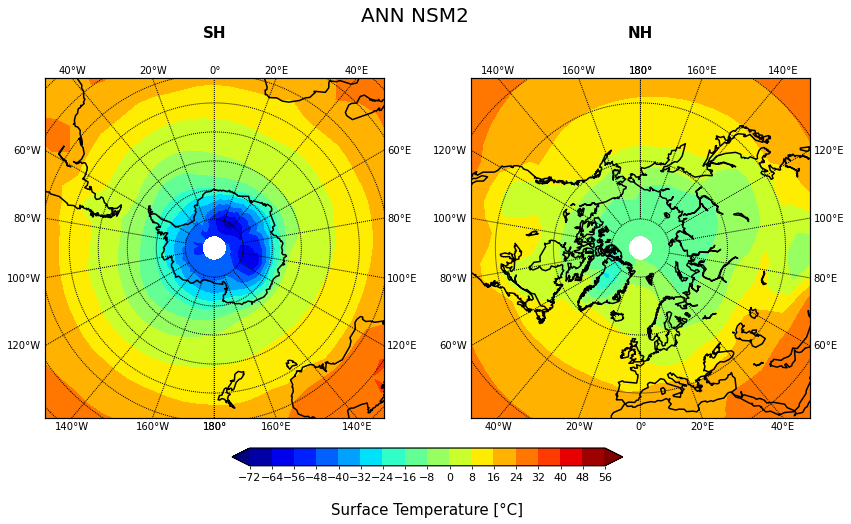

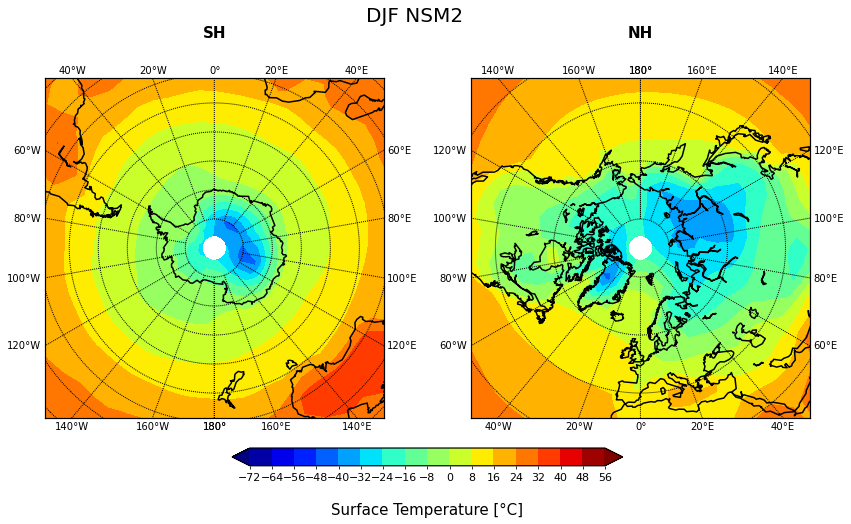

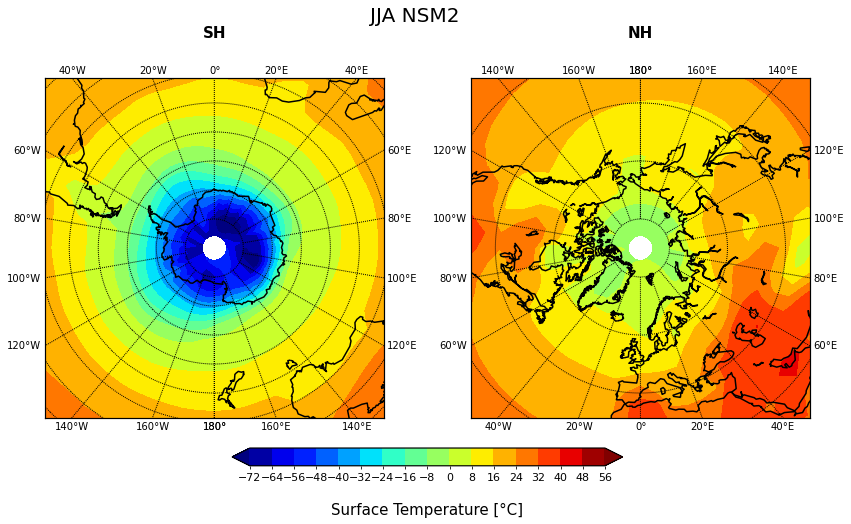

In [33]:
var="ts"
ts=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-70,vmx=50,save=True)

ts_annual=ts.global_annual_mean()

ts_zonal=ts.zonal_mean()

ts_zonal_annual=ts.zonal_annual_mean()

ts_annual_cycle=ts.annual_cycle()

ts.annual_cycle_hemisphere()

ts_global=ts.global_vision()

ts.global_and_zonal()

ts.polar()

# TSO #

Mean 70-100: 10.53495 dev.std: 0.02179 °C
Global Mean:   nan °C
Mean over Land with 0.5 as threshold: 10.533 °C 
Mean over Ocean with 0.5 as threshold:   nan °C
Mean over Antarctica with 0.5 as threshold: -41.370 °C
Land part 382.13311, Ocean Part 942.63316


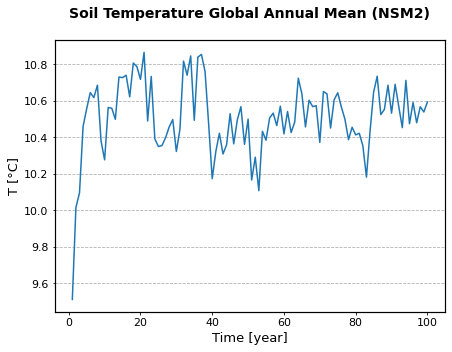

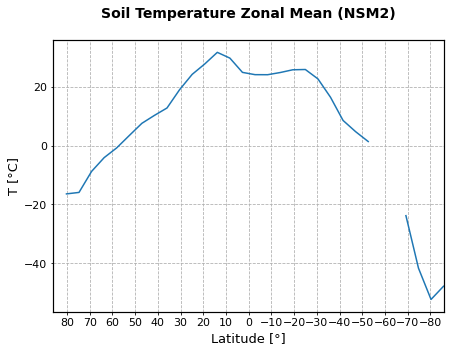

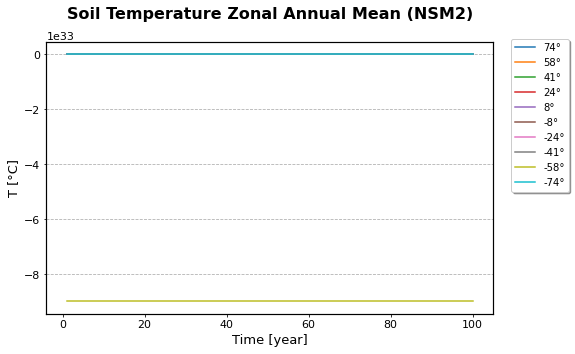

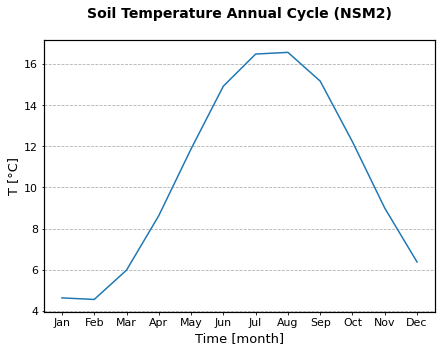

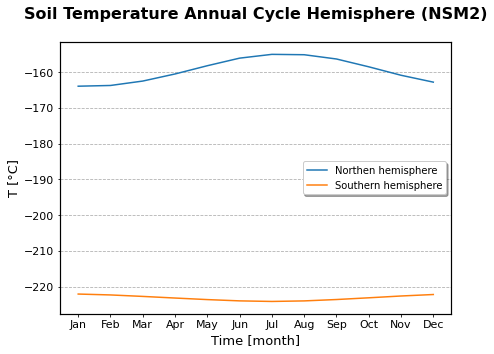

...

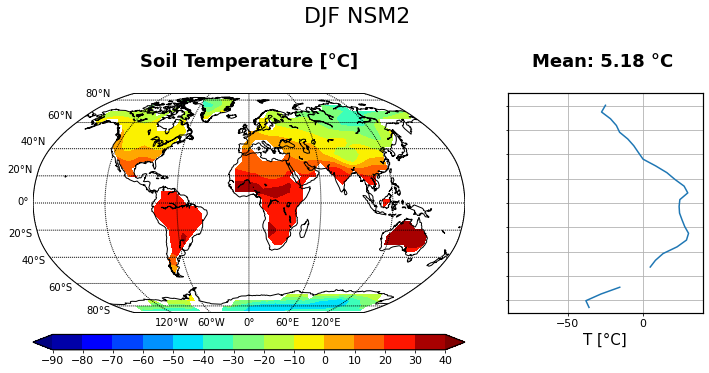

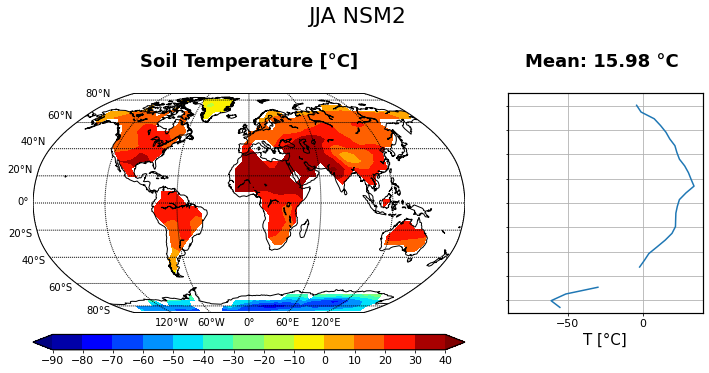

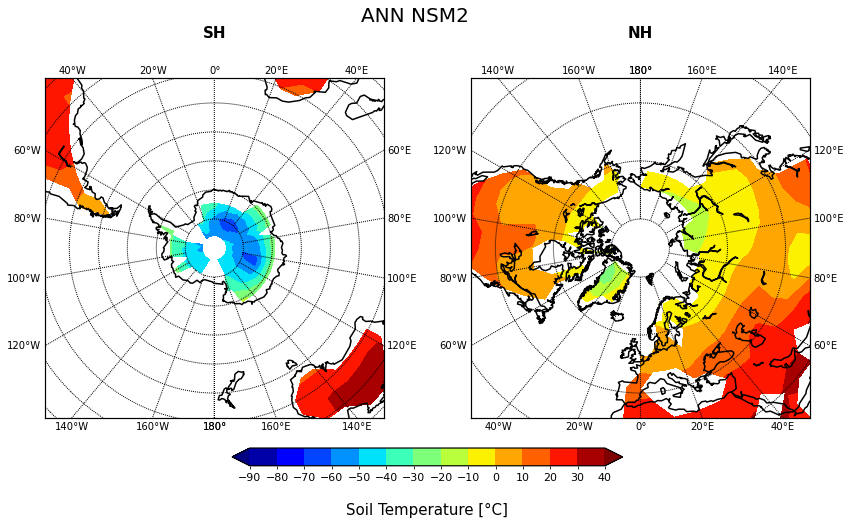

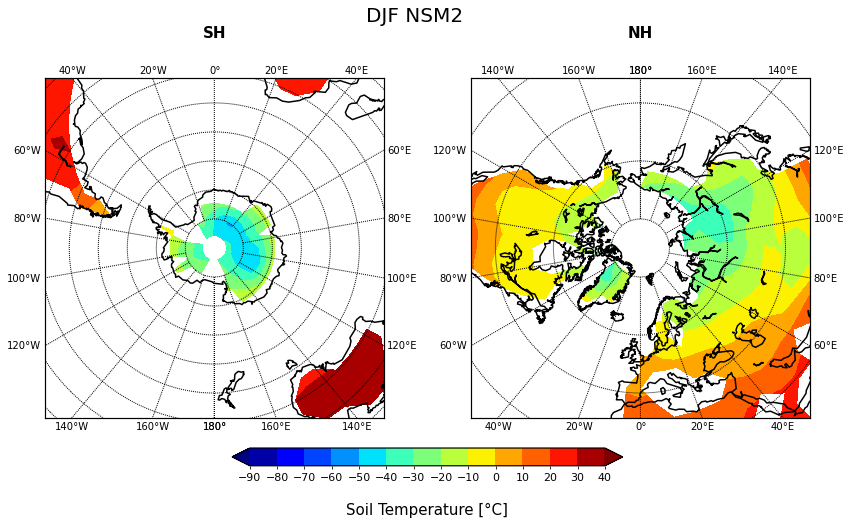

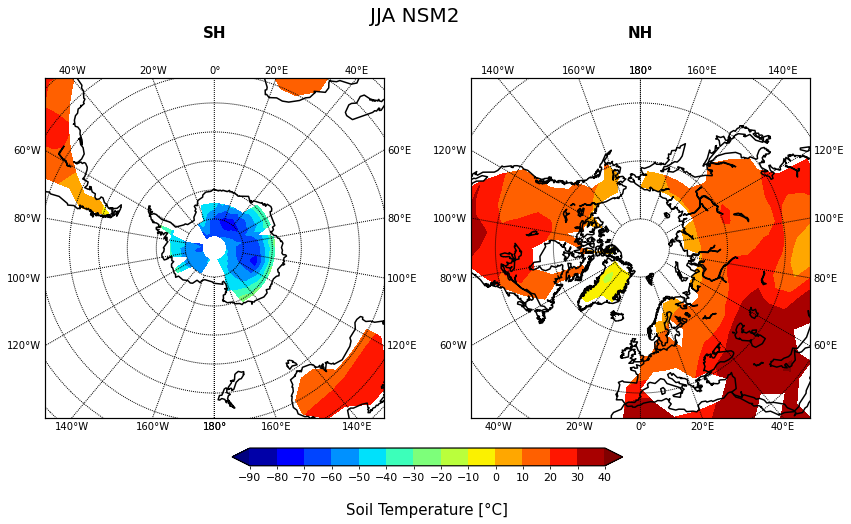

In [34]:
var="tso"
tso=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-90,vmx=40,save=True)

tso_annual=tso.global_annual_mean()

tso_zonal=tso.zonal_mean()

tso_zonal_annual=tso.zonal_annual_mean()

tso_annual_cycle=tso.annual_cycle()

tso.annual_cycle_hemisphere()

tso_global=tso.global_vision()

tso.global_and_zonal()

tso.polar()

# V#

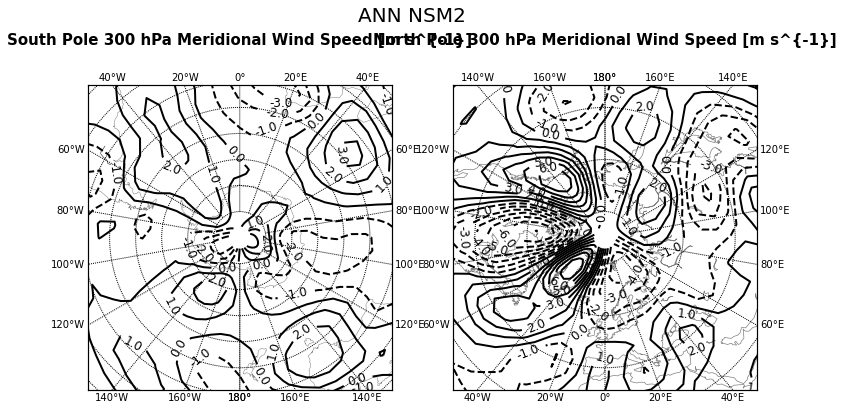

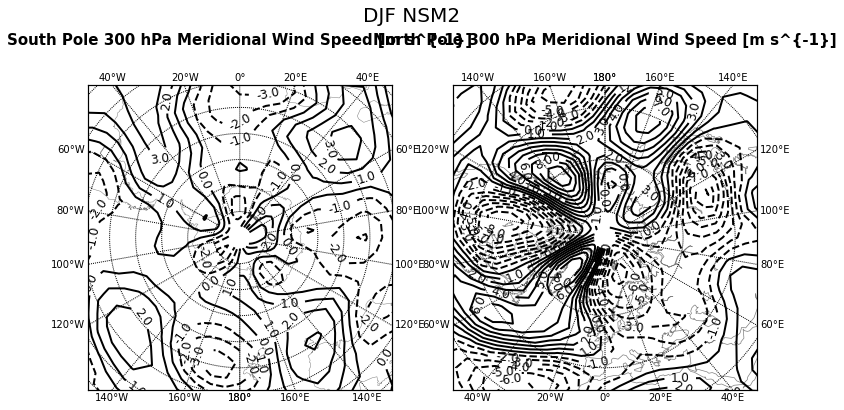

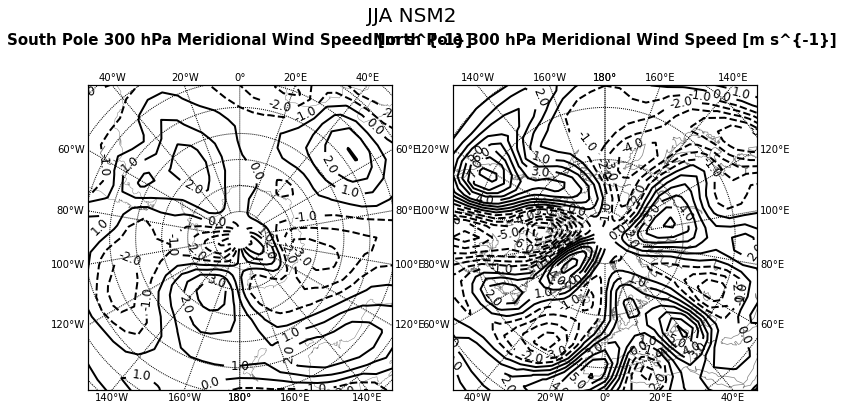

In [35]:
var="v"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][2]
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][2]
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][2]
mn=mx=0
pole_graph("ANN "+name_simulation,data_ann,"300 hPa Meridional Wind Speed [m s^{-1}]",15,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,"300 hPa Meridional Wind Speed [m s^{-1}]",20,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,"300 hPa Meridional Wind Speed [m s^{-1}]",18,"k",lats,lons)

# U #

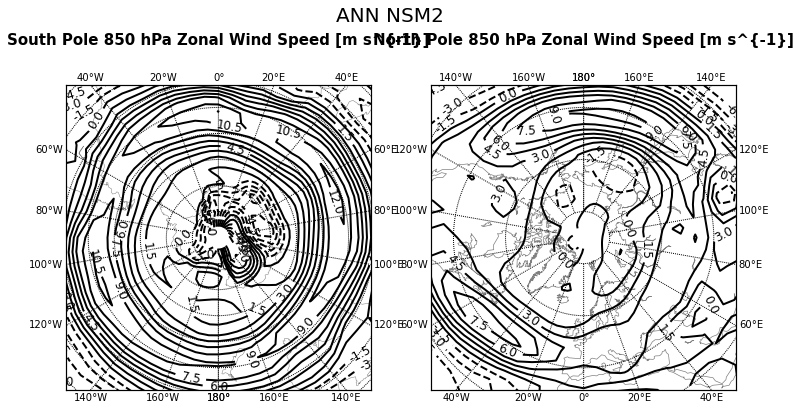

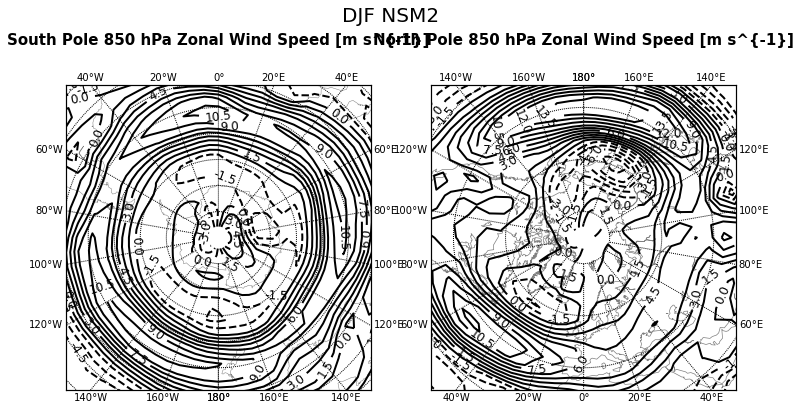

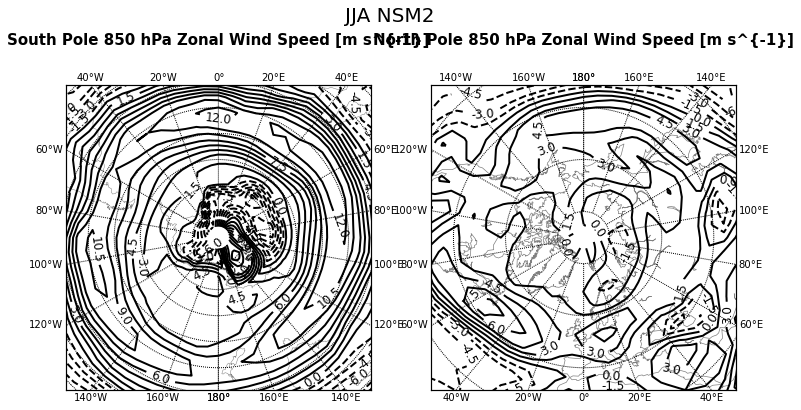

In [36]:
var="u"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][0]
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][0]
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][0]
mn=mx=0
pole_graph("ANN "+name_simulation,data_ann,"850 hPa Zonal Wind Speed [m s^{-1}]",15,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,"850 hPa Zonal Wind Speed [m s^{-1}]",20,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,"850 hPa Zonal Wind Speed [m s^{-1}]",18,"k",lats,lons)

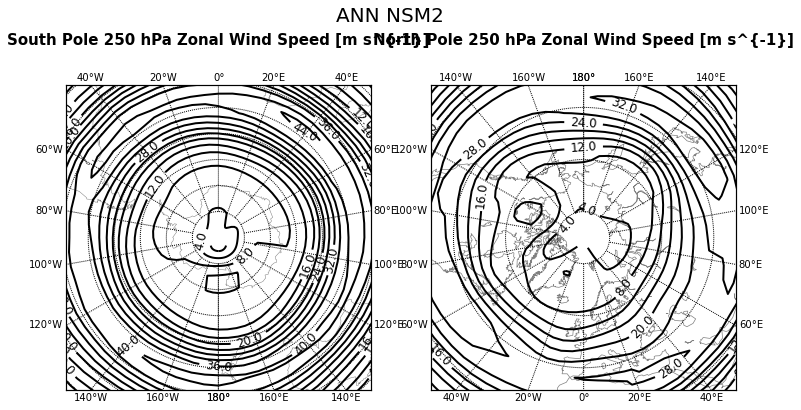

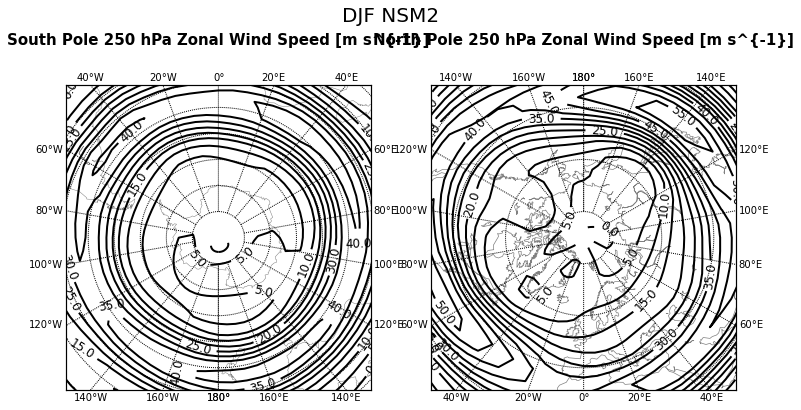

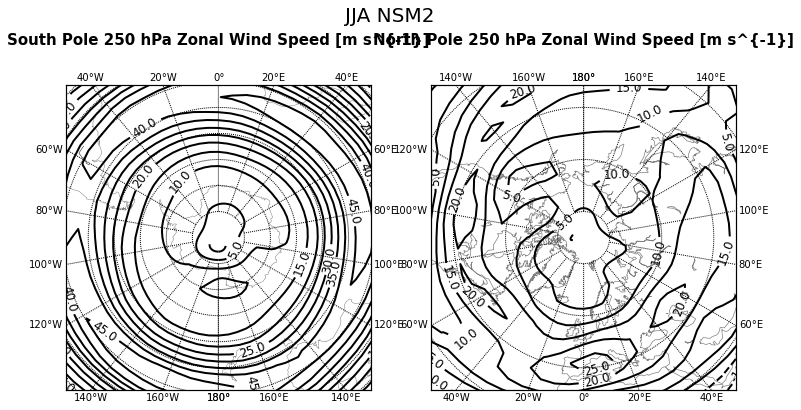

In [37]:
var="u"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][2][3]
mn=mx=0
pole_graph("ANN "+name_simulation,data_ann,"250 hPa Zonal Wind Speed [m s^{-1}]",15,"k",lats,lons)
pole_graph("DJF "+name_simulation,data_djf,"250 hPa Zonal Wind Speed [m s^{-1}]",15,"k",lats,lons)
pole_graph("JJA "+name_simulation,data_jja,"250 hPa Zonal Wind Speed [m s^{-1}]",15,"k",lats,lons)

Mean level 1000 hPa: -0.686 m s^-1
Mean level 850 hPa: 0.818 m s^-1
Mean level 700 hPa: 3.565 m s^-1
Mean level 500 hPa: 8.170 m s^-1
Mean level 400 hPa: 11.173 m s^-1
Mean level 300 hPa: 14.679 m s^-1
Mean level 250 hPa: 16.255 m s^-1
Mean level 200 hPa: 17.439 m s^-1
Mean level 150 hPa: 17.277 m s^-1
Mean level 100 hPa: 15.595 m s^-1
Mean level 70 hPa: 13.309 m s^-1
Mean level 50 hPa: 11.781 m s^-1
Mean level 30 hPa: 10.253 m s^-1


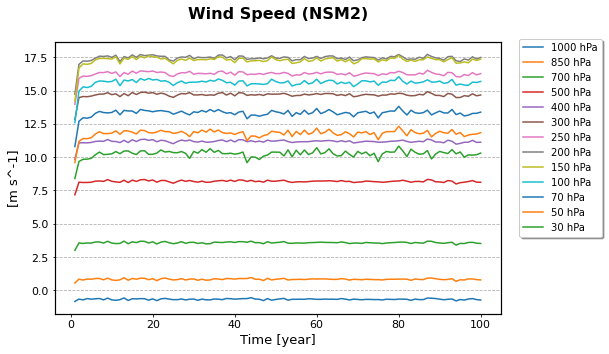

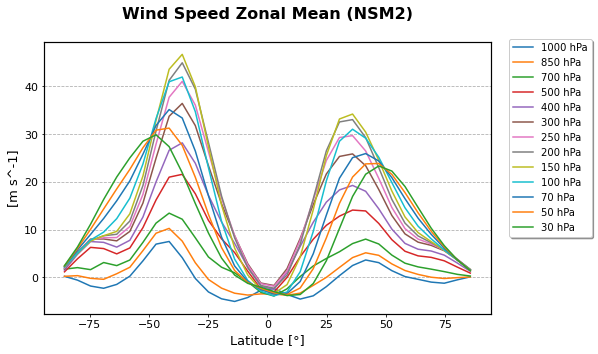

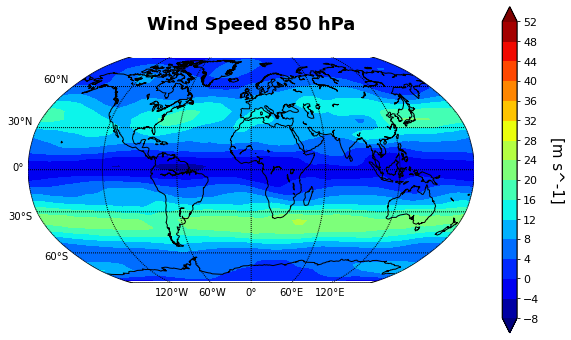

True


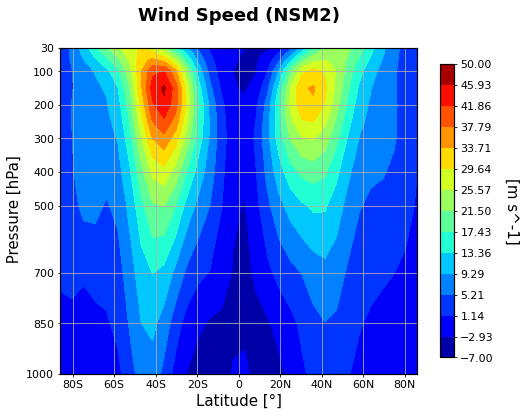

In [38]:
var="u"
u=lev_variable(var,1,press,var_dic[var][0],simulation,
        var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],contourf=True,vmn=-7,vmx=50)

u_global=u.global_annual_mean_level()

u_zonal=u.zonal_mean_level()

#u_annual_cycle=u.annual_cycle_level() /////It ukes too long

u.global_vision_level()

u.graph_level()

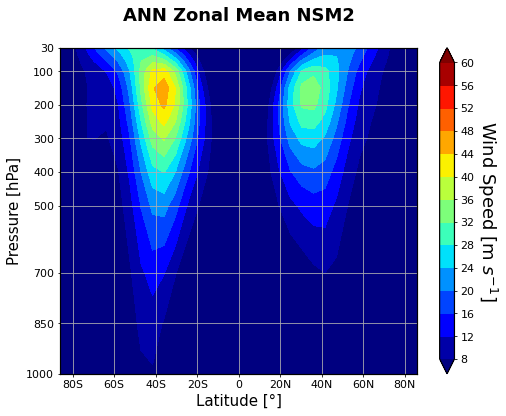

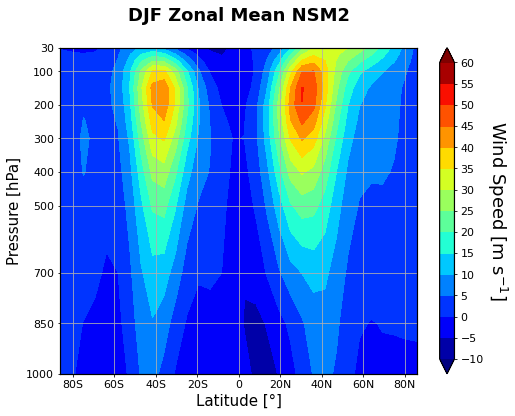

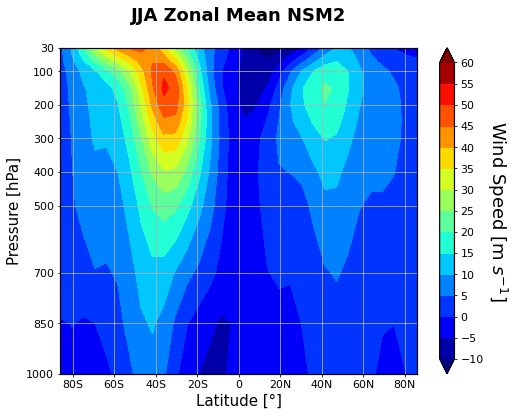

In [39]:
zonal_wind_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_ZM_"+str(simulation[1])+"Y_"+"u"+".nc","r").\
                                variables["u"][:]

zonal_wind_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_ZM_"+str(simulation[1])+"Y_"+\
                         "u"+".nc","r").variables["u"][:][0]

zonal_wind_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_ZM_"+str(simulation[1])+"Y_"+\
                         "u"+".nc","r").variables["u"][:][2]
zonal("jet",1,"ANN Zonal Mean "+name_simulation,\
      True,15,r"Wind Speed [m $s^{-1}$]",zonal_wind_ann,file_graph,location="lower right",contourf=True,vmn=10,vmx=60)
zonal("jet",1,"DJF Zonal Mean "+name_simulation,\
      True,15,r"Wind Speed [m s$^{-1}$]",zonal_wind_djf,file_graph,location="lower right",contourf=True,vmn=-10,vmx=60)
zonal("jet",1,"JJA Zonal Mean "+name_simulation,\
      True,15,r"Wind Speed [m $s^{-1}$]",zonal_wind_jja,file_graph,location="lower right",contourf=True,vmn=-10,vmx=60)

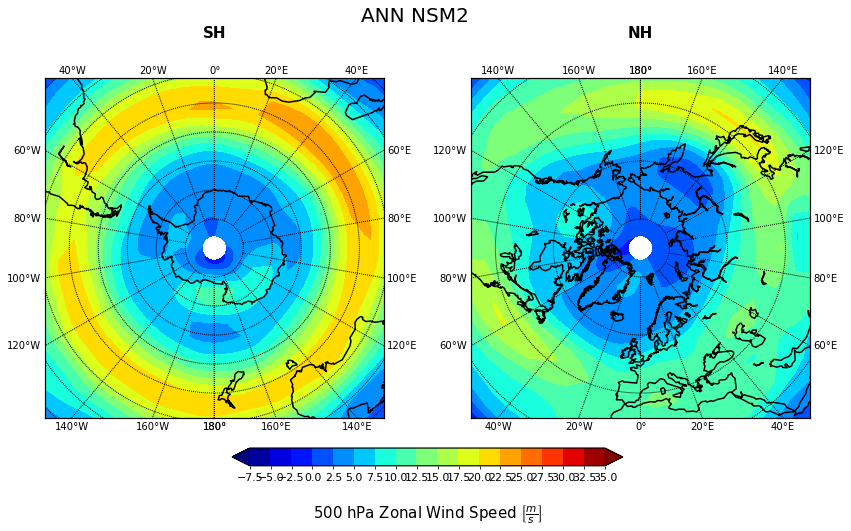

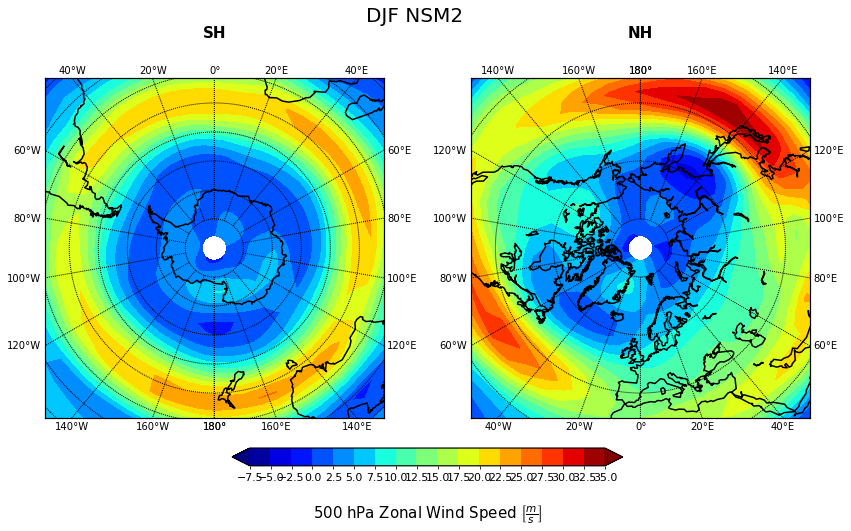

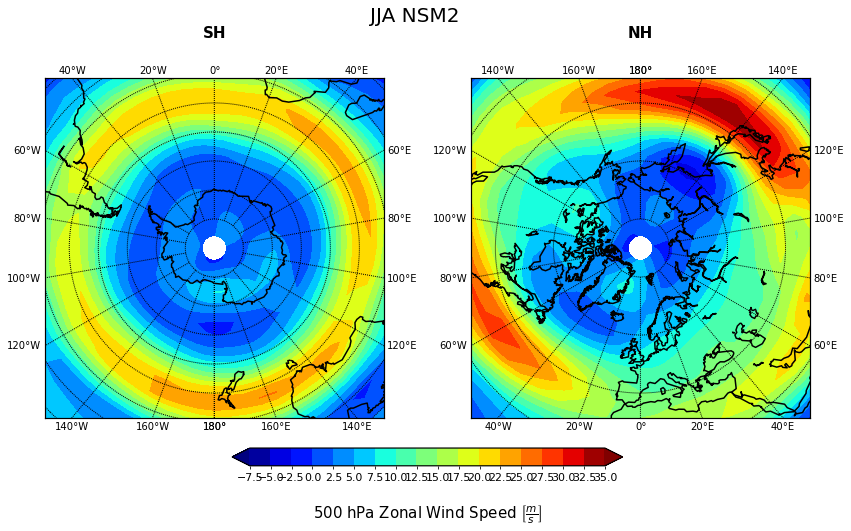

In [40]:
var="u"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][1]
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][1]
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][1]
mn=int(np.min([data_ann,data_djf,data_jja])-1)
mx=int(np.max([data_ann,data_djf,data_jja])+1)
pole_graph("ANN "+name_simulation,data_ann,r"500 hPa Zonal Wind Speed $\left[\frac{m}{s}\right]$",20,plt.cm.jet,lats,lons,contourf=True,mn=mn,mx=mx)
pole_graph("DJF "+name_simulation,data_djf,r"500 hPa Zonal Wind Speed $\left[\frac{m}{s}\right]$",20,plt.cm.jet,lats,lons,contourf=True,mn=mn,mx=mx)
pole_graph("JJA "+name_simulation,data_jja,r"500 hPa Zonal Wind Speed $\left[\frac{m}{s}\right]$",20,plt.cm.jet,lats,lons,contourf=True,mn=mn,mx=mx)

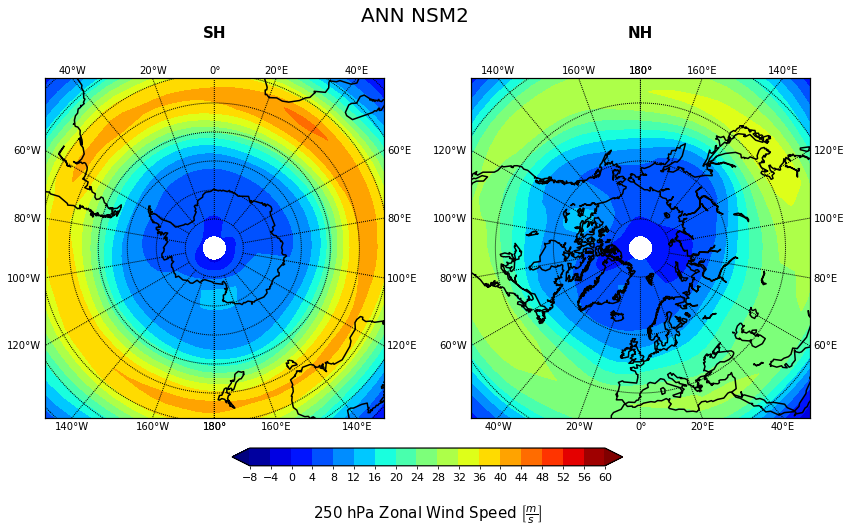

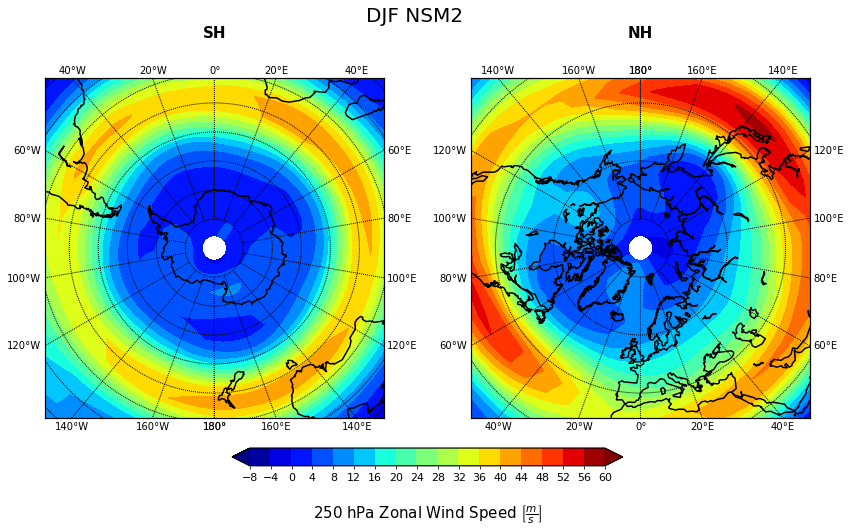

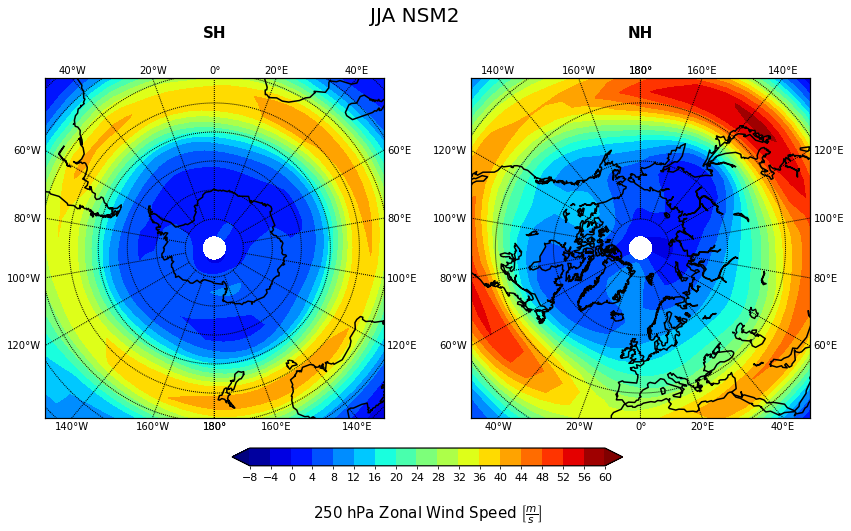

In [41]:
var="u"
data_ann=Dataset(file_analysis+simulation[0]+"_YM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]
data_djf=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]
data_jja=Dataset(file_analysis+simulation[0]+"_SM_"+str(simulation[3])+"YM_"+str(simulation[1])+"Y_"+var+".nc","r").variables[var][0][3]
mn=int(np.min([data_ann,data_djf,data_jja])-1)
mx=int(np.max([data_ann,data_djf,data_jja])+1)
pole_graph("ANN "+name_simulation,data_ann,r"250 hPa Zonal Wind Speed $\left[\frac{m}{s}\right]$",20,plt.cm.jet,lats,lons,contourf=True,mn=mn,mx=mx)
pole_graph("DJF "+name_simulation,data_djf,r"250 hPa Zonal Wind Speed $\left[\frac{m}{s}\right]$",20,plt.cm.jet,lats,lons,contourf=True,mn=mn,mx=mx)
pole_graph("JJA "+name_simulation,data_jja,r"250 hPa Zonal Wind Speed $\left[\frac{m}{s}\right]$",20,plt.cm.jet,lats,lons,contourf=True,mn=mn,mx=mx)

# RST #

Mean 70-100: 231.8911 dev.std: 0.02389 W m^-2
Global Mean: 231.855 W m^-2
Mean over Land with 0.5 as threshold: 214.083 W m^-2 
Mean over Ocean with 0.5 as threshold: 239.060 W m^-2
Mean over Antarctica with 0.5 as threshold: 59.377 W m^-2
Land part 382.13311, Ocean Part 942.63316


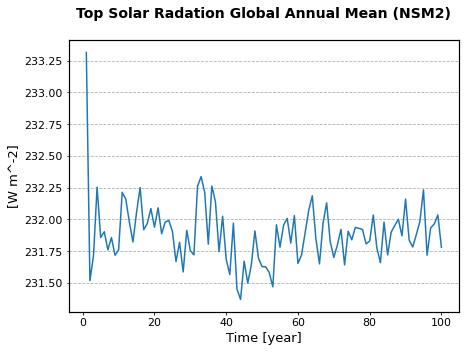

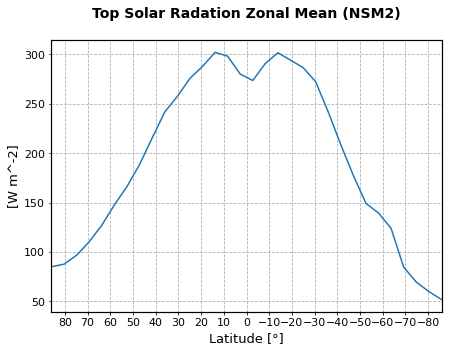

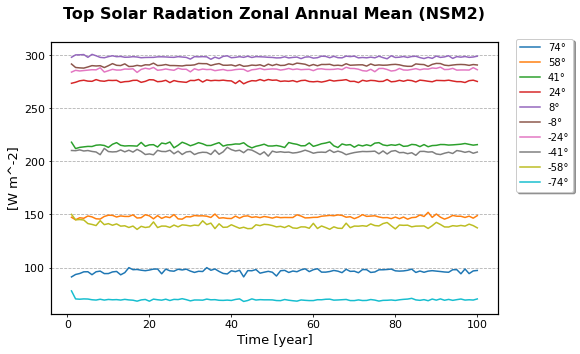

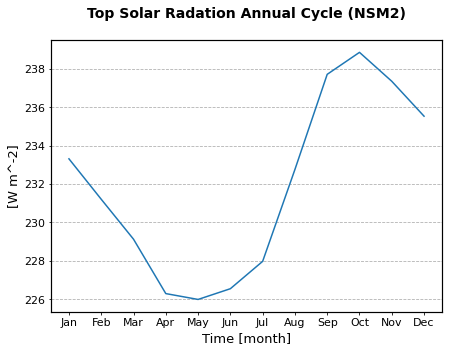

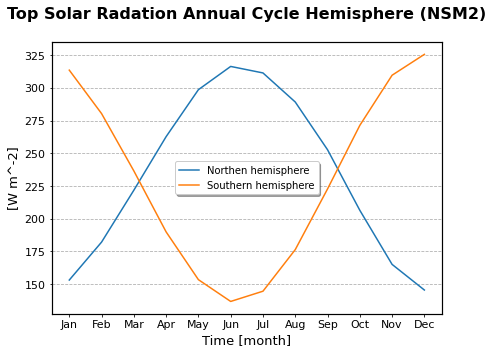

...

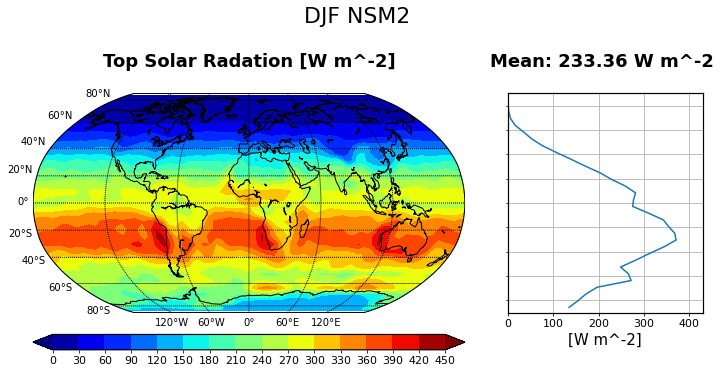

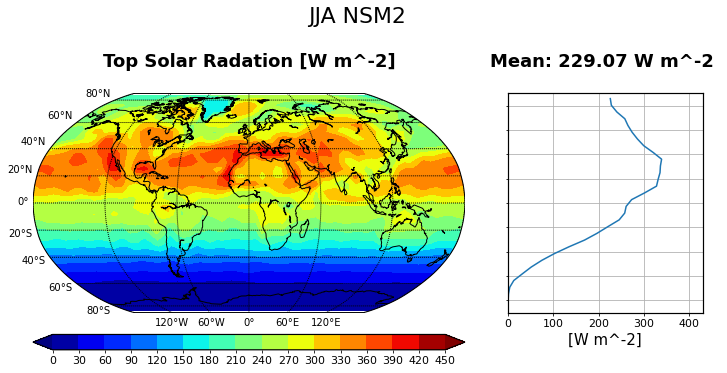

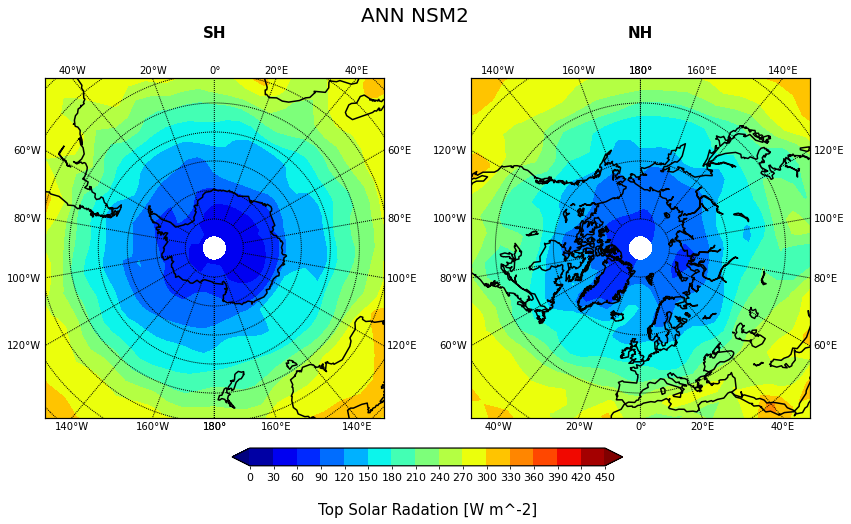

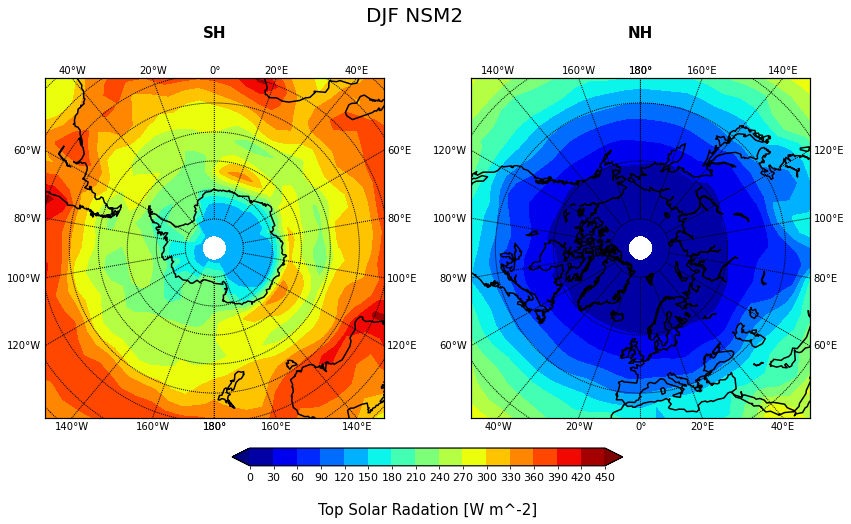

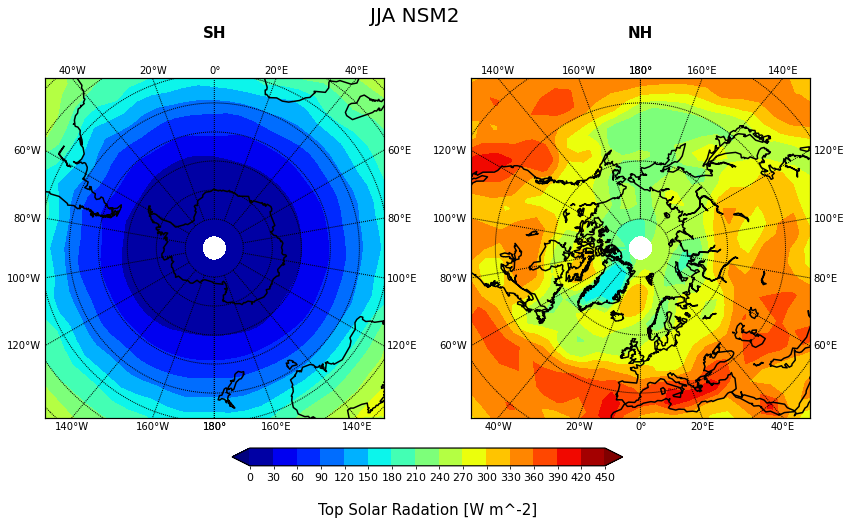

In [42]:
var="rst"
rst=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=0,vmx=430,save=True)

rst_annual=rst.global_annual_mean()

rst_zonal=rst.zonal_mean()

rst_zonal_annual=rst.zonal_annual_mean()

rst_annual_cycle=rst.annual_cycle()

rst.annual_cycle_hemisphere()

rst_global=rst.global_vision()

rst.global_and_zonal()

rst.polar()

# RLUT #

Mean 70-100: -232.65134 dev.std: 0.02419 W m^-2
Global Mean: -232.635 W m^-2
Mean over Land with 0.5 as threshold: -228.993 W m^-2 
Mean over Ocean with 0.5 as threshold: -234.112 W m^-2
Mean over Antarctica with 0.5 as threshold: -153.757 W m^-2
Land part 382.13311, Ocean Part 942.63316


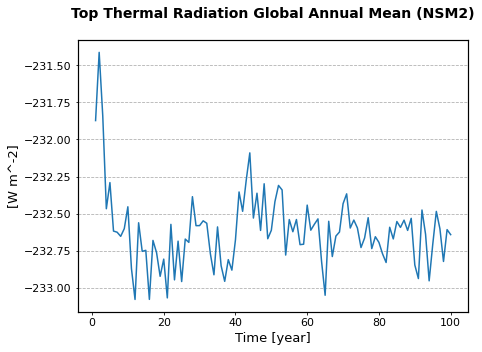

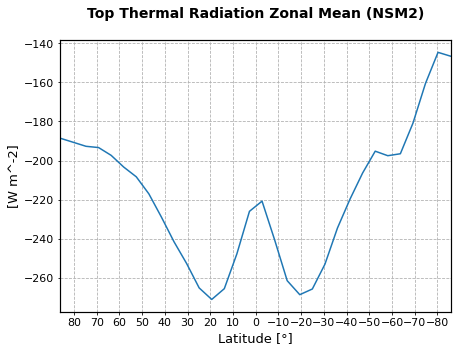

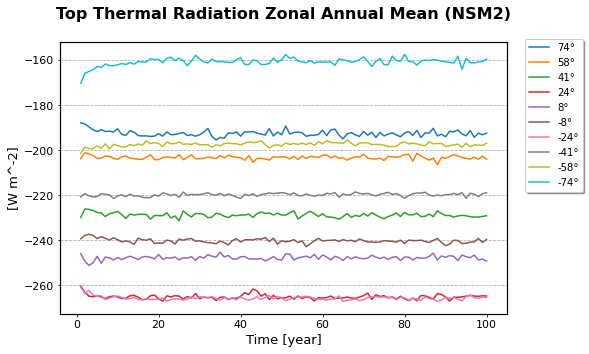

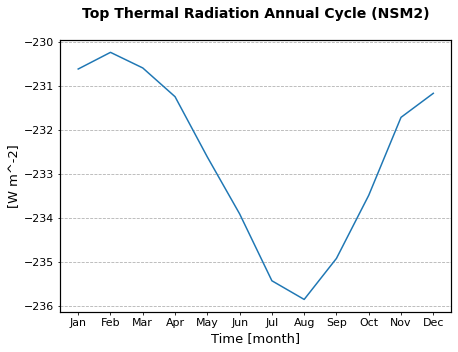

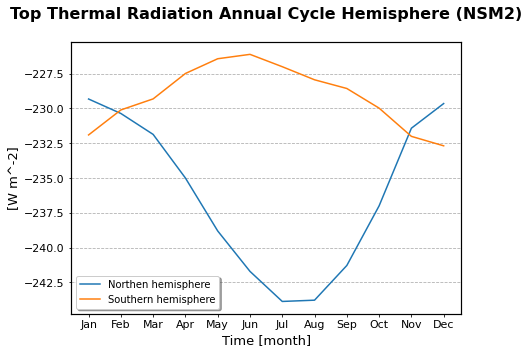

...

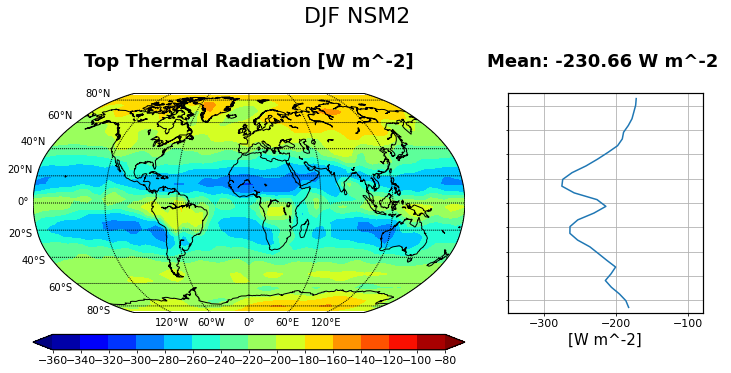

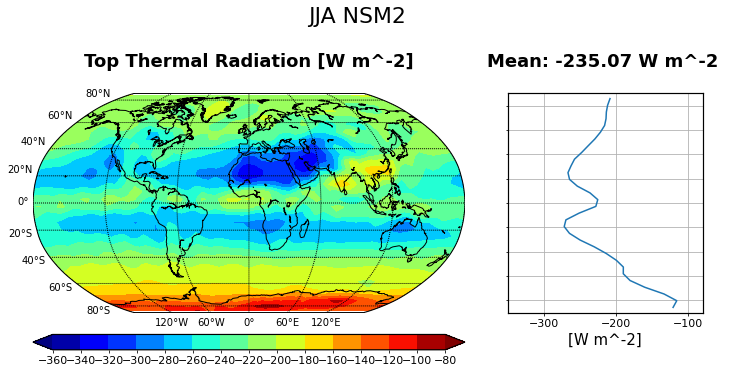

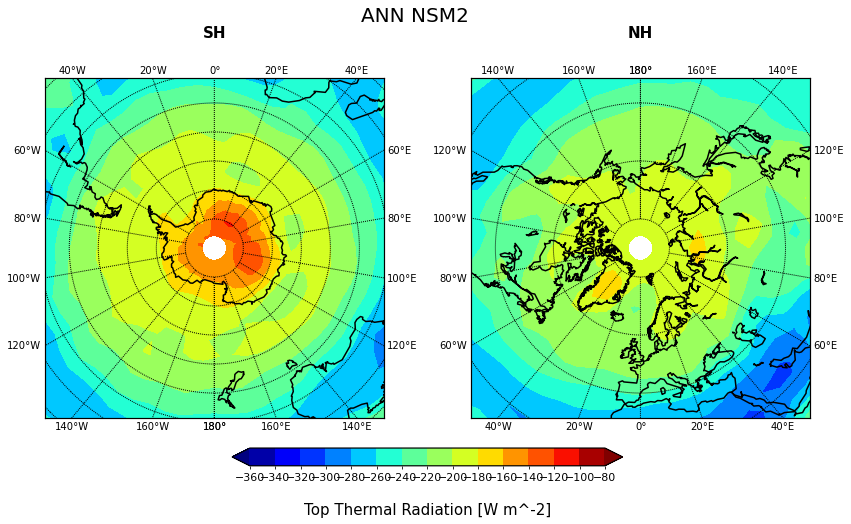

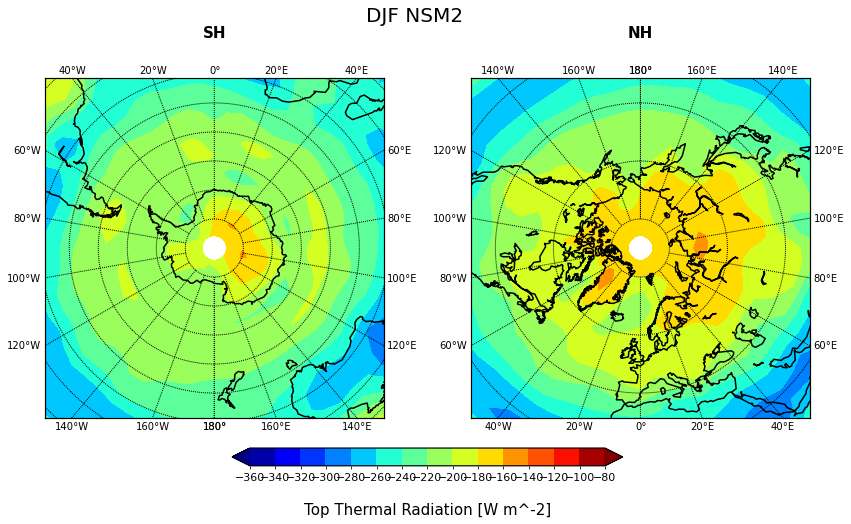

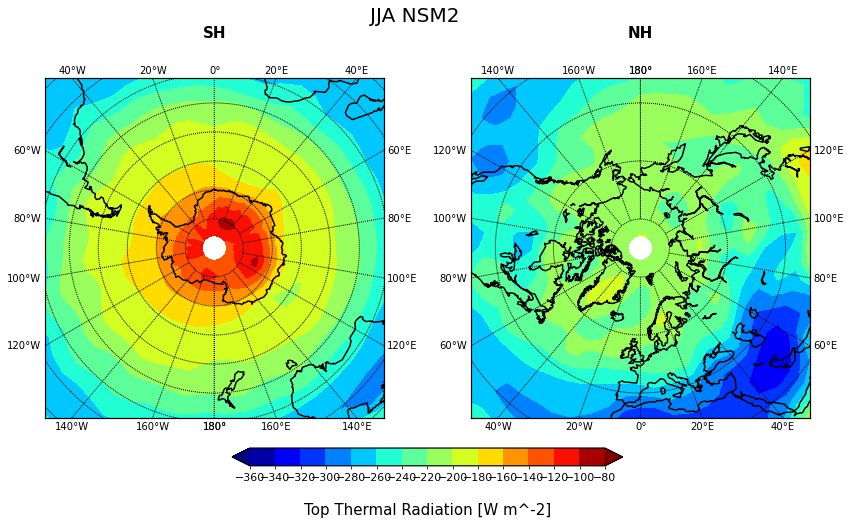

In [43]:
var="rlut"
rlut=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-350,vmx=-80,save=True)

rlut_annual=rlut.global_annual_mean()

rlut_zonal=rlut.zonal_mean()

rlut_zonal_annual=rlut.zonal_annual_mean()

rlut_annual_cycle=rlut.annual_cycle()

rlut.annual_cycle_hemisphere()

rlut_global=rlut.global_vision()

rlut.global_and_zonal()

rlut.polar()

# **CALCOLO LA RADIAZIONE NETTA IN TOA** #
 

Mean 70-100: -0.76023 dev.std: 0.0267 W m^-2
Global Mean: -0.780 W m^-2
Mean over Land with 0.5 as threshold: -14.910 W m^-2 
Mean over Ocean with 0.5 as threshold: 4.948 W m^-2
Mean over Antarctica with 0.5 as threshold: -94.380 W m^-2
Land part 382.13311, Ocean Part 942.63316


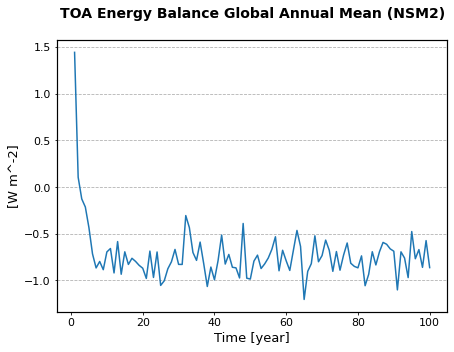

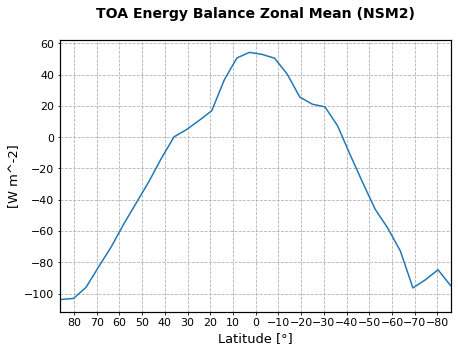

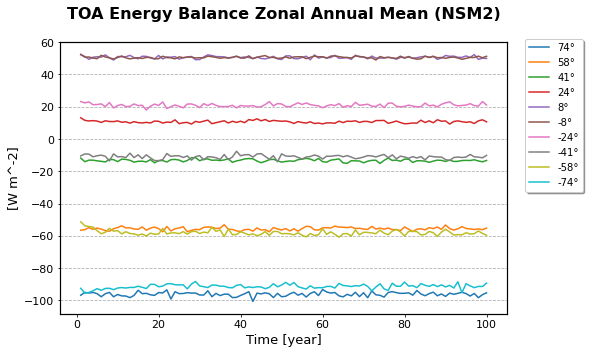

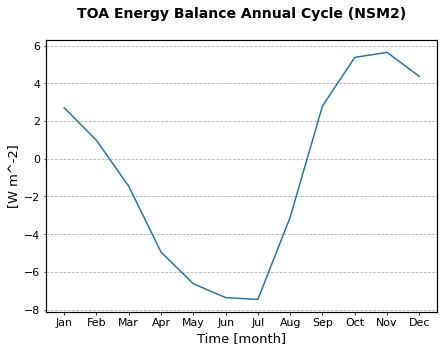

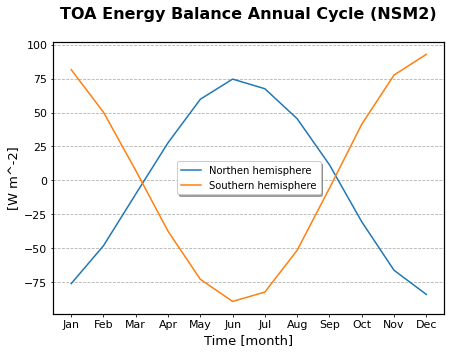

...

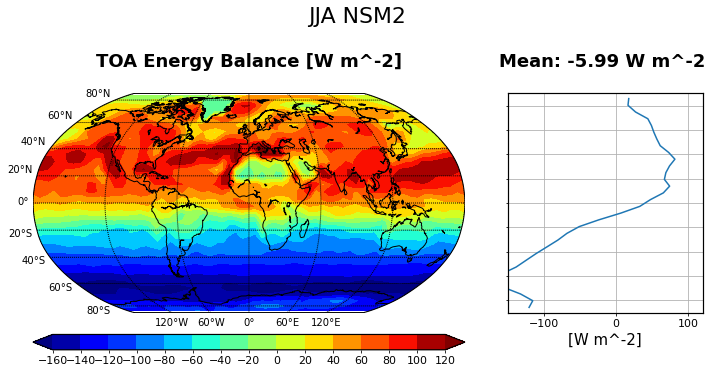

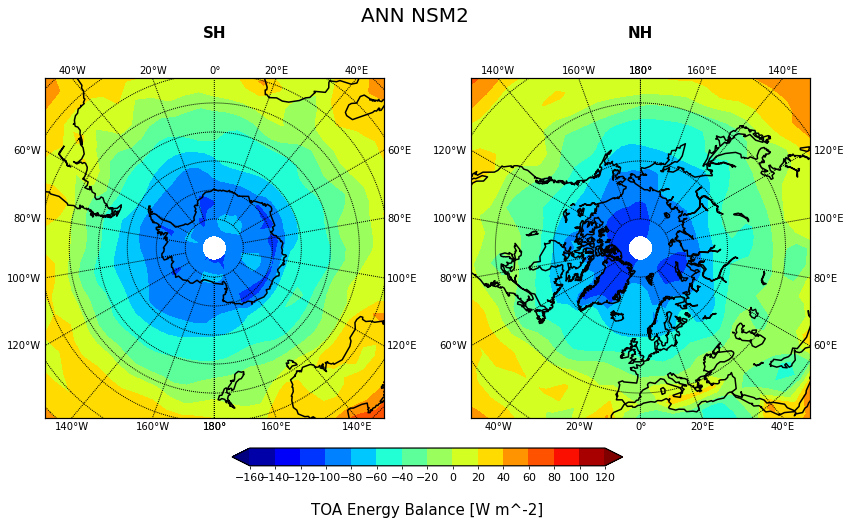

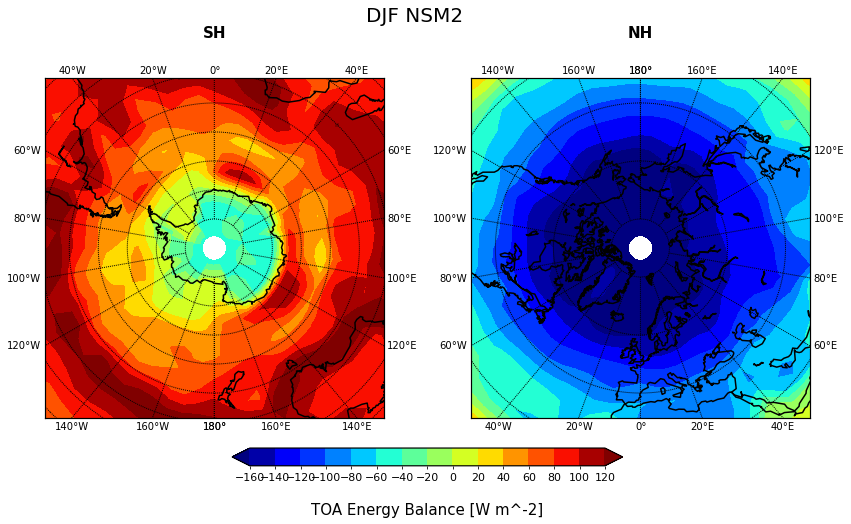

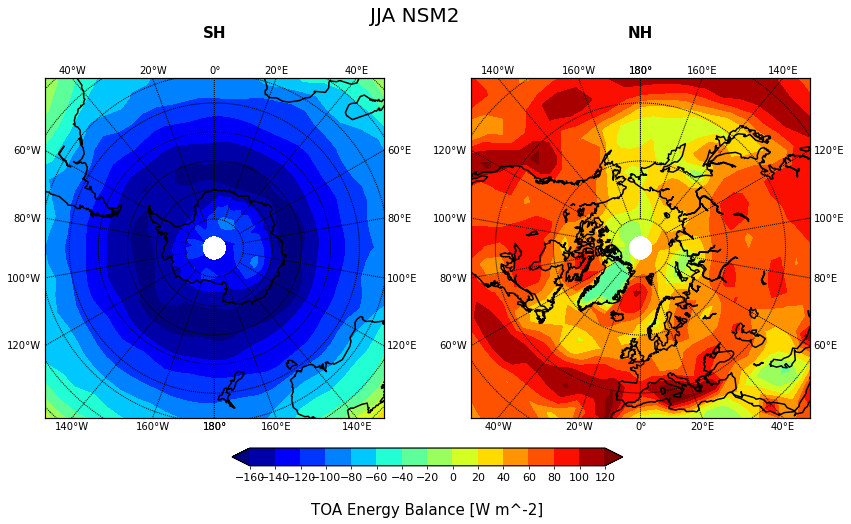

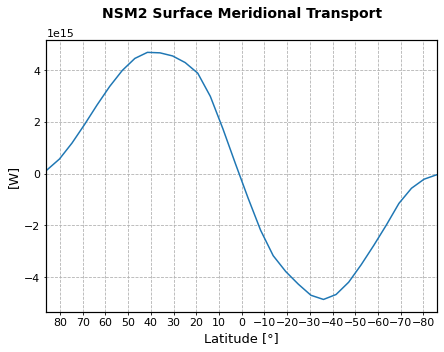

In [44]:
var="RTOA"
v=["rst","rlut"]
RTOA=composed_variable(v,plt.cm.jet,var_dic[var][0],simulation,var_dic[var][1],var_dic[var][2],15,\
                                contourf=True,vmn=-150,vmx=120,cost=var_dic[var][-1],save=True)

RTOA_nnual=RTOA.global_annual_mean()

RTOA_zonal=RTOA.zonal_mean()

RTOA_zonal_annual=RTOA.zonal_annual_mean()

RTOA_annual_cycle=RTOA.annual_cycle()

RTOA.annual_cycle_hemisphere()

RTOA.global_vision()

RTOA.global_and_zonal()

RTOA.polar()

RTOA_transport=RTOA.transport()

# RSS #

Mean 70-100: 163.44594 dev.std: 0.02986 W m^-2
Global Mean: 163.418 W m^-2
Mean over Land with 0.5 as threshold: 152.261 W m^-2 
Mean over Ocean with 0.5 as threshold: 167.941 W m^-2
Mean over Antarctica with 0.5 as threshold: 29.823 W m^-2
Land part 382.13311, Ocean Part 942.63316


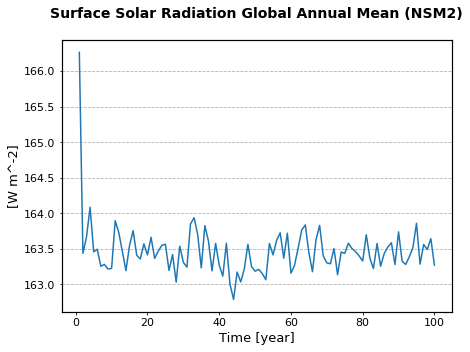

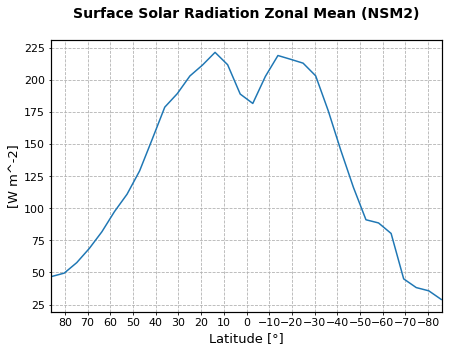

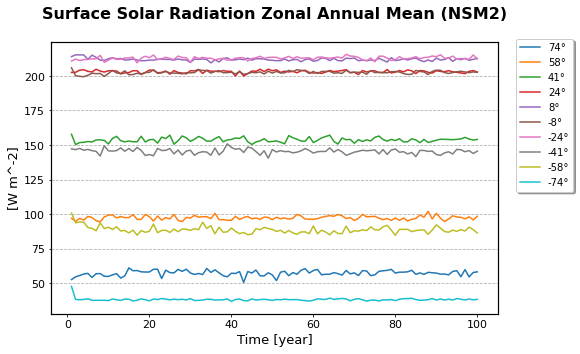

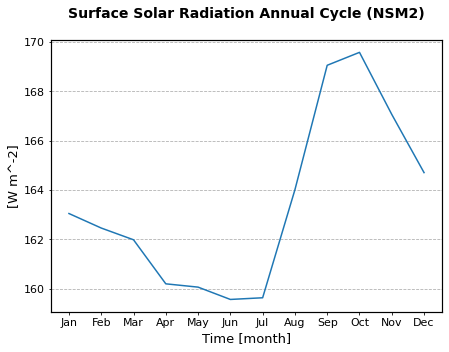

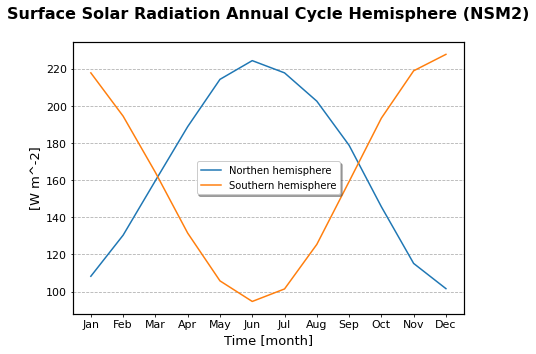

...

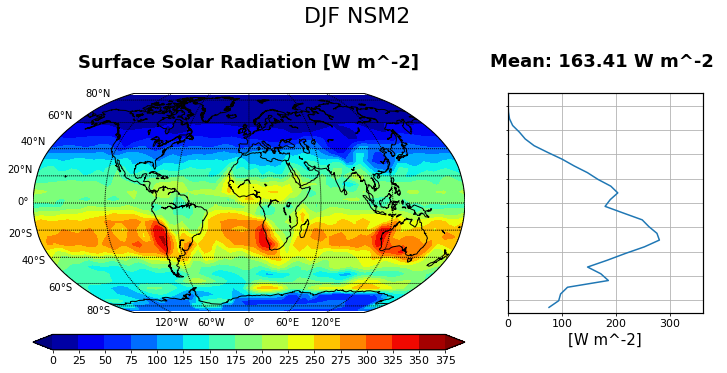

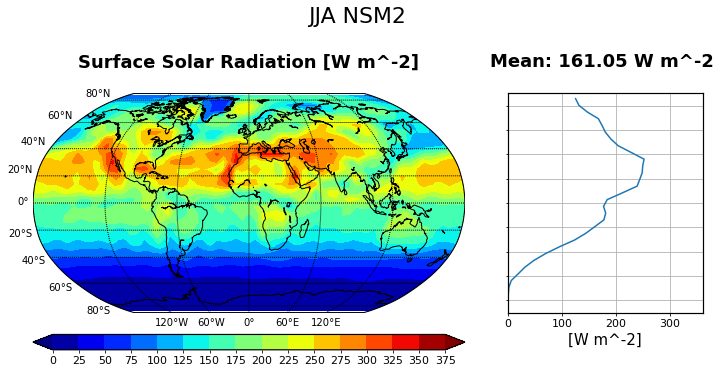

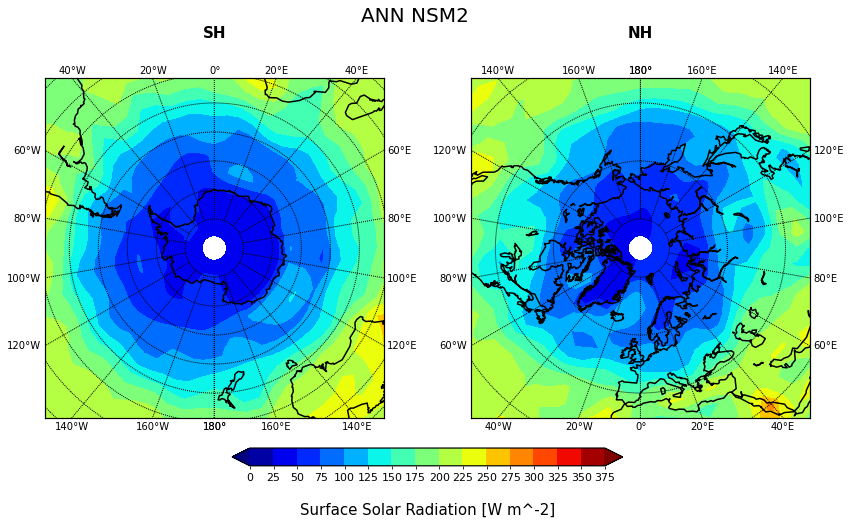

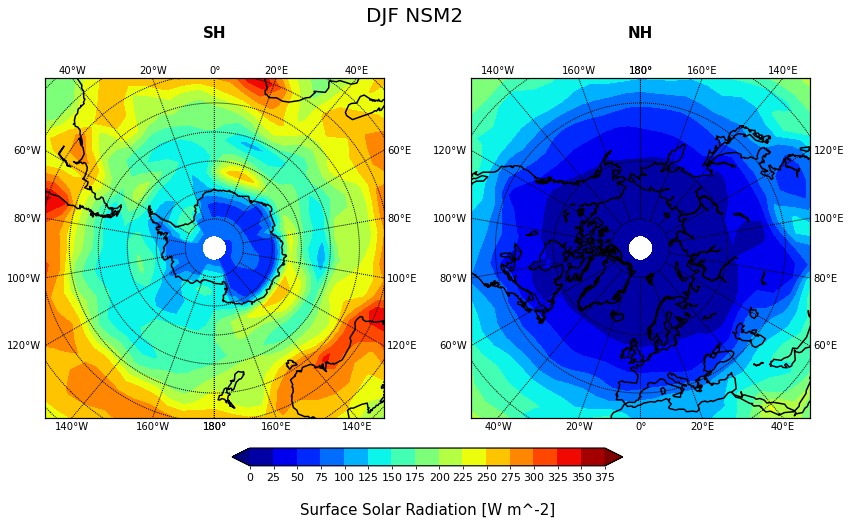

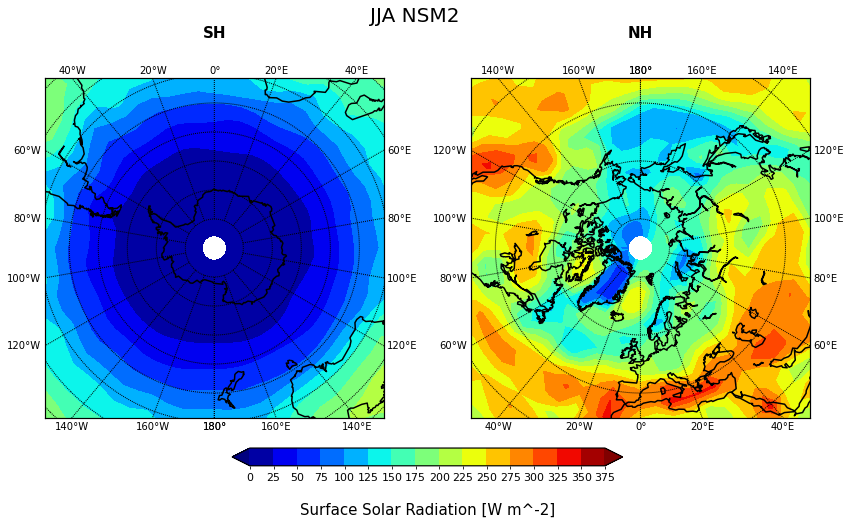

In [45]:
var="rss"
rss=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=0,vmx=360,save=True)

rss_annual=rss.global_annual_mean()

rss_zonal=rss.zonal_mean()

rss_zonal_annual=rss.zonal_annual_mean()

rss_annual_cycle=rss.annual_cycle()

rss.annual_cycle_hemisphere()

rss_global=rss.global_vision()

rss.global_and_zonal()

rss.polar()

# RLS #

Mean 70-100: -62.68012 dev.std: 0.0298 W m^-2
Global Mean: -62.677 W m^-2
Mean over Land with 0.5 as threshold: -75.295 W m^-2 
Mean over Ocean with 0.5 as threshold: -57.562 W m^-2
Mean over Antarctica with 0.5 as threshold: -42.108 W m^-2
Land part 382.13311, Ocean Part 942.63316


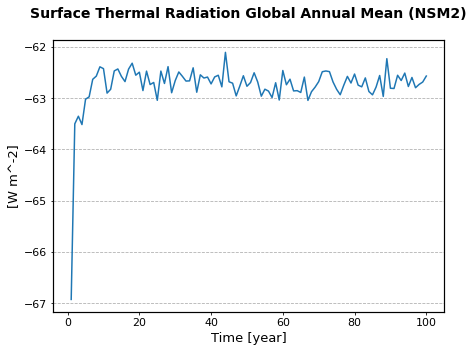

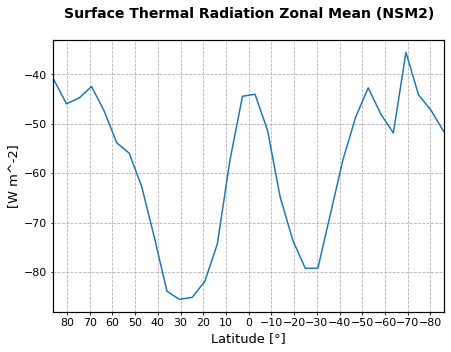

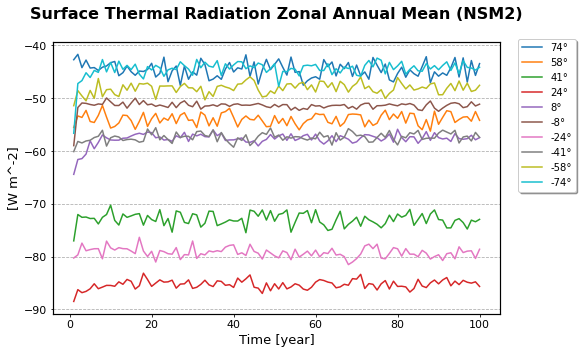

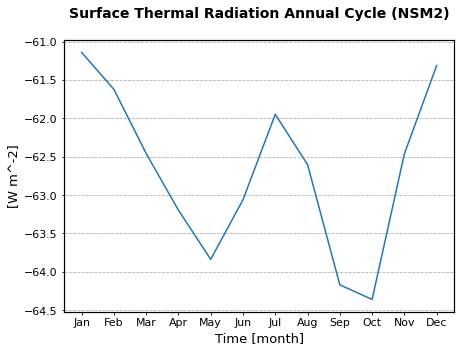

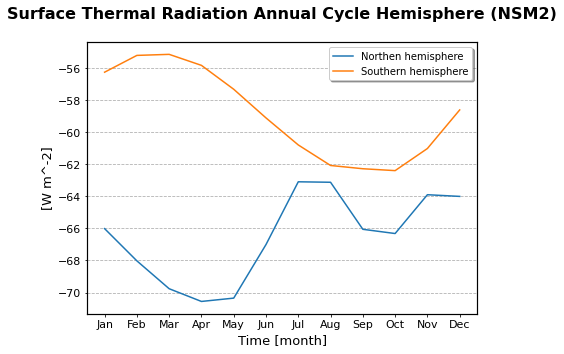

...

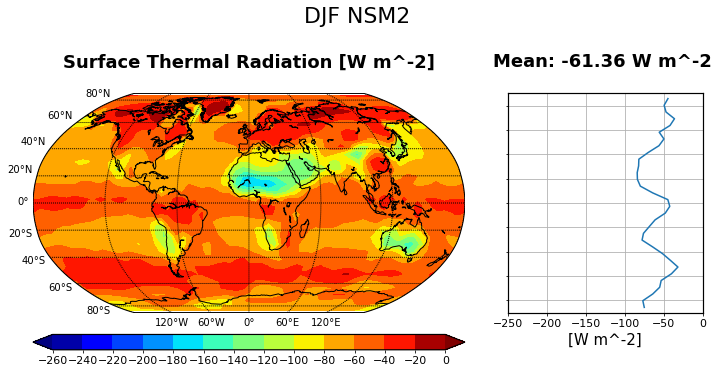

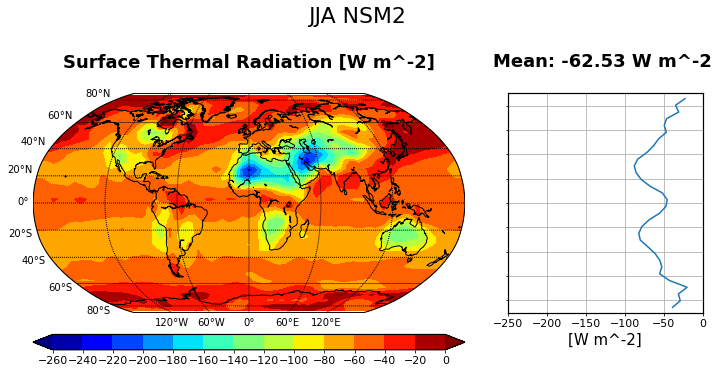

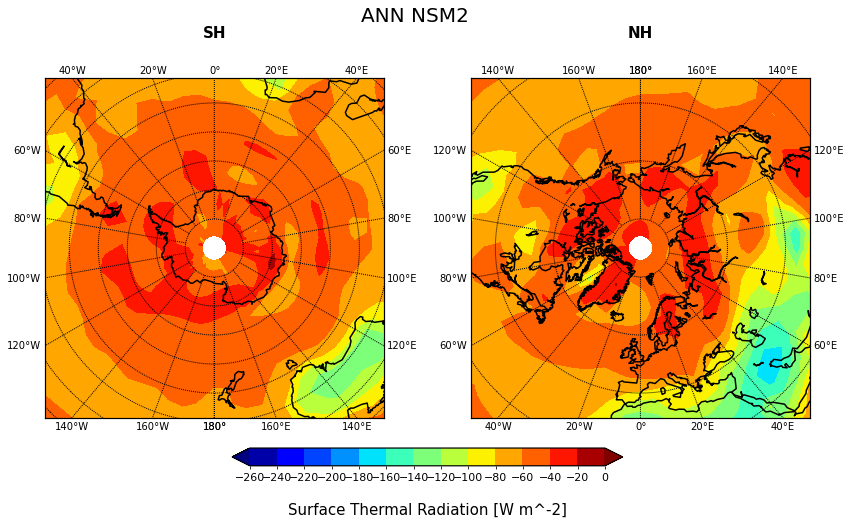

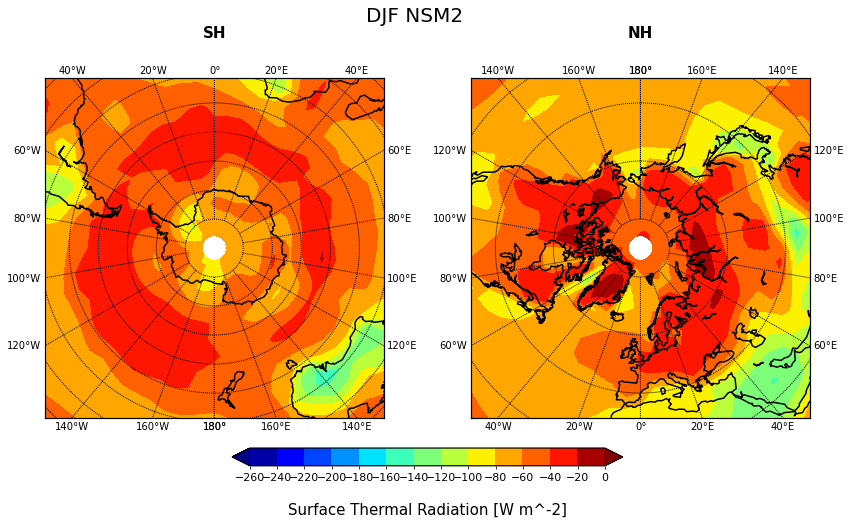

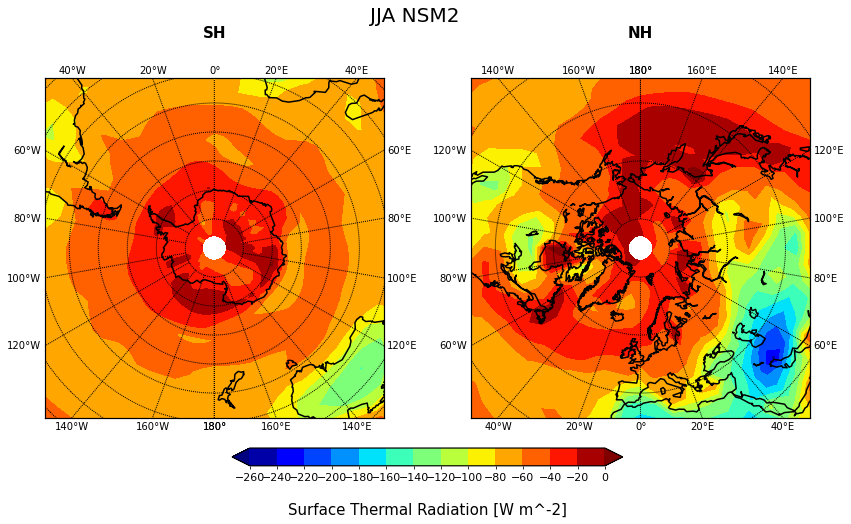

In [46]:
var="rls"
rls=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-250,vmx=0,save=True)

rls_annual=rls.global_annual_mean()

rls_zonal=rls.zonal_mean()

rls_zonal_annual=rls.zonal_annual_mean()

rls_annual_cycle=rls.annual_cycle()

rls.annual_cycle_hemisphere()

rls_global=rls.global_vision()

rls.global_and_zonal()

rls.polar()

# HFSS #

Mean 70-100: -18.87196 dev.std: 0.02601 W m^-2
Global Mean: -18.873 W m^-2
Mean over Land with 0.5 as threshold: -21.632 W m^-2 
Mean over Ocean with 0.5 as threshold: -17.755 W m^-2
Mean over Antarctica with 0.5 as threshold: 18.857 W m^-2
Land part 382.13311, Ocean Part 942.63316


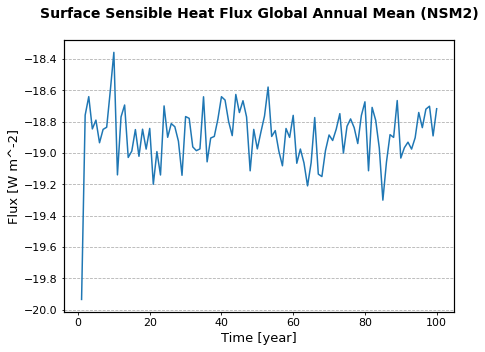

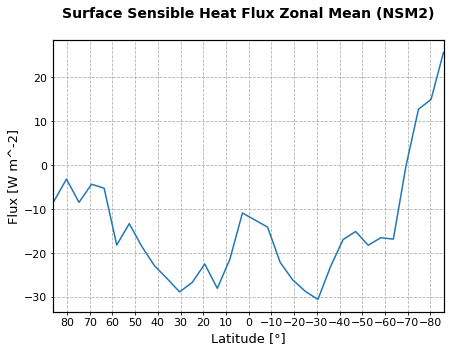

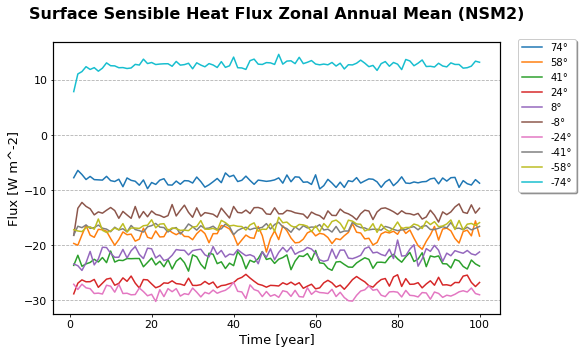

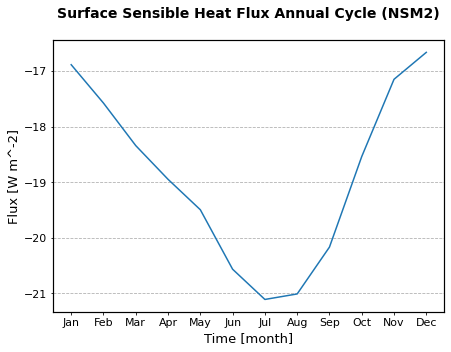

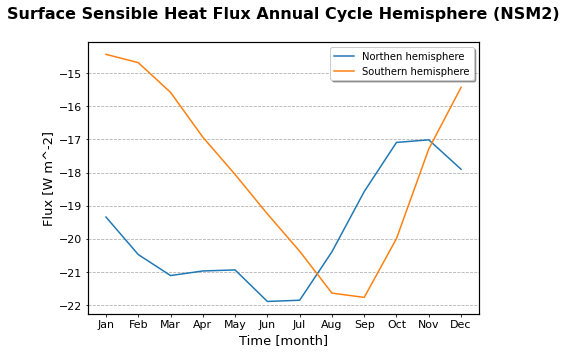

...

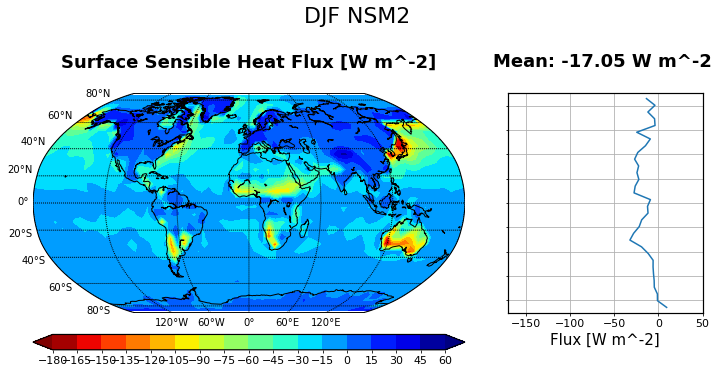

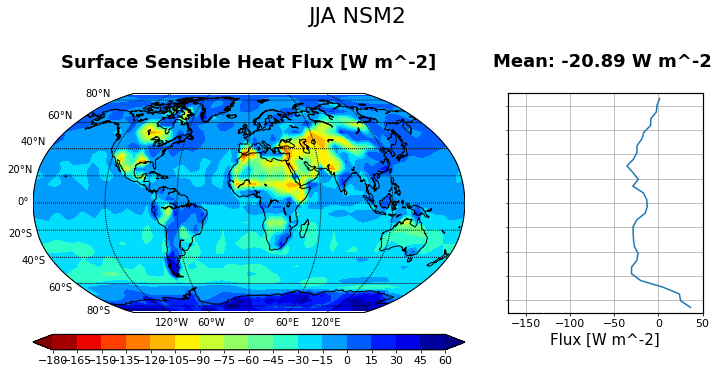

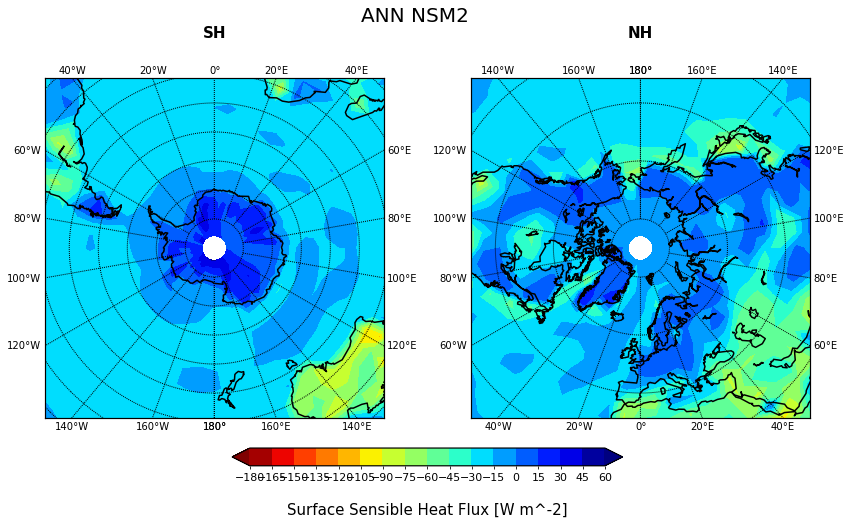

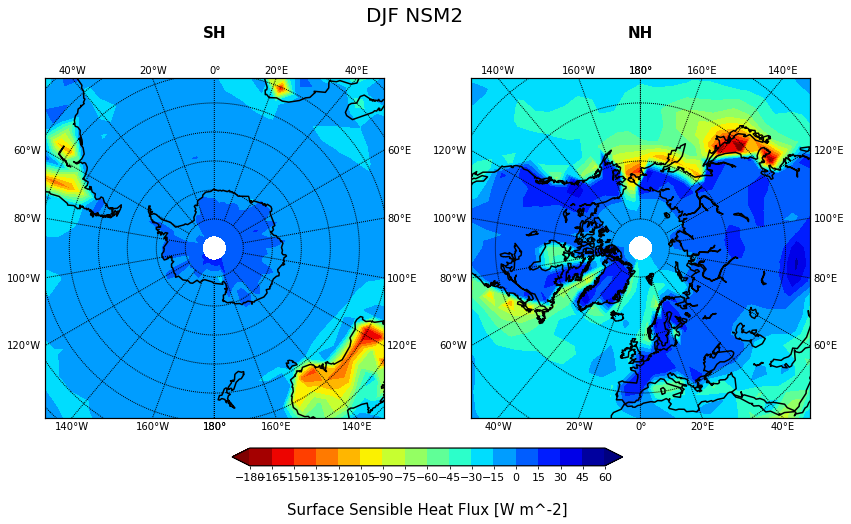

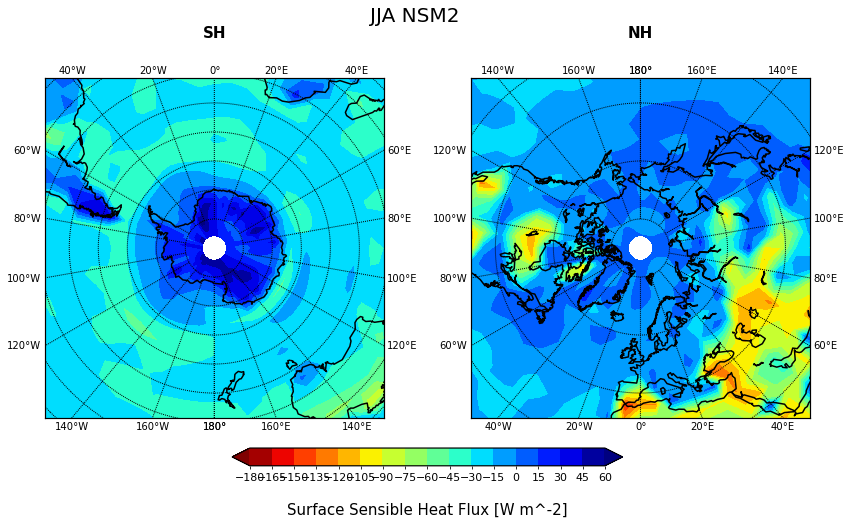

In [47]:
var="hfss"
hfss=single_variable(var,plt.cm.jet_r,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-170,vmx=50,save=True)

hfss_annual=hfss.global_annual_mean()

hfss_zonal=hfss.zonal_mean()

hfss_zonal_annual=hfss.zonal_annual_mean()

hfss_annual_cycle=hfss.annual_cycle()

hfss.annual_cycle_hemisphere()

hfss_global=hfss.global_vision()

hfss.global_and_zonal()

hfss.polar()

# HFLS #

Mean 70-100: -81.80578 dev.std: 0.04331 W m^-2
Global Mean: -81.783 W m^-2
Mean over Land with 0.5 as threshold: -54.447 W m^-2 
Mean over Ocean with 0.5 as threshold: -92.865 W m^-2
Mean over Antarctica with 0.5 as threshold: -3.395 W m^-2
Land part 382.13311, Ocean Part 942.63316


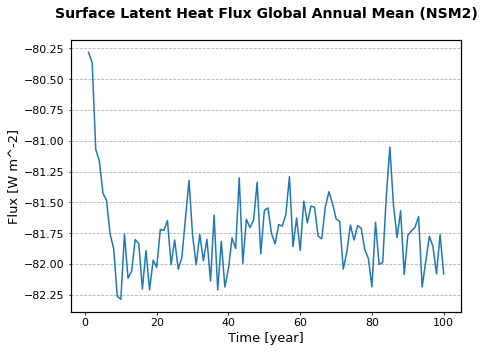

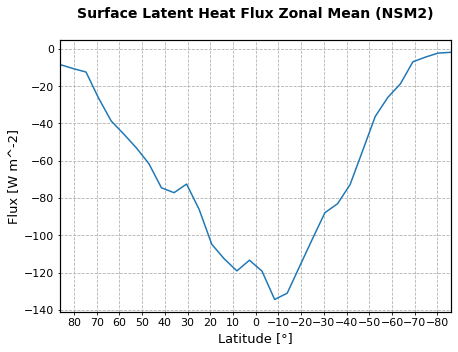

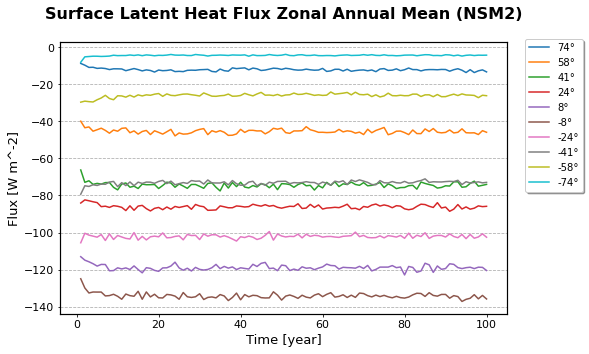

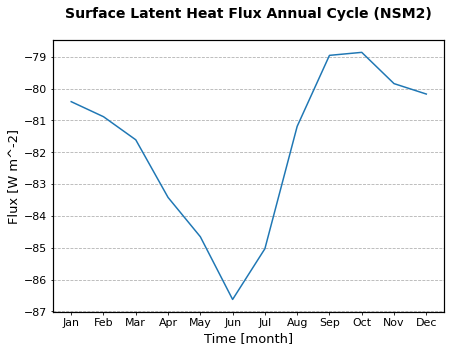

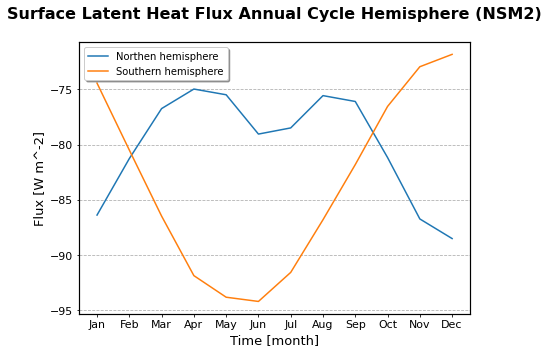

...

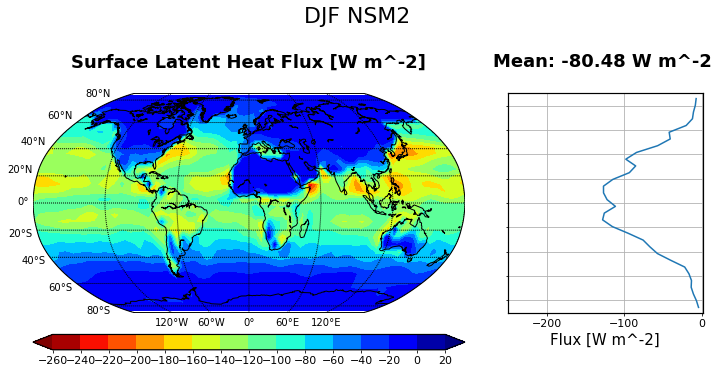

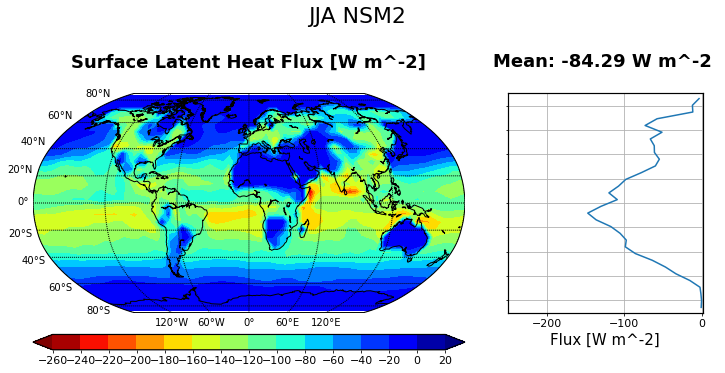

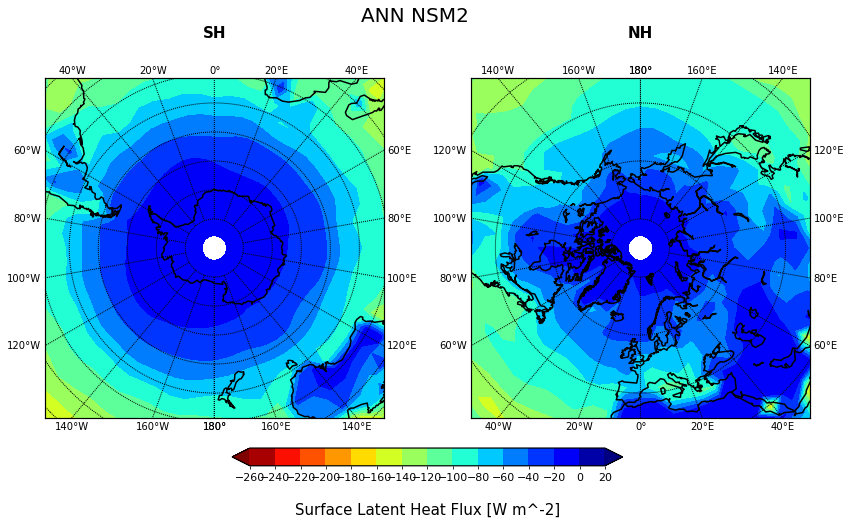

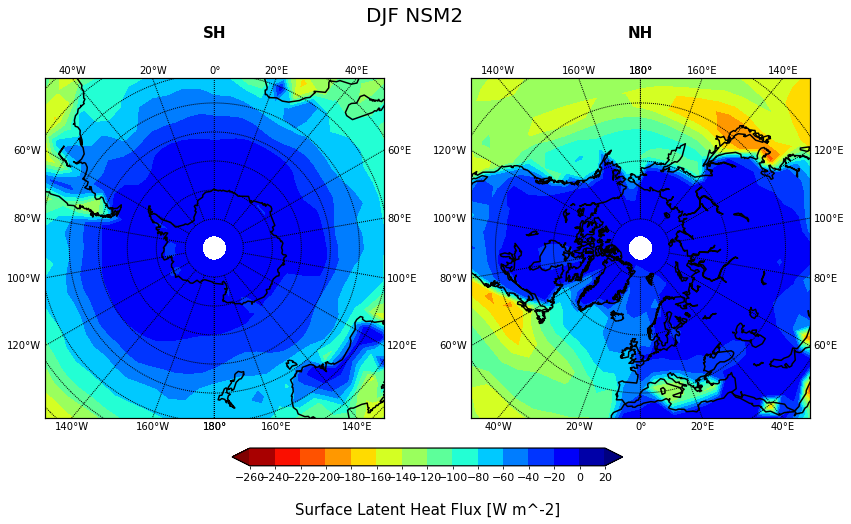

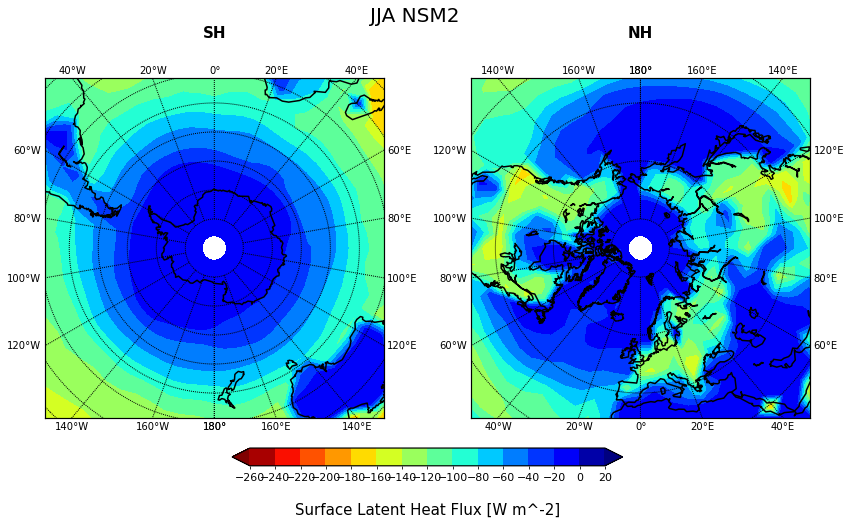

In [48]:
var="hfls"
hfls=single_variable(var,plt.cm.jet_r,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-250,vmx=1,save=True)

hfls_annual=hfls.global_annual_mean()

hfls_zonal=hfls.zonal_mean()

hfls_zonal_annual=hfls.zonal_annual_mean()

hfls_annual_cycle=hfls.annual_cycle()

hfls.annual_cycle_hemisphere()

hfls_global=hfls.global_vision()

hfls.global_and_zonal()

hfls.polar()

# PRSN #

Mean 70-100: 0.5955 dev.std: 0.00167 W m^-2
Global Mean: 0.596 W m^-2
Mean over Land with 0.5 as threshold: 1.188 W m^-2 
Mean over Ocean with 0.5 as threshold: 0.356 W m^-2
Mean over Antarctica with 0.5 as threshold: 3.584 W m^-2
Land part 382.13311, Ocean Part 942.63316


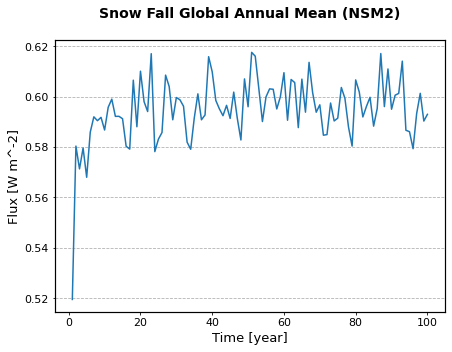

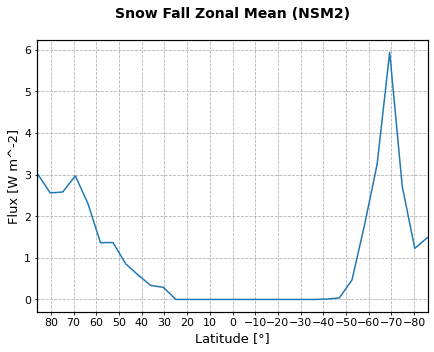

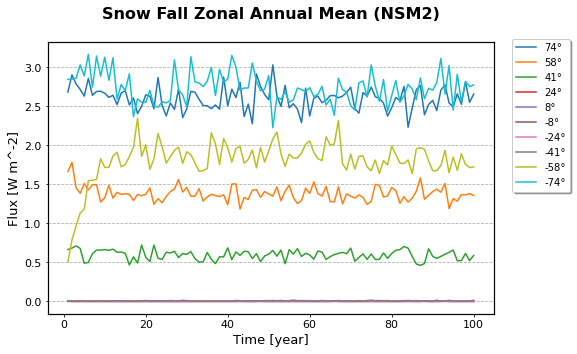

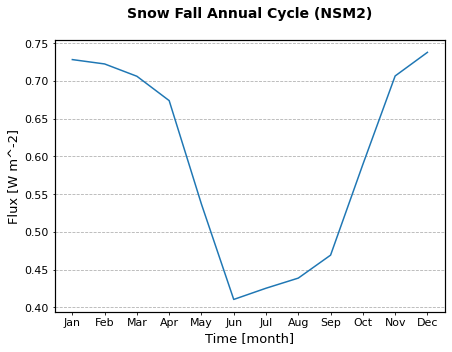

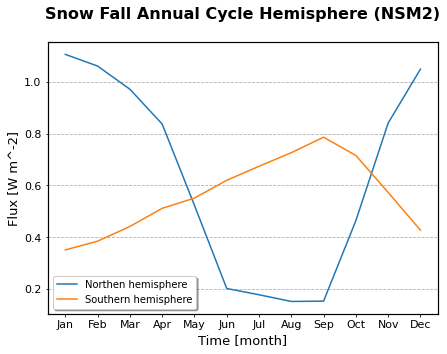

...

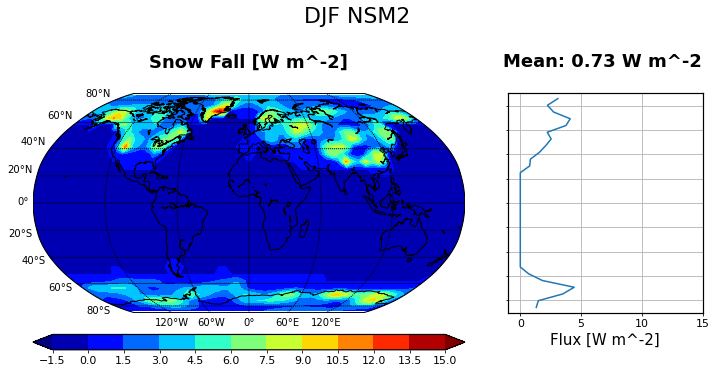

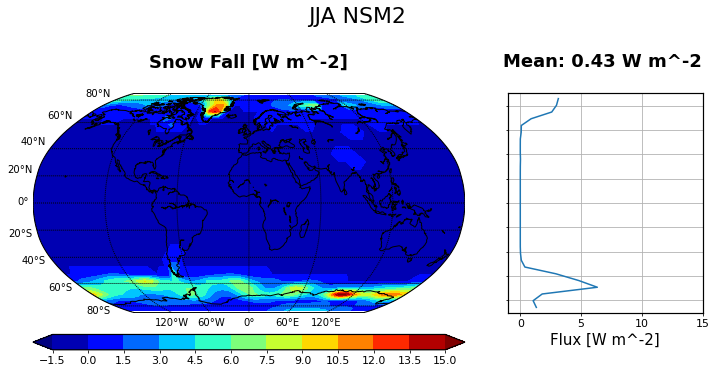

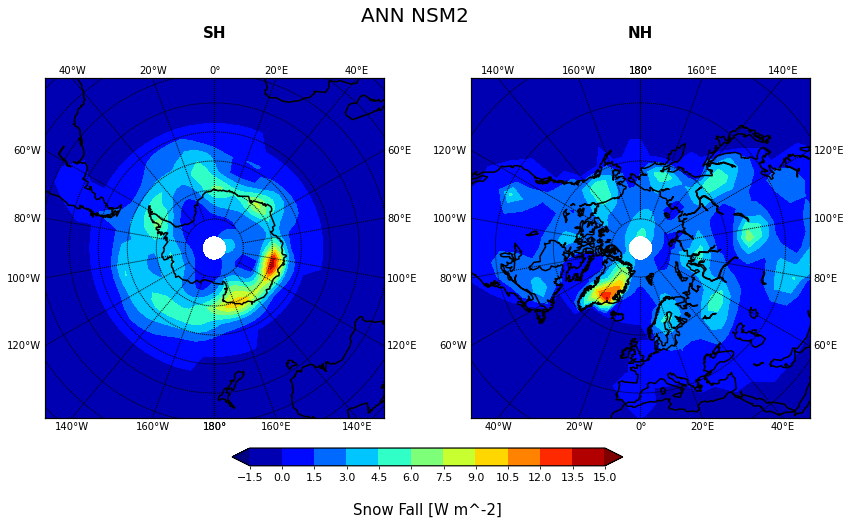

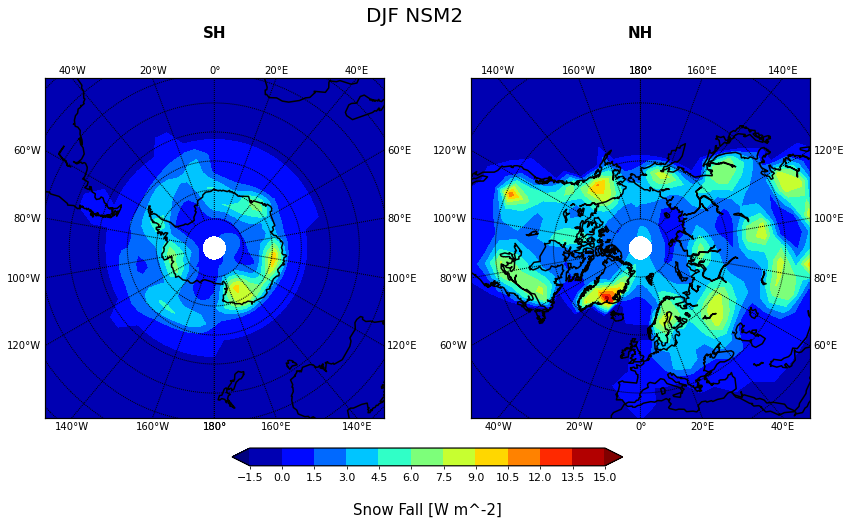

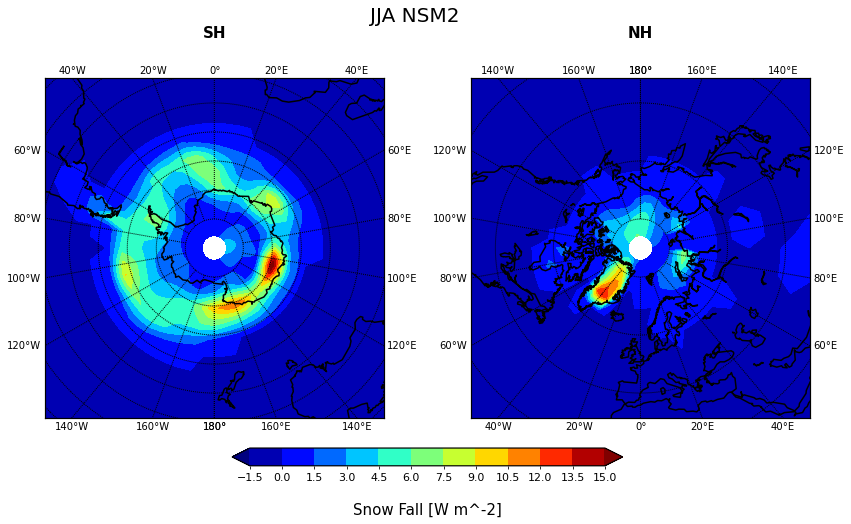

In [49]:
var="prsn"
prsn=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-1,vmx=15,save=True)

prsn_annual=prsn.global_annual_mean()

prsn_zonal=prsn.zonal_mean()

prsn_zonal_annual=prsn.zonal_annual_mean()

prsn_annual_cycle=prsn.annual_cycle()

prsn.annual_cycle_hemisphere()

prsn_global=prsn.global_vision()

prsn.global_and_zonal()

prsn.polar()


# **CALCOLO RADIAZIONE NETTA IN SUPERFICIE** #

Mean 70-100: 0.08807 dev.std: 0.02687 W m^-2
Global Mean: 0.085 W m^-2
Mean over Land with 0.5 as threshold: 0.887 W m^-2 
Mean over Ocean with 0.5 as threshold: -0.240 W m^-2
Mean over Antarctica with 0.5 as threshold: 3.178 W m^-2
Land part 382.13311, Ocean Part 942.63316


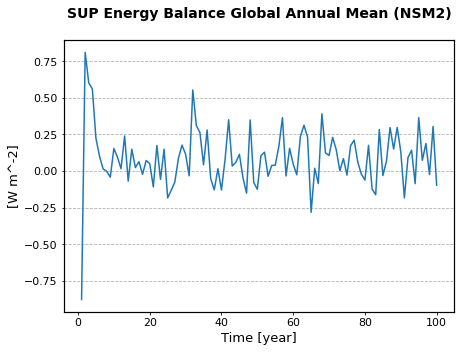

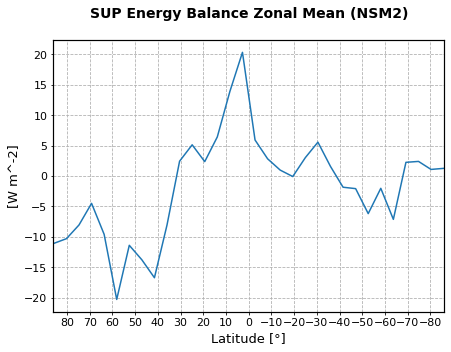

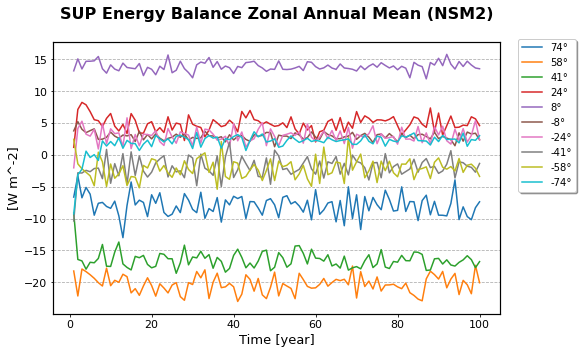

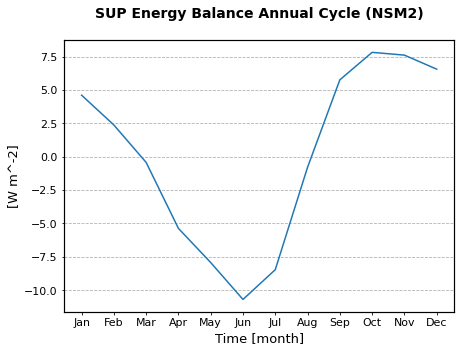

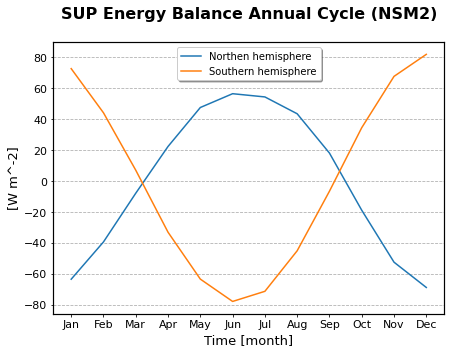

...

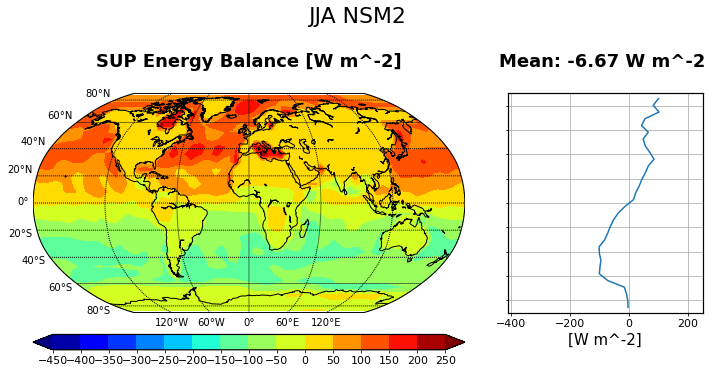

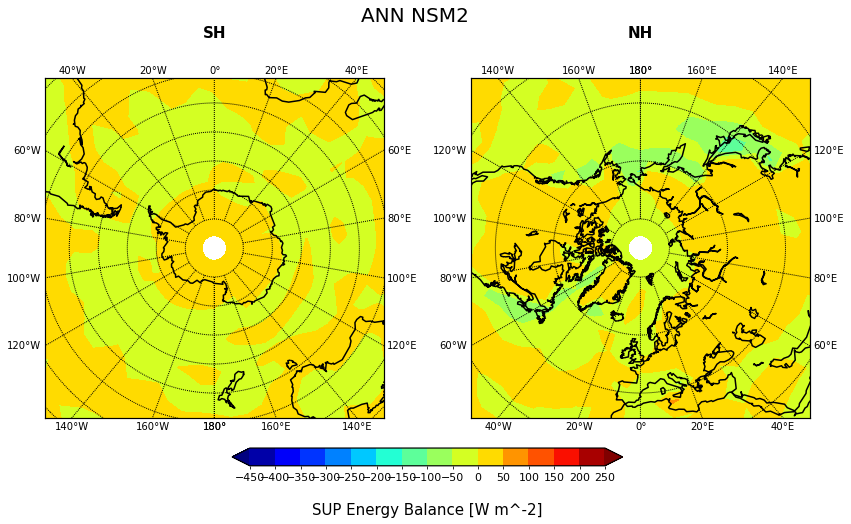

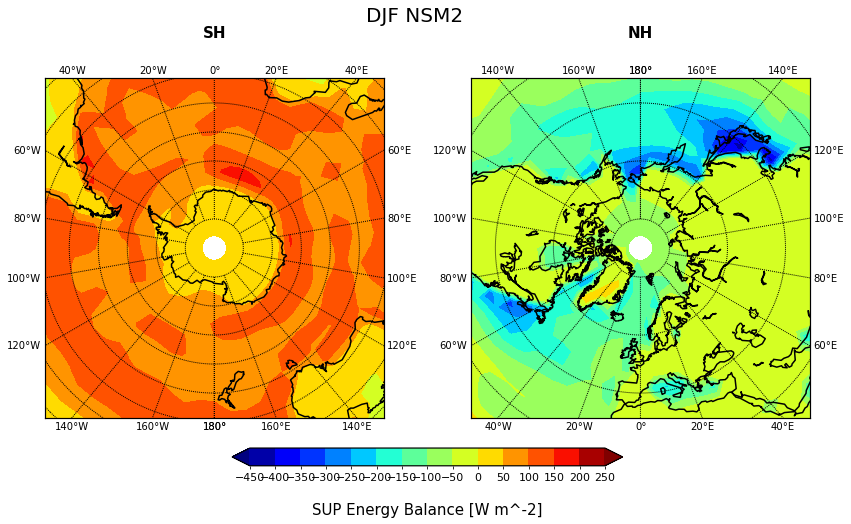

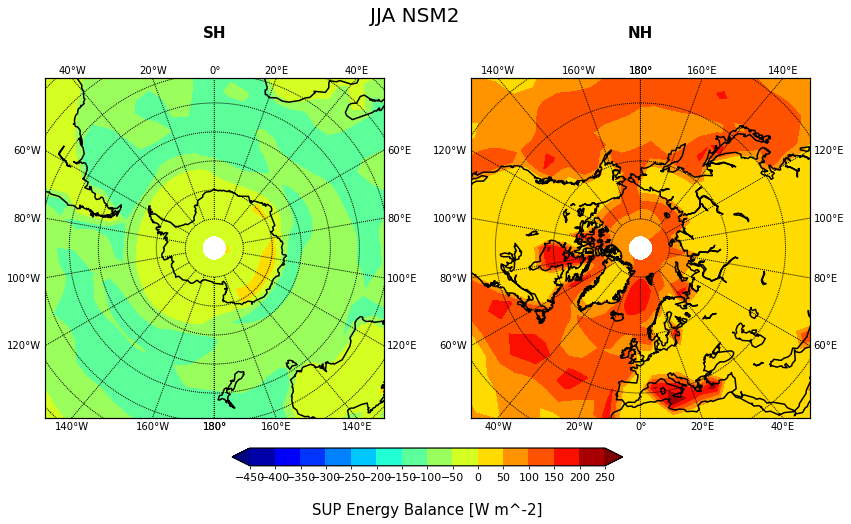

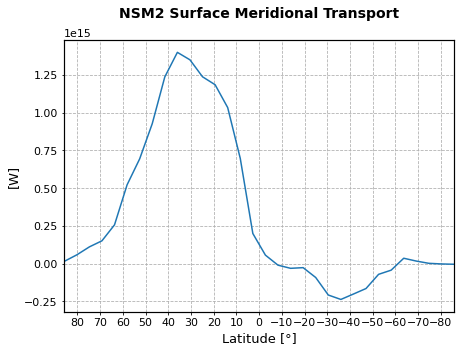

In [50]:
var="RSUP"
v=["rss","rls","hfss","hfls"]
RSUP=composed_variable(v,plt.cm.jet,var_dic[var][0],simulation,var_dic[var][1],var_dic[var][2],15,\
                                contourf=True,vmn=-410,vmx=250,cost=var_dic[var][-1],save=True)

RSUP_nnual=RSUP.global_annual_mean()

RSUP_zonal=RSUP.zonal_mean()

RSUP_zonal_annual=RSUP.zonal_annual_mean()

RSUPannual_cycle=RSUP.annual_cycle()

RSUP.annual_cycle_hemisphere()

RSUP.global_vision()

RSUP.global_and_zonal()

RSUP.polar()

RSUP_transport=RSUP.transport()

In [51]:
delta_R=round(RTOA.mean-RSUP.mean,5)
err_delta_R=round(np.sqrt(RTOA.err_std**2+RSUP.err_std**2),5)
dev_delta_R=round(np.sqrt(RTOA.dev_std**2+RSUP.dev_std**2),5)

# EVAP #

Mean 70-100: -2.82267 dev.std: 0.0015 mm day^-1
Global Mean: -2.822 mm day^-1
Mean over Land with 0.5 as threshold: -1.868 mm day^-1 
Mean over Ocean with 0.5 as threshold: -3.208 mm day^-1
Mean over Antarctica with 0.5 as threshold: -0.104 mm day^-1
Land part 382.13311, Ocean Part 942.63316


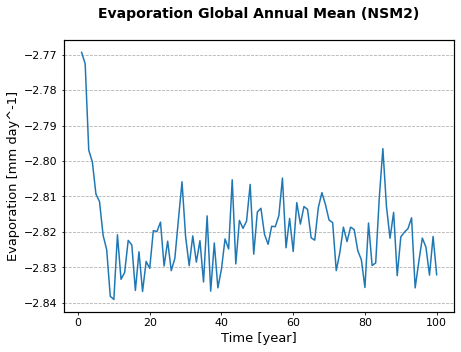

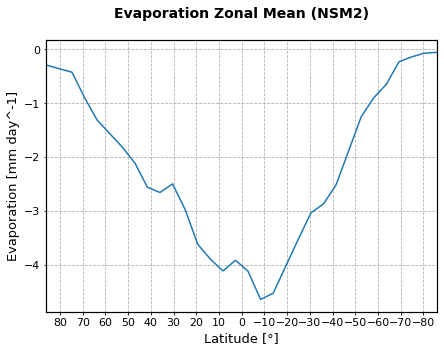

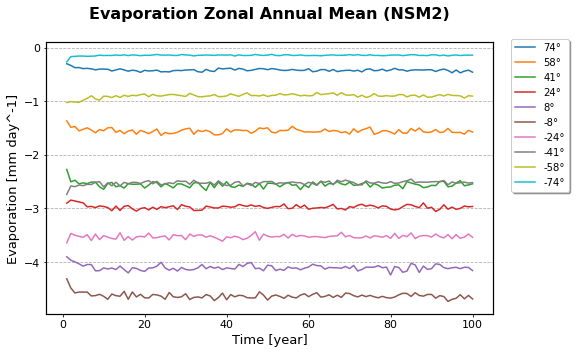

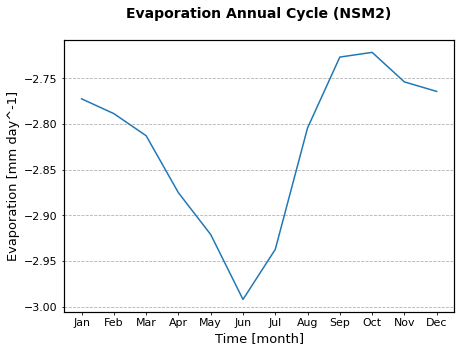

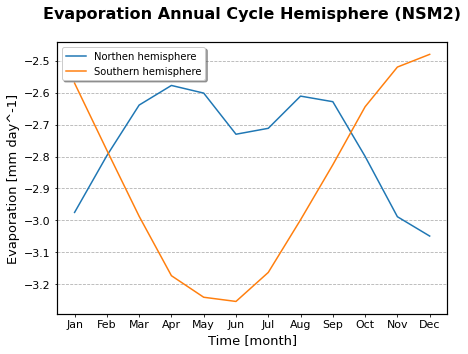

...

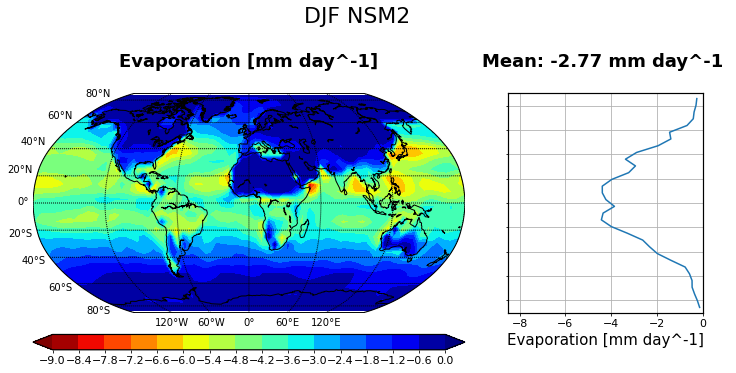

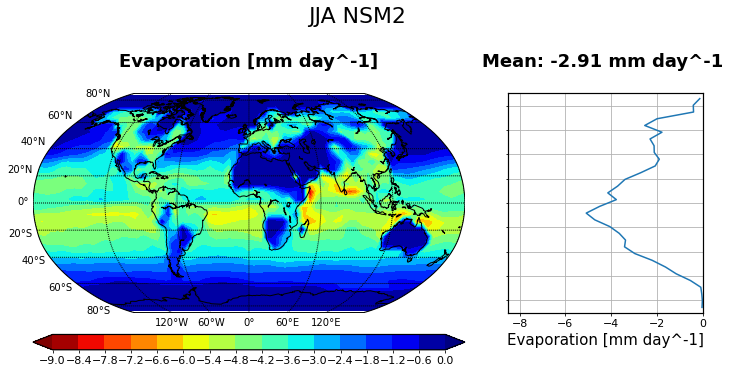

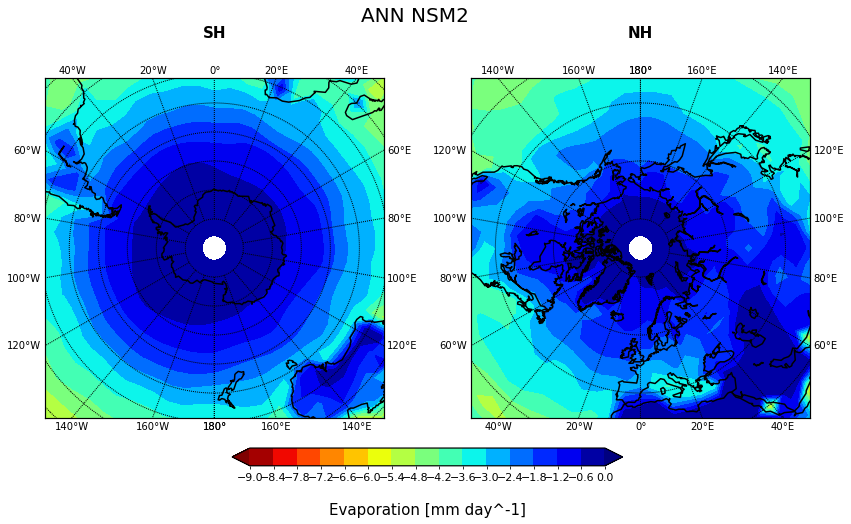

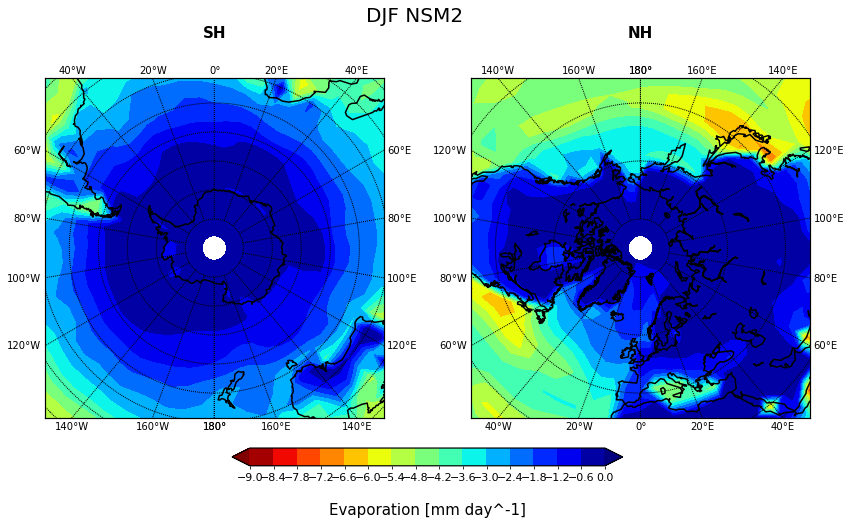

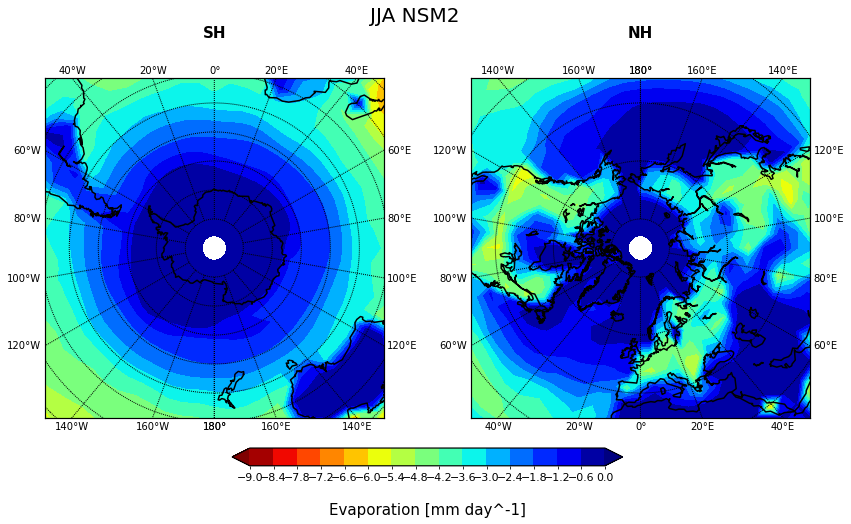

In [52]:
var="evap"
evap=single_variable(var,plt.cm.jet_r,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-8.5,vmx=0,save=True)

evap_annual=evap.global_annual_mean()

evap_zonal=evap.zonal_mean()

evap_zonal_annual=evap.zonal_annual_mean()

evap_annual_cycle=evap.annual_cycle()

evap.annual_cycle_hemisphere()

evap_global=evap.global_vision()

evap.global_and_zonal()

evap.polar()

# Precipitazione #

Mean 70-100: 2.82251 dev.std: 0.00151 mm day^-1
Global Mean: 2.822 mm day^-1
Mean over Land with 0.5 as threshold: 2.461 mm day^-1 
Mean over Ocean with 0.5 as threshold: 2.968 mm day^-1
Mean over Antarctica with 0.5 as threshold: 0.928 mm day^-1
Land part 382.13311, Ocean Part 942.63316


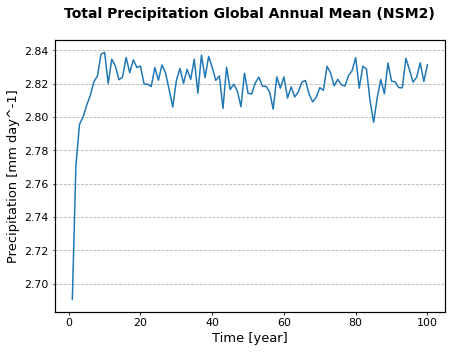

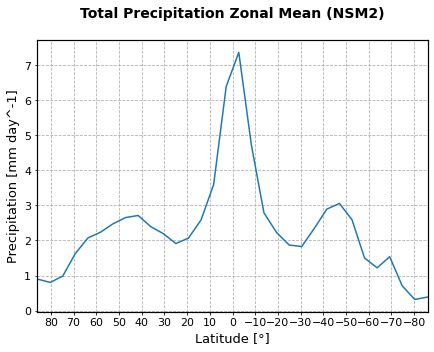

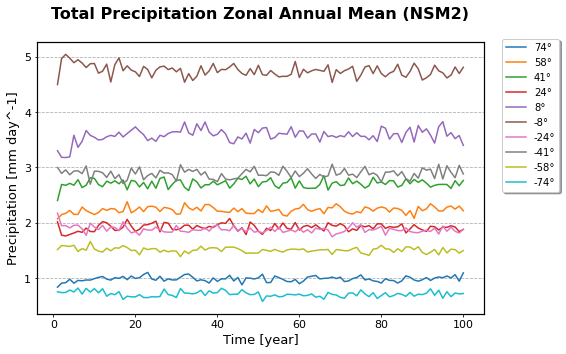

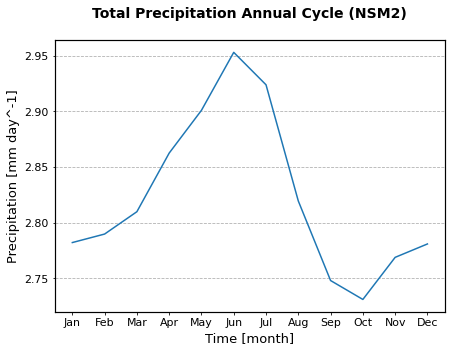

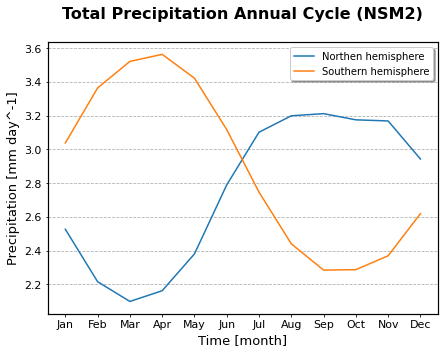

...

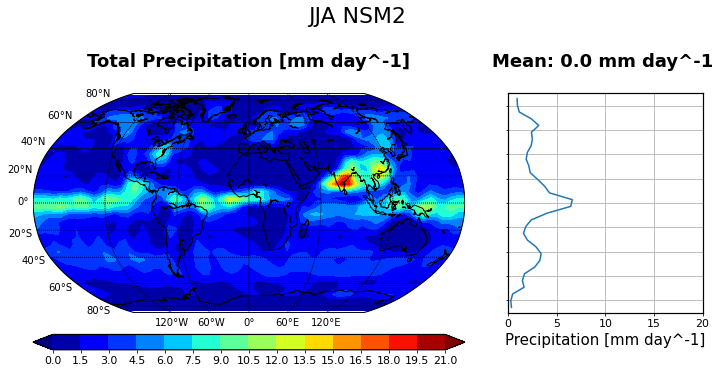

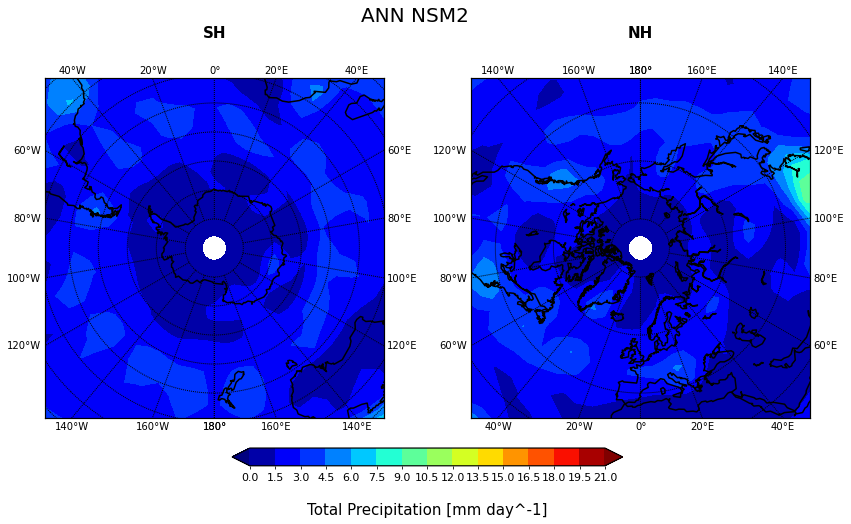

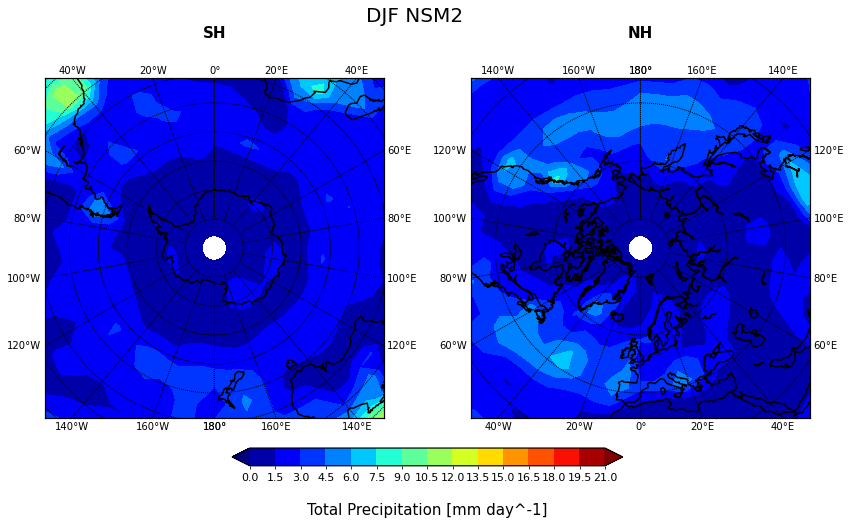

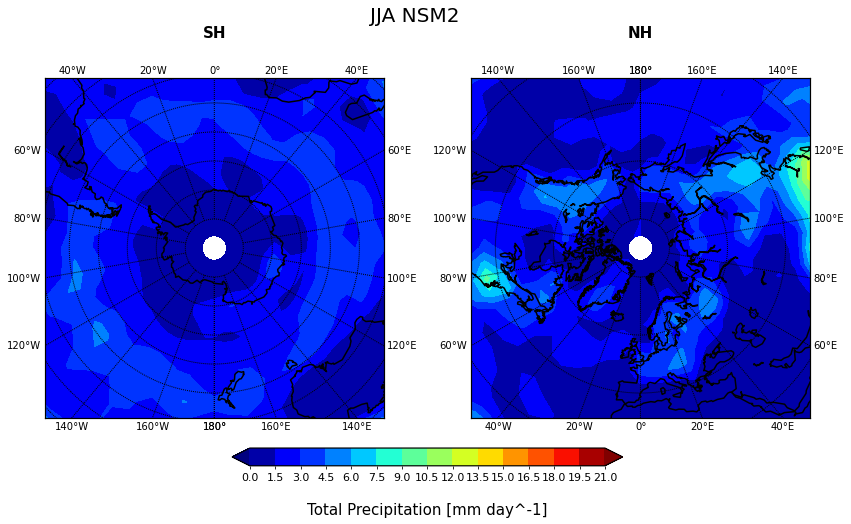

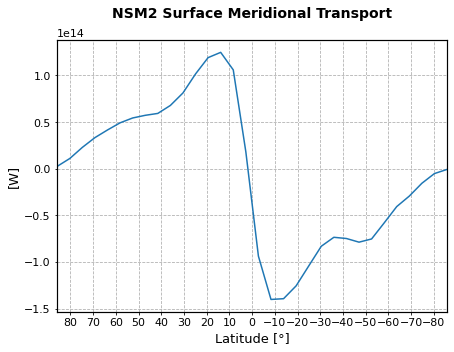

In [53]:
var="prt"
v=["prl","prc"]
prt=composed_variable(v,plt.cm.jet,var_dic[var][0],simulation,var_dic[var][1],var_dic[var][2],15,\
                                contourf=True,vmn=0,vmx=20,cost=var_dic[var][-1],save=True)

prt_nnual=prt.global_annual_mean()

prt_zonal=prt.zonal_mean()

prt_zonal_annual=prt.zonal_annual_mean()

prt_annual_cycle=prt.annual_cycle()

prt.annual_cycle_hemisphere()

prt.global_vision()

prt.global_and_zonal()

prt.polar()

prt_transport=prt.transport()

# P-E #

Mean 70-100: -0.00016 dev.std: 0.00013 mm day^-1
Global Mean: 0.000 mm day^-1
Mean over Land with 0.5 as threshold: 0.592 mm day^-1 
Mean over Ocean with 0.5 as threshold: -0.240 mm day^-1
Mean over Antarctica with 0.5 as threshold: 0.824 mm day^-1
Land part 382.13311, Ocean Part 942.63316


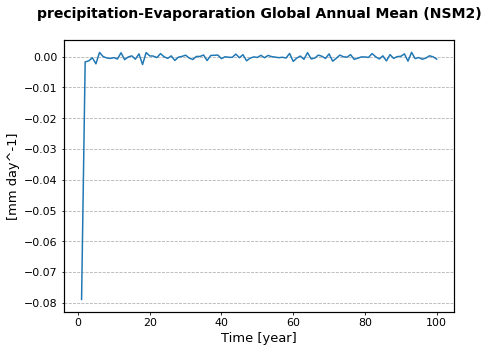

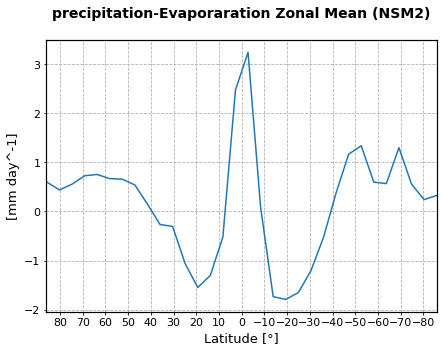

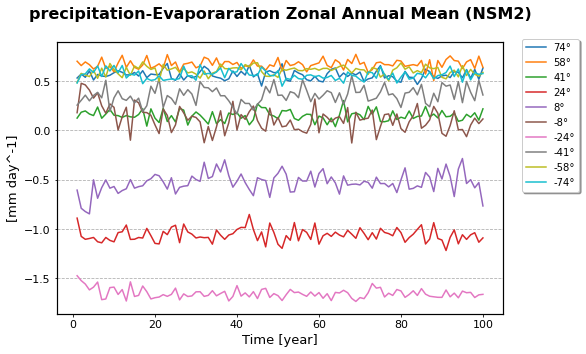

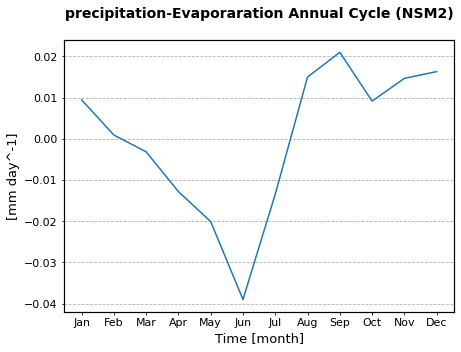

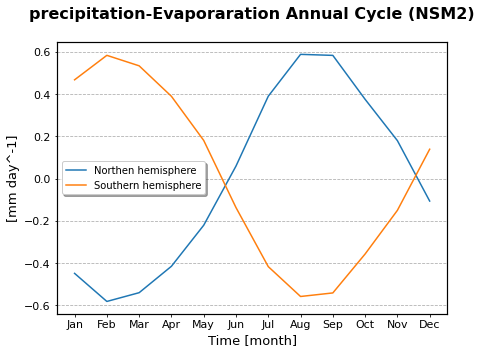

...

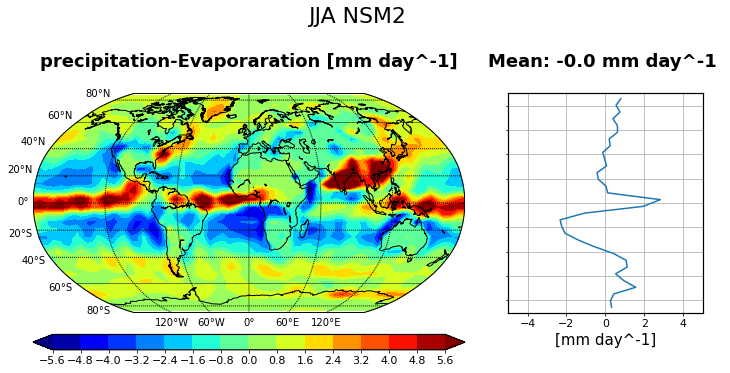

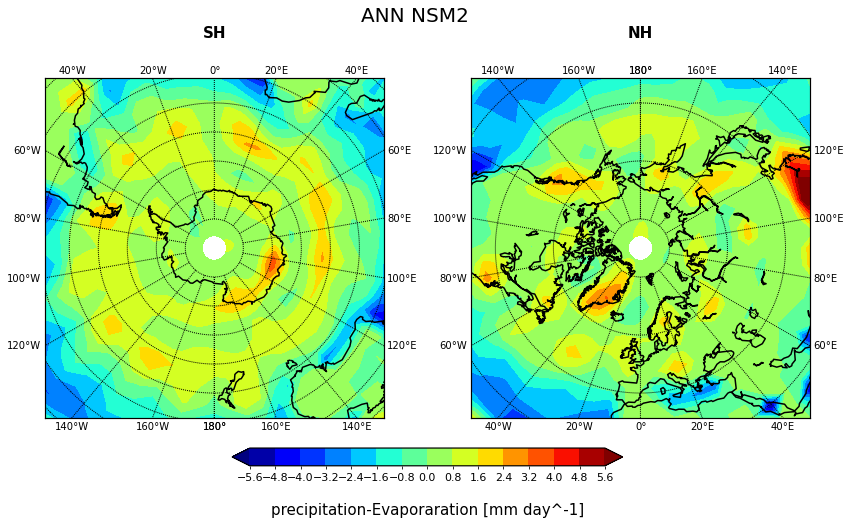

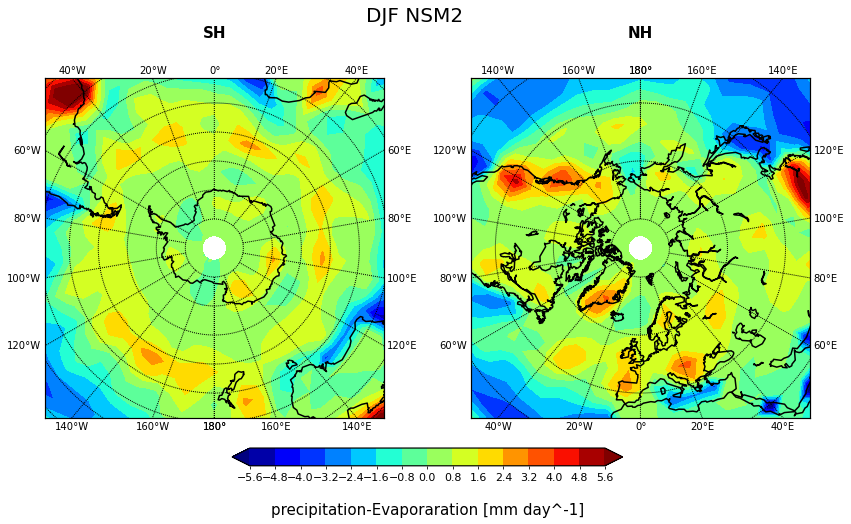

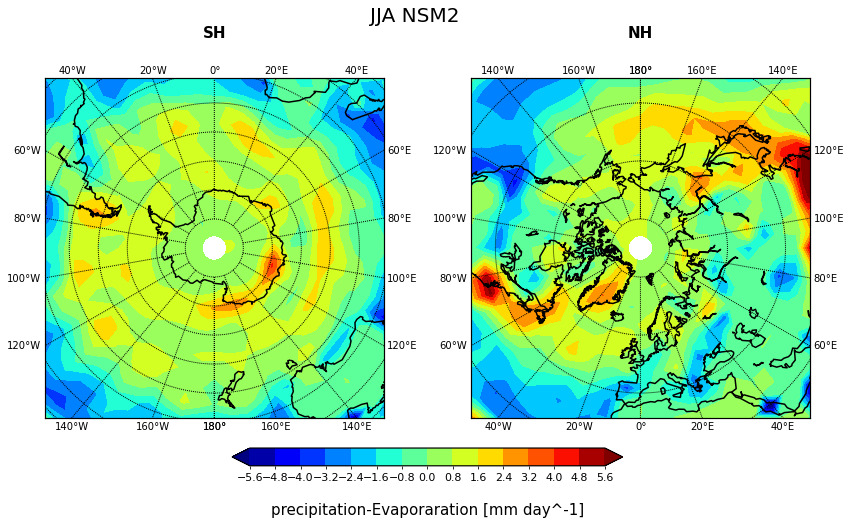

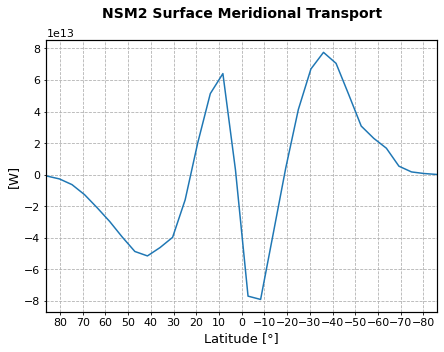

In [54]:
var="P-E"
v=["prl","prc","evap"]
P_E=composed_variable(v,plt.cm.jet,var_dic[var][0],simulation,var_dic[var][1],var_dic[var][2],15,\
                                contourf=True,vmn=-5,vmx=5,cost=var_dic[var][-1],save=True)

P_E_nnual=P_E.global_annual_mean()

P_E_zonal=P_E.zonal_mean()

P_E_zonal_annual=P_E.zonal_annual_mean()

P_E_annual_cycle=P_E.annual_cycle()

P_E.annual_cycle_hemisphere()

P_E.global_vision()

P_E.global_and_zonal()

P_E.polar()

P_E_transport=P_E.transport()

# MRRO #

Mean 70-100: 0.17013 dev.std: 0.00099 mm day^-1
Global Mean: 0.170 mm day^-1
Mean over Land with 0.5 as threshold: -0.000 mm day^-1 
Mean over Ocean with 0.5 as threshold: 0.239 mm day^-1
Mean over Antarctica with 0.5 as threshold: 0.000 mm day^-1
Land part 382.13311, Ocean Part 942.63316


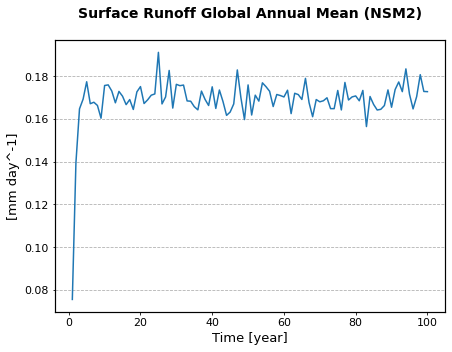

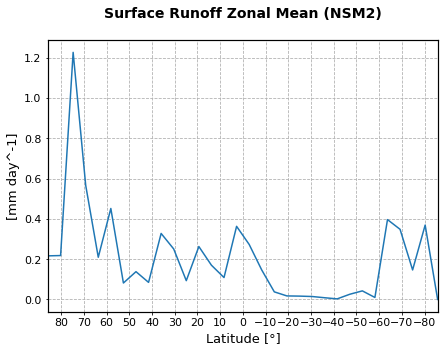

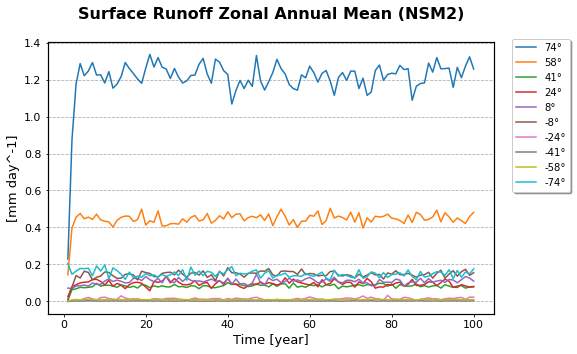

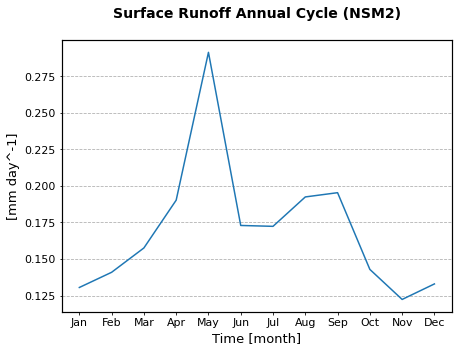

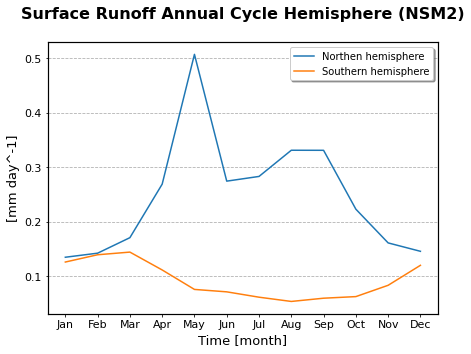

...

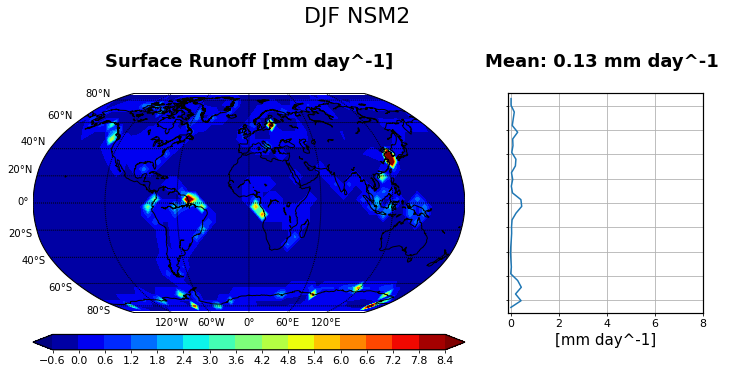

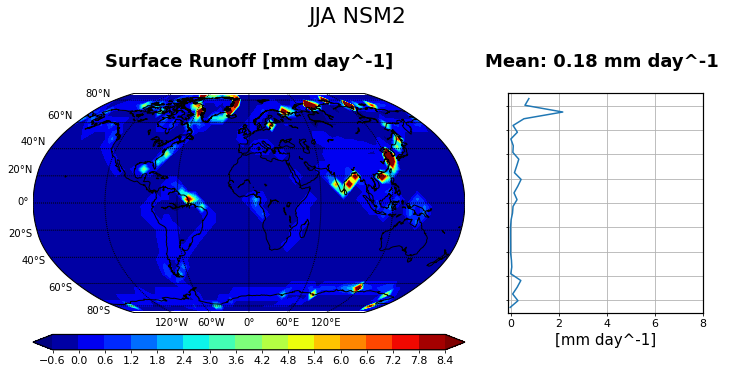

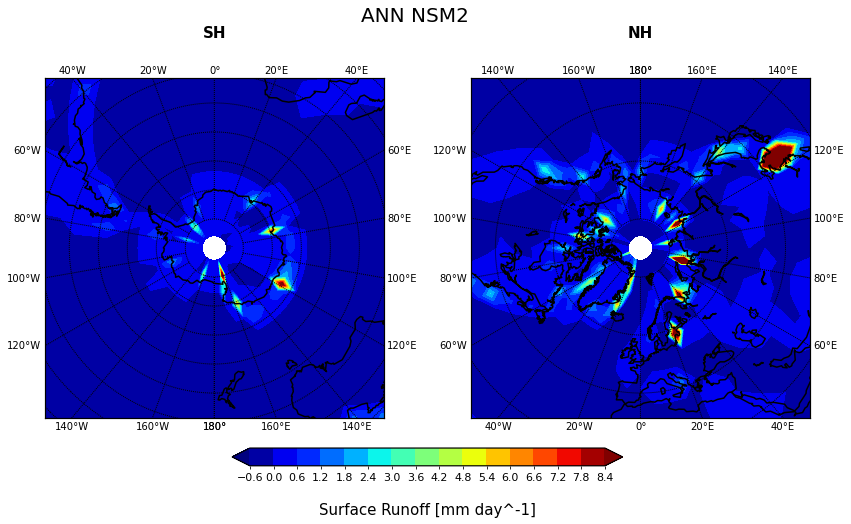

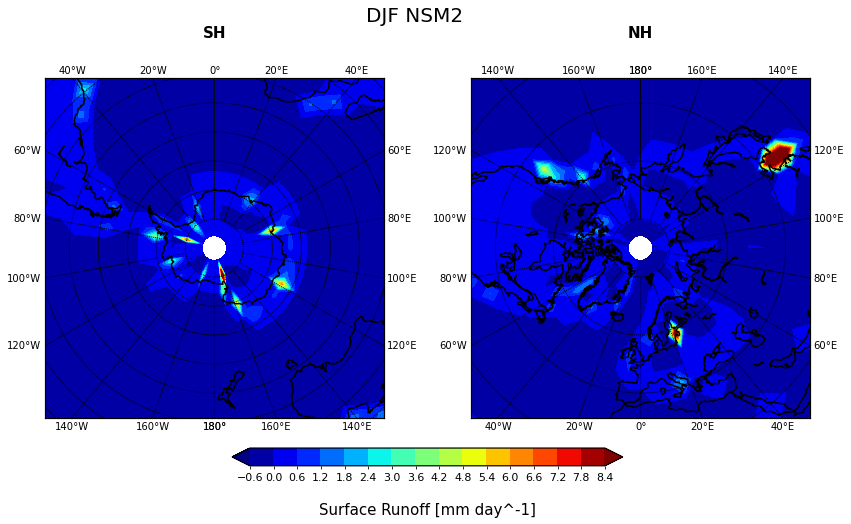

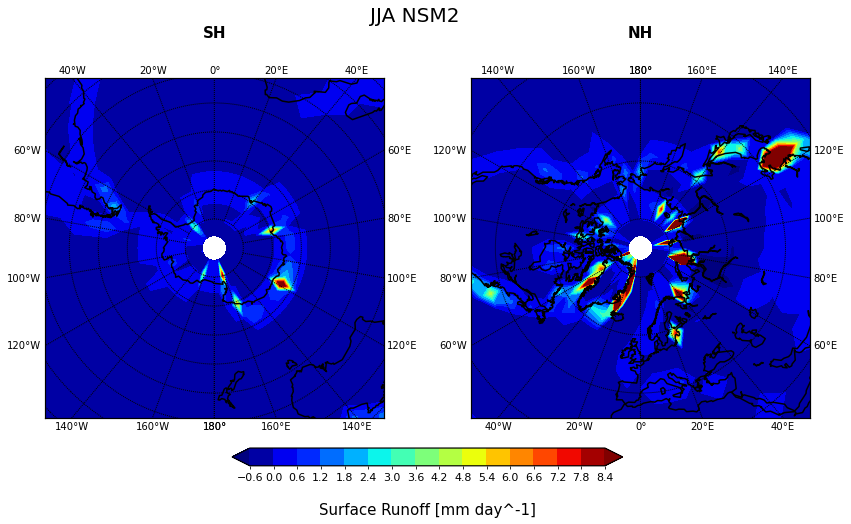

In [55]:
var="mrro"
mrro=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-0.1,vmx=8,save=True)

mrro_annual=mrro.global_annual_mean()

mrro_zonal=mrro.zonal_mean()

mrro_zonal_annual=mrro.zonal_annual_mean()

mrro_annual_cycle=mrro.annual_cycle()

mrro.annual_cycle_hemisphere()

mrro_global=mrro.global_vision()

mrro.global_and_zonal()

mrro.polar()

# MRSO #

Mean 70-100: 0.1807 dev.std: 0.00052 m
Global Mean:   nan m
Mean over Land with 0.5 as threshold: 0.181 m 
Mean over Ocean with 0.5 as threshold:   nan m
Mean over Antarctica with 0.5 as threshold: 0.001 m
Land part 382.13311, Ocean Part 942.63316


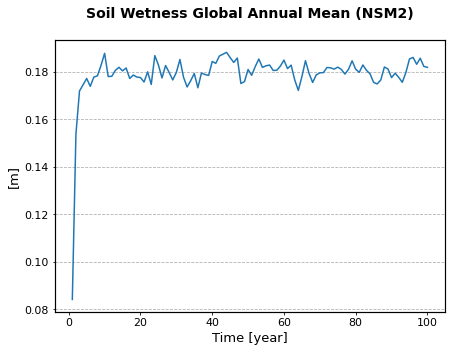

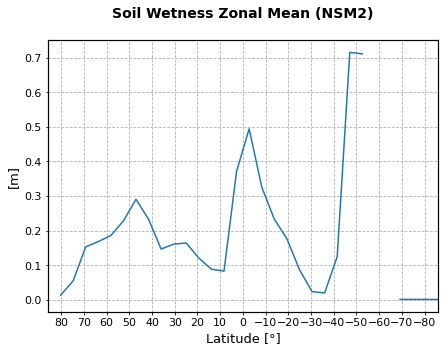

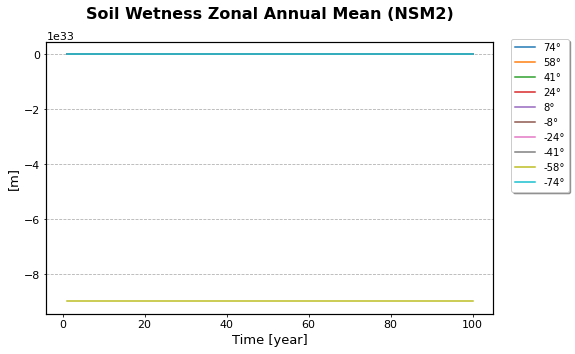

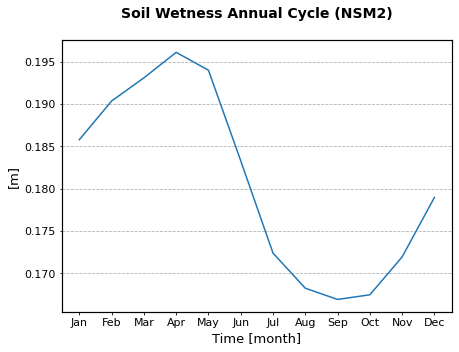

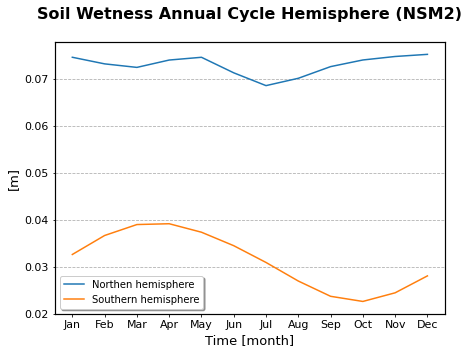

...

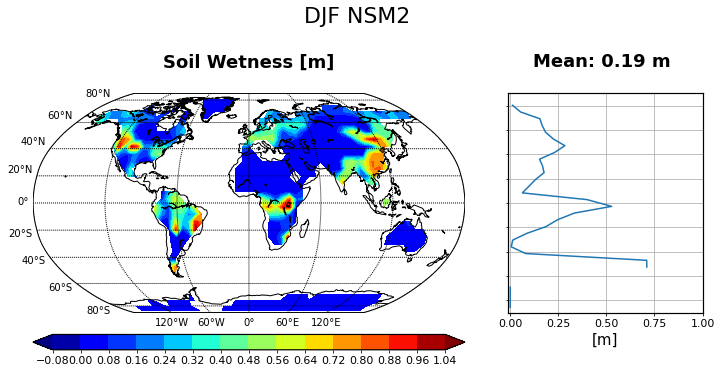

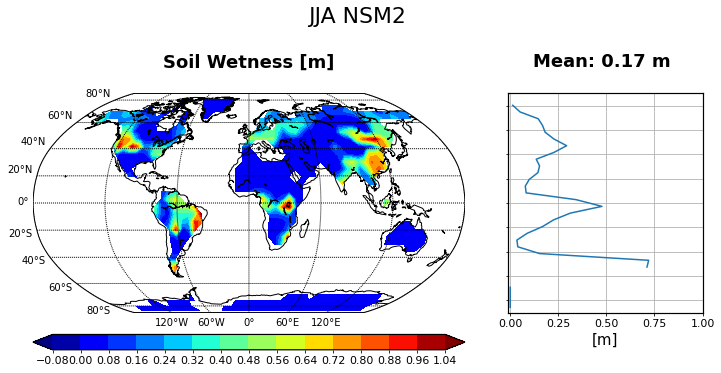

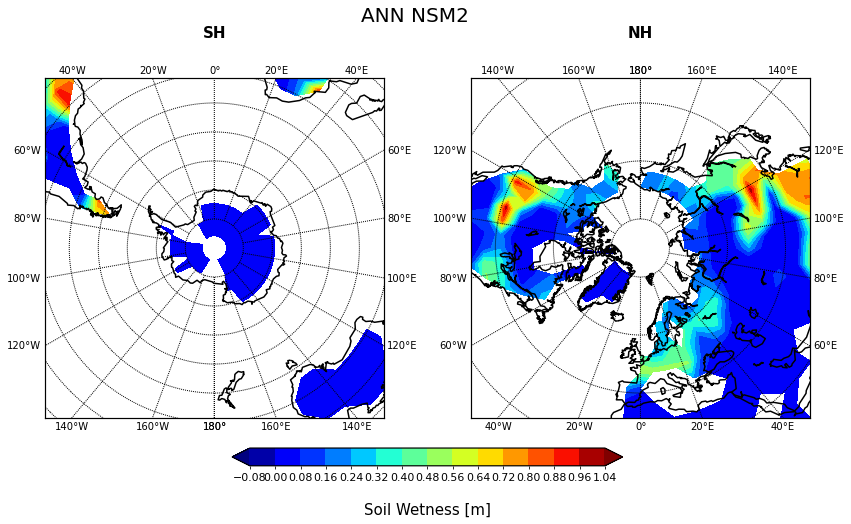

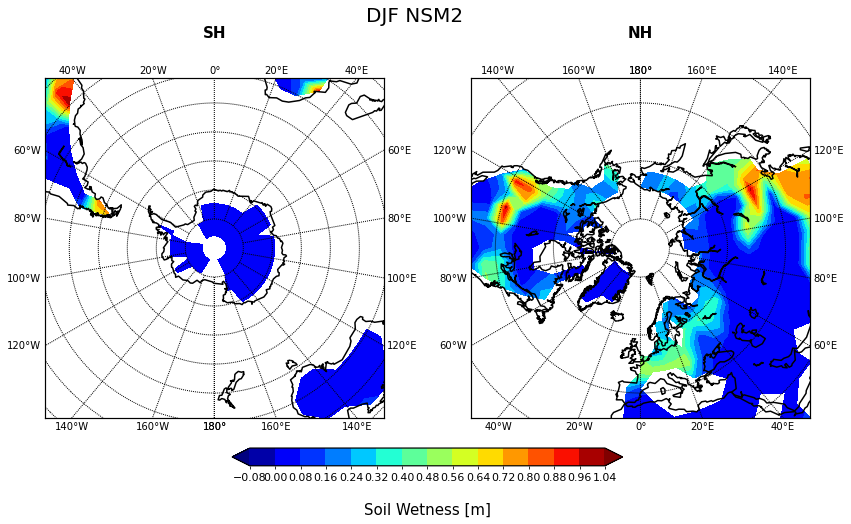

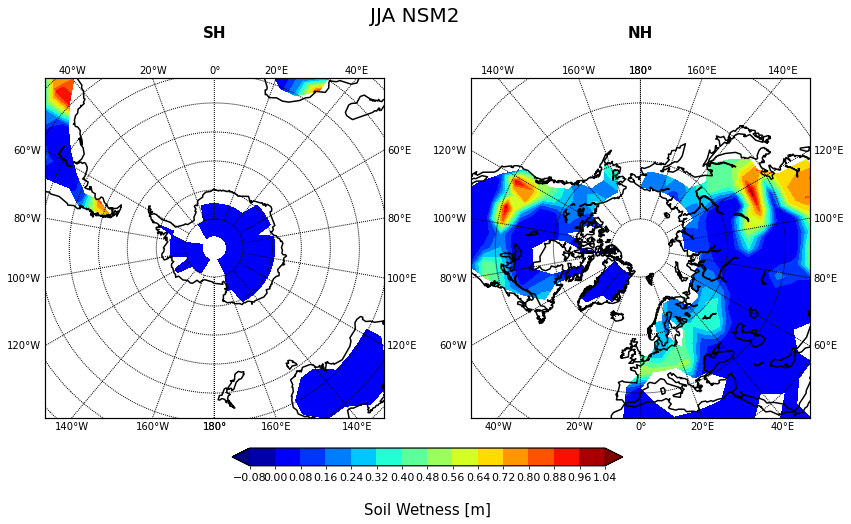

In [56]:
var="mrso"
mrso=single_variable(var,plt.cm.jet,var_dic[var][0],simulation,
                    var_dic[var][1],var_dic[var][2],step,cost=var_dic[var][-1],
                    contourf=True,vmn=-0.01,vmx=1,save=True)

mrso_annual=mrso.global_annual_mean()

mrso_zonal=mrso.zonal_mean()

mrso_zonal_annual=mrso.zonal_annual_mean()

mrso_annual_cycle=mrso.annual_cycle()

mrso.annual_cycle_hemisphere()

mrso_global=mrso.global_vision()

mrso.global_and_zonal()

mrso.polar()



# Tabella #
<table style="width:100%">
<tr>
    <th>Variable</th>
    <th>Mean [{{simulation[2]}}-{{simulation[1]}}]</th>
    <th>Standard Error</th>
    <th>Dev Std</th>
    <th>Land</th>
    <th>Ocean</th>
    <th>Antarctica</th>
    <th>Units</th>
</tr>

<tr>
    <td>TAS</td>
    <td>{{tas.mean}} </td>
    <td>{{tas.err_std}}</td>
    <td>{{tas.dev_std}}</td>
    <td>{{tas.land}}</td>
    <td>{{tas.ocean}} </td>
    <td>{{tas.antarctica}}</td>    
    <td>°C</td>
</tr>

<tr>
    <td>SST</td>
    <td>{{sst.mean}} </td>
    <td>{{sst.err_std}}</td>
     <td>{{sst.dev_std}}</td>
    <td>{{sst.land}}</td>
    <td>{{sst.ocean}} </td>
    <td>{{sst.antarctica}}</td>  
    <td>°C</td>
</tr>
    
 <tr>
    <td>TSO</td>
    <td>{{tso.mean}} </td>
    <td>{{tso.err_std}}</td>
     <td>{{tso.dev_std}}</td>
    <td>{{tso.land}}</td>
    <td>{{tso.ocean}} </td>
    <td>{{tso.antarctica}}</td>  
    <td>°C</td>
</tr>

<tr>
    <td>SIC/ICEC</td>
    <td>{{sic.mean}} </td>
    <td>{{sic.err_std}}</td>
    <td>{{sic.dev_std}}</td>
    <td>{{sic.land}}</td>
    <td>{{sic.ocean}} </td>
    <td>{{sic.antarctica}}</td> 
    <td>Value</td>
</tr>

<tr>
    <td>SIT/ICED</td>
    <td>{{sit.mean}} </td>
    <td>{{sit.err_std}}</td>
    <td>{{sit.dev_std}}</td>
    <td>{{sit.land}}</td>
    <td>{{sit.ocean}} </td>
    <td>{{sit.antarctica}}</td> 
    <td>Value</td>
</tr>


<tr>
    <td>AS</td>
    <td>{{alb.mean}} </td>
    <td>{{alb.err_std}}</td>
    <td>{{alb.dev_std}}</td>
    <td>{{alb.land}}</td>
    <td>{{alb.ocean}} </td>
    <td>{{alb.antarctica}}</td> 
    <td>Value</td>
</tr>
    
<tr>
    <td>CLT</td>
    <td>{{clt.mean}} </td>
    <td>{{clt.err_std}}</td>
    <td>{{clt.dev_std}}</td>
    <td>{{clt.land}}</td>
    <td>{{clt.ocean}} </td>
    <td>{{clt.antarctica}}</td> 
    <td>Value</td>
</tr>
    
    
<tr>
    <td>RST</td>
    <td>{{rst.mean}} </td>
    <td>{{rst.err_std}}</td>
    <td>{{rst.dev_std}}</td>
    <td>{{rst.land}}</td>
    <td>{{rst.ocean}} </td>
    <td>{{rst.antarctica}}</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>

    
<tr>
    <td>RLUT</td>
    <td>{{rlut.mean}} </td>
    <td>{{rlut.err_std}}</td>
    <td>{{rlut.dev_std}}</td>
    <td>{{rlut.land}}</td>
    <td>{{rlut.ocean}} </td>
    <td>{{rlut.antarctica}}</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>
    
    
<tr>
    <td>RTOA</td>
    <td>{{RTOA.mean}} </td>
    <td>{{RTOA.err_std}}</td>
    <td>{{RTOA.dev_std}}</td>
    <td>{{RTOA.land}}</td>
    <td>{{RTOA.ocean}} </td>
    <td>{{RTOA.antarctica}}</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>
    
    
<tr>
    <td>RSS</td>
    <td>{{rss.mean}} </td>
    <td>{{rss.err_std}}</td>
    <td>{{rss.dev_std}}</td>
    <td>{{rss.land}}</td>
    <td>{{rss.ocean}} </td>
    <td>{{rss.antarctica}}</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>

    
    
<tr>
    <td>RLS</td>
    <td>{{rls.mean}} </td>
    <td>{{rls.err_std}}</td>
    <td>{{rls.dev_std}}</td>
    <td>{{rls.land}}</td>
    <td>{{rls.ocean}} </td>
    <td>{{rls.antarctica}}</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>
    
<tr>
    <td>HFSS</td>
    <td>{{hfss.mean}} </td>
    <td>{{hfss.err_std}}</td>
    <td>{{hfss.dev_std}}</td>
    <td>{{hfss.land}}</td>
    <td>{{hfss.ocean}} </td>
    <td>{{hfss.antarctica}}</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>

<tr>
    <td>HFLS</td>
    <td>{{hfls.mean}} </td>
    <td>{{hfls.err_std}}</td>
    <td>{{hfls.dev_std}}</td>
    <td>{{hfls.land}}</td>
    <td>{{hfls.ocean}} </td>
    <td>{{hfls.antarctica}}</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>

<tr>
    <td>PRSN</td>
    <td>{{prsn.mean}} </td>
    <td>{{prsn.err_std}}</td>
    <td>{{prsn.dev_std}}</td>
    <td>{{prsn.land}}</td>
    <td>{{prsn.ocean}} </td>
    <td>{{prsn.antarctica}}</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>

<tr>
    <td>RSUP</td>
    <td>{{RSUP.mean}} </td>
    <td>{{RSUP.err_std}}</td>
    <td>{{RSUP.dev_std}}</td>
    <td>{{RSUP.land}}</td>
    <td>{{RSUP.ocean}} </td>
    <td>{{RSUP.antarctica}}</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>

    
<tr>
    <td>delta_R</td>
    <td>{{delta_R}}</td>
    <td>{{err_delta_R}}</td>
    <td>{{dev_delta_R}}</td>
    <td>Nan</td>
    <td>Nan </td>
    <td>Nan</td> 
    <td>$\frac{W}{m^2}$</td>
</tr>
    
    
<tr>
    <td>EVAP</td>
    <td>{{evap.mean}} </td>
    <td>{{evap.err_std}}</td>
    <td>{{evap.dev_std}}</td>
    <td>{{evap.land}}</td>
    <td>{{evap.ocean}} </td>
    <td>{{evap.antarctica}}</td> 
    <td>$\frac{mm}{day}$</td>
</tr>
    
<tr>
    <td>PREC</td>
    <td>{{prt.mean}} </td>
    <td>{{prt.err_std}}</td>
    <td>{{prt.dev_std}}</td>
    <td>{{prt.land}}</td>
    <td>{{prt.ocean}} </td>
    <td>{{prt.antarctica}}</td> 
    <td>$\frac{mm}{day}$</td>
</tr>
    
<tr>
    <td>P-E</td>
    <td>{{P_E.mean}} </td>
    <td>{{P_E.err_std}}</td>
    <td>{{P_E.dev_std}}</td>
    <td>{{P_E.land}}</td>
    <td>{{P_E.ocean}} </td>
    <td>{{P_E.antarctica}}</td> 
    <td>$\frac{mm}{day}$</td>
</tr>
    
<tr>
    <td>MRRO</td>
    <td>{{mrro.mean}} </td>
    <td>{{mrro.err_std}}</td>
    <td>{{mrro.dev_std}}</td>
    <td>{{mrro.land}}</td>
    <td>{{mrro.ocean}} </td>
    <td>{{mrro.antarctica}}</td> 
    <td>$\frac{mm}{day}$</td>
</tr>

<tr>
    <td>MRSO</td>
    <td>{{mrso.mean}} </td>
    <td>{{mrso.err_std}}</td>
    <td>{{mrso.dev_std}}</td>
    <td>{{mrso.land}}</td>
    <td>{{mrso.ocean}} </td>
    <td>{{mrso.antarctica}}</td> 
    <td>$\frac{g}{kg}$</td>
</tr>

    
<tr>
    <td>AREA</td>
    <td>Nan </td>
    <td>Nan</td>
    <td>Nan</td>
    <td>{{tas.land_area}}</td>
    <td>{{tas.ocean_area}} </td>
    <td>{{tas.antarctica_area}}</td> 
    <td>Value$</td>
</tr>